# **<span style="color: #8181FF">Search for the best model for clustering customers</span>**

## **Importing libraries**

In [1]:
from google.colab import drive
drive.mount('/content/drive')
import os
drive_folder=  "/content/drive/MyDrive/Colab_Notebooks/Project_5"
os.chdir(drive_folder)
os.listdir()

Mounted at /content/drive


['Liste+de+requetes+SQL+pour+le+dashboard.pdf',
 'olist.db',
 'scripts_sql.sql',
 'requirements.txt',
 'Copie de 01-Analyse_Exploratoire.ipynb',
 'X_tSNE.xlsx',
 'X_tSNE_birch.xlsx',
 'X_tSNE_8_parameters.xlsx',
 'X_tSNE_17_parameters.xlsx',
 'X_tSNE_3_parameters.xlsx',
 'X_tSNE_4_parameters.xlsx',
 'X_tSNE_5_parameters__avg_payment_sequential_avg_review_score.xlsx',
 'Copie de 02-Modélisation.ipynb',
 '03-FRQ~1.ipynb',
 'data_global.xlsx',
 '01-Analyse_Exploratoire.ipynb',
 '03-Fréquence_de_mise_à_jour.ipynb',
 '02-Modélisation.ipynb']

In [2]:
import os
os.listdir()

['Liste+de+requetes+SQL+pour+le+dashboard.pdf',
 'olist.db',
 'scripts_sql.sql',
 'requirements.txt',
 'Copie de 01-Analyse_Exploratoire.ipynb',
 'X_tSNE.xlsx',
 'X_tSNE_birch.xlsx',
 'X_tSNE_8_parameters.xlsx',
 'X_tSNE_17_parameters.xlsx',
 'X_tSNE_3_parameters.xlsx',
 'X_tSNE_4_parameters.xlsx',
 'X_tSNE_5_parameters__avg_payment_sequential_avg_review_score.xlsx',
 'Copie de 02-Modélisation.ipynb',
 '03-FRQ~1.ipynb',
 'data_global.xlsx',
 '01-Analyse_Exploratoire.ipynb',
 '03-Fréquence_de_mise_à_jour.ipynb',
 '02-Modélisation.ipynb']

In [3]:
# Basic libraries
import pandas as pd
import numpy as np

# Visualizations
import seaborn as sns
import matplotlib.pyplot as plt

# To normalize and encode data
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer

# Used for PCA
from sklearn.decomposition import PCA

# Used for t-SNE
from sklearn import manifold

# Used for our clustering models
from sklearn import cluster

# Used to evaluate the performance of our models
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score, adjusted_rand_score

# Used to search for the optimal number of clusters and evaluate cluster quality
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance

# Used to check whether the export excel file already exists
import os

# To measure the notebook's fit and run times
import time

- Measuring notebook runtime :

In [4]:
t_notebook = time.time()

## **Dataset import**

In [5]:
data = pd.read_excel("./data_global.xlsx")

In [6]:
print('All variables :\n')
data.dtypes

All variables :



,0
customer_unique_id,object
customer_lat,float64
customer_lng,float64
orders_number,int64
first_purchase_date,datetime64[ns]
last_purchase_date,datetime64[ns]
recency,int64
frequency,float64
avg_spent,float64
total_spent,float64


- Let's first convert the date variables *first_purchase_date* and *last_purchase_date* into Unix timestamps, so that they are treated as numerical values.

In [7]:
try:
    data['first_purchase_date'] = data['first_purchase_date'].apply(lambda x: x.timestamp()).astype(int)
    print("'first_purchase_date' format changed.")
except:
    print("'first_purchase_date' is not available in the features or has already been converted.")
try:
    data['last_purchase_date'] = data['last_purchase_date'].apply(lambda x: x.timestamp()).astype(int)
    print("'last_purchase_date' format changed.")
except:
    print("'last_purchase_date' is not available in the features or has already been converted.")

'first_purchase_date' format changed.
'last_purchase_date' format changed.


## **Defining the functions to be used**

- For scaling numerical variables and encoding categorical variables :

In [8]:
def scale_and_encode(features, data):
    """
    This function scales numerical data and encodes categorical variables while preserving
    column names after transformation.

    - features: list of columns to include
    - data: data used (Pandas DataFrame)
    - Returns a DataFrame with the transformed columns and their updated names.
    """

    # Select numerical variables
    numeric_features = data[features].select_dtypes(include=['number']).columns.tolist()
    print("Standard-scaled numeric features:", numeric_features)

    # Selection of categorical variables
    categorical_features = data[features].select_dtypes(exclude=['number']).columns.tolist()
    print("One hot encoded categorical features:", categorical_features)

    # Data selection
    X = data.loc[:, features]

    # Scaler instantiation
    numeric_transformer = StandardScaler()
    # Encoder instantiation
    categorical_transformer = OneHotEncoder(sparse_output=False)

    # Combining transformations
    transformers = []
    if categorical_features:  # Add categorical transformer only if there are categorical features
        transformers.append(('cat', categorical_transformer, categorical_features))
    if numeric_features:  # Add numeric transformer only if there are numeric features
        transformers.append(('num', numeric_transformer, numeric_features))

    feature_encoder = ColumnTransformer(transformers=transformers)

    # Data transformation
    X_transformed = feature_encoder.fit_transform(X)

    # Recovery of transformed column names
    all_column_names = []
    if categorical_features:
        cat_column_names = feature_encoder.named_transformers_['cat'].get_feature_names_out(categorical_features)
        all_column_names.extend(cat_column_names)
    if numeric_features:
        all_column_names.extend(numeric_features)

    # Construction of the final DataFrame with the names
    X_transformed_df = pd.DataFrame(X_transformed, columns=all_column_names, index=data.index)

    return X_transformed_df


- To create a two-component tSNE to project our data and visualize clusters :

In [9]:
def tSNE_maker(filename, data, force=False):
    """
    This function is used to create a two-component tSNE, which we'll use to project our data in two dimensions.

    - filename: filename to be used for saving or loading data
    - data: the data on which the tSNE will be based.
    - Returns X_trans, the data reduced to 2 dimensions.
    """

    # If file already exists: load data
    # If the file doesn't exist: t-SNE creates the data and saves it in the file.
    if os.path.isfile(f'{filename}.xlsx') == False or force:
        # Data creation with t-SNE
        tsne = manifold.TSNE(
            n_components=2,
            perplexity=50,
            max_iter=2000,
            init='pca',
            verbose=0,
            random_state=42
        )
        print("tSNE production...")
        X_trans = tsne.fit_transform(data)
        # Save data to file
        pd.DataFrame(X_trans).to_excel(f'{filename}.xlsx', index=False)
        print(f"File {filename}.xlsx created.")
        print("tSNE realized.")
        return X_trans
    else:
        print(f"The file {filename}.xlsx already exists, if you wish to export a new version, delete the old one..")
        print(f"Importing data from {filename}.xlsx...")
        # Loading data from excel file
        X_trans = pd.read_excel(f"{filename}.xlsx").values
        print("Imported data.")
        return X_trans

- To reduce the dimensions of our data before passing it into a model, if necessary :

In [10]:
def PCA_maker(ncomponents, data):
    """
    This function is used to perform a PCA in order to reduce the dimensions of the data before passing them into a model.

    - components: select the number of compositors to be used.
      If the number chosen is greater than the number of features, the number of features will be used.
    - data: data to be used for PCA.
    - Returns X_PCA, the reduced data with components * dimensions
    """

    # If you have chosen fewer features than components
    if ncomponents > data.shape[1]:
        ncomponents = data.shape[1]
        print("The number of features is less than the number of composters chosen. The number of components is reduced to the number of features.")

    # PCA initialization
    pca = PCA(n_components=ncomponents)

    # Data transformation by component
    X_PCA = pca.fit_transform(data)

    # Variance captured by each new component
    print("-" * 50)
    print(f"Number of components selected : {ncomponents}\n")
    print("Variances captured by the components :\n")
    for i in range(ncomponents):
        print(f"Component n°{i+1} : {pca.explained_variance_ratio_[i]*100:.2f} % ({pca.explained_variance_ratio_[0:i+1].sum()*100:.2f} % cumulative).")

    print(f"\nTogether, these {ncomponents} components capture {(pca.explained_variance_ratio_*100).round(2).sum():.2f} % of variance.")
    print("-" * 50)

    return X_PCA

- Represents the two components of the t-SNE and displays colorized clusters :

In [11]:
def draw_clusters(tsne_data, model=None, labels="Aucun", palette="Set3", alpha=0.75, afficher_legende=False):
    """
    This function is used to represent the various clusters found by a model on 2D data.

    - tsne_data: 2D projected data to be used, essential.
    - model (default: None): name of the model used.
    - labels (default: "None"): cluster labels to be used, essential.
    - palette (default: "Set3"): seaborn color palette to be used.
    - alpha (default: 0.75): dot transparency.
    - afficher_legende (default: False): whether or not to display the legend.
    """
    if model == None:
        model = "model"
    if type(labels) == str:
        print("You must indicate the labels to be used.")
        return

    tsne_data = tsne_data
    plt.figure(figsize=(15, 15))
    sns.set_style("whitegrid", {'grid.linestyle': ':', 'grid.color': '#D9D9D9'})
    sns.scatterplot(
        data=None,
        x=tsne_data[:, 0],
        y=tsne_data[:, 1],
        edgecolor='black',
        linewidth=0.5,
        alpha=0.75,
        s=75,
        hue=labels,
        palette=palette,
    )
    plt.title(f'\nRepresentation of {len(np.unique(labels))} clusters du {model}\n on the 2 t-SNE components\n', fontsize=25)
    plt.legend(
        frameon=True,
        framealpha=1,
        edgecolor='black',
        title='Clusters',
        fancybox=False,
    ).set_visible(afficher_legende)
    plt.show()

In [12]:
def draw_clusters(data_2d, method="pca", model=None, labels="Aucun", palette="Set3", alpha=0.75, display_legend=False):
    """
    This function is used to represent the various clusters found by a model on 2D data,
    either reduced using t-SNE or PCA.

    - data_2d: 2D projected data to be used (e.g., from t-SNE or PCA).
    - method (default: "pca"): string indicating the method used for dimensionality reduction ("pca" or "tsne").
    - model (default: None): name of the model used.
    - labels (default: "Aucun"): cluster labels to be used.
    - palette (default: "Set3"): seaborn color palette to be used.
    - alpha (default: 0.75): dot transparency.
    - display_legend (default: False): whether or not to display the legend.
    """
    # Validate the `method` argument
    if method.lower() not in ["tsne", "pca"]:
        raise ValueError("`method` must be either 'tsne' or 'pca'.")

    # If no model is specified, set a default placeholder name
    if model is None:
        model = "model"

    # Check if the labels are valid
    if isinstance(labels, str):  # If `labels` is a string (not a list or an array)
        print("You must indicate the labels to be used.")
        return

    # Set up the figure dimensions and design
    plt.figure(figsize=(15, 15))
    sns.set_style("whitegrid", {'grid.linestyle': ':', 'grid.color': '#D9D9D9'})

    # Create a scatter plot for the 2D data
    sns.scatterplot(
        data=None,
        x=data_2d[:, 0],  # First dimension of the 2D data
        y=data_2d[:, 1],  # Second dimension of the 2D data
        edgecolor='black',
        linewidth=0.5,
        alpha=alpha,
        s=75,
        hue=labels,  # Coloring based on the labels
        palette=palette,  # Color palette for clusters
    )

    # Dynamically adjust the title of the plot based on the method
    if method.lower() == "tsne":
        title_method = "t-SNE components"
    elif method.lower() == "pca":
        title_method = "principal components (PCA)"

    # Add the title to the plot
    plt.title(
        f'\nRepresentation of {len(np.unique(labels))} clusters from {model}\n on 2 {title_method}\n',
        fontsize=25
    )

    # Add the legend to the plot (if enabled)
    plt.legend(
        frameon=True,       # Legend boundary visibility
        framealpha=1,       # Opacity of the legend box
        edgecolor='black',  # Border color of the legend box
        title='Clusters',   # Legend title
        fancybox=False,     # Square legend box
    ).set_visible(display_legend)

    # Display the plot
    plt.show()


- Represents the distribution of individuals in the various clusters :

In [13]:
def cluster_proportion(labels):
    """
    This function is used to represent the distribution of clusters returned by the model.

    - labels: necessary, to indicate the labels returned by the model.
    """
    # Colors and title
    palette = sns.color_palette("Set3")
    titre = "\nCluster distribution"

    # We retrieve the various labels and count their occurrences
    unique_values, counts = np.unique(labels, return_counts=True)

    # Bar plot representation
    plt.figure(figsize=(15, 8))
    plt.bar(
        unique_values,
        counts,
        color=palette,
        edgecolor='black',
        linewidth=0.5,
        width=0.8,
    )
    plt.ylabel("\nNumber of individuals\n", fontsize=25)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    plt.title(titre + "\n", fontsize=30)
    plt.show()

    # Pie plot representation
    plt.figure(figsize=(10, 10))
    plt.pie(counts,
            labels=unique_values,
            autopct='%1.1f%%',
            startangle=90,
            counterclock=False,
            colors=palette,
            shadow=True,
            textprops={
                'color': "black",
                'fontsize': 16
            },
            pctdistance=0.7,
    )
    plt.title(titre, fontsize=30)
    plt.show()

## **RFM clustering**


### **Choosing features to use with models**

Since we are in RFM section, we will only process clustering on *recency* (R), *frequency* (F) and *total_spent" (M)

- Features selection :

In [14]:
features_list = [
    # 'customer_lat',
    # 'customer_lng',
    # 'orders_number',
    # 'first_purchase_date',
    # 'last_purchase_date',
    'recency', # keep this one (RFM)
    'frequency', # keep this one (RFM)
    # 'avg_spent',
    'total_spent', # keep this one (RFM)
    # 'preferred_payment_type',
    # 'avg_payment_sequential',
    # 'avg_payment_installments',
    # 'shipping_fees_proportion',
    # 'avg_customer_seller_distance_km',
    # 'avg_delivery_time',
    # 'preferred_category',
    # 'avg_review_score',
]

In [15]:
features_list

['recency', 'frequency', 'total_spent']

- Scaling et data encoding :

In [16]:
X_scaled = scale_and_encode(features=features_list, data=data)

Standard-scaled numeric features: ['recency', 'frequency', 'total_spent']
One hot encoded categorical features: []


In [17]:
X_scaled.columns

Index(['recency', 'frequency', 'total_spent'], dtype='object')

In [18]:
X_scaled.values

array([[-0.82541976, -0.10519932, -0.10526172],
       [-0.80575911, -0.10519932, -0.62841622],
       [ 1.9598379 , -0.10519932, -0.35919985],
       ...,
       [ 2.16299787, -0.10519932, -0.23952785],
       [-0.77954492, -0.10519932, -0.14270482],
       [ 1.61249989, -0.10519932, -0.42605927]])

### **<span style="color: #8181FF">Dimensions reductions</span>**

#### **Linear method: Principal Component Analysis (PCA)**

- Performing PCA :

In [19]:
components = 2

In [20]:
X_PCA = PCA_maker(components, data=X_scaled)

--------------------------------------------------
Number of components selected : 2

Variances captured by the components :

Component n°1 : 36.48 % (36.48 % cumulative).
Component n°2 : 33.16 % (69.65 % cumulative).

Together, these 2 components capture 69.64 % of variance.
--------------------------------------------------


- Only less than 50% of the variance captured along the 3 main components of the PCA : we will prefer using t-SNE to plot the clusters along a 2D / 3D

#### **Non-linear method : t-Distributed Stochastic Neighbor Embedding (t-SNE)**

- t-SNE to represent our data (with the chosen features) in two dimensions. As this operation is resource-intensive, an option to save the results in an excel file was added:

In [21]:
# File name used for saving/loading data
filename = f'X_tSNE_{len(features_list)}_parameters'

In [22]:
%%time
X_tSNE = tSNE_maker(filename, data=X_scaled)

The file X_tSNE_3_parameters.xlsx already exists, if you wish to export a new version, delete the old one..
Importing data from X_tSNE_3_parameters.xlsx...
Imported data.
CPU times: user 3.84 s, sys: 17.4 ms, total: 3.86 s
Wall time: 4.39 s


### **Choice of metrics used to compare models**

- **Silhouette score :**<br>
It assesses how similar each object in a cluster is to the objects in its own cluster in relation to other clusters. The silhouette score ranges from -1 to 1. A high score indicates that objects are well grouped within their clusters and clearly separated from other clusters. A negative score may indicate that objects have been incorrectly assigned to their clusters.

- **Score the Davies Bouldin :**<br>
It measures the "average dispersion" between each cluster and its most similar cluster, using both intra-cluster distance and inter-cluster distance. A lower score indicates better clustering, where clusters are compact and well separated.

- **Calinski Harabasz score :**<br>
This score, also known as the Variance Ratio Criterion, is a measure that compares intra-cluster dispersion with inter-cluster dispersion. A higher score indicates better clustering, with compact, separated clusters. This score is calculated as the ratio of inter-cluster variance to intra-cluster variance.

- **Distortion score :**<br>
Included here only for your information, as it's only available for the KMeans and BisectingKMeans models. It measures the sum of the squares of the distances between each point and the centroid of its assigned cluster. In other words, it measures how close the points of a cluster are to the center of that cluster.

### **<span style="color: #8181FF">Testing the different models (RFM)</span>**

#### **1. KMeans**

- Choosing the data to be passed to the model :

In [23]:
X_model = X_scaled.values

- Finding the optimal number of clusters for KMeans :

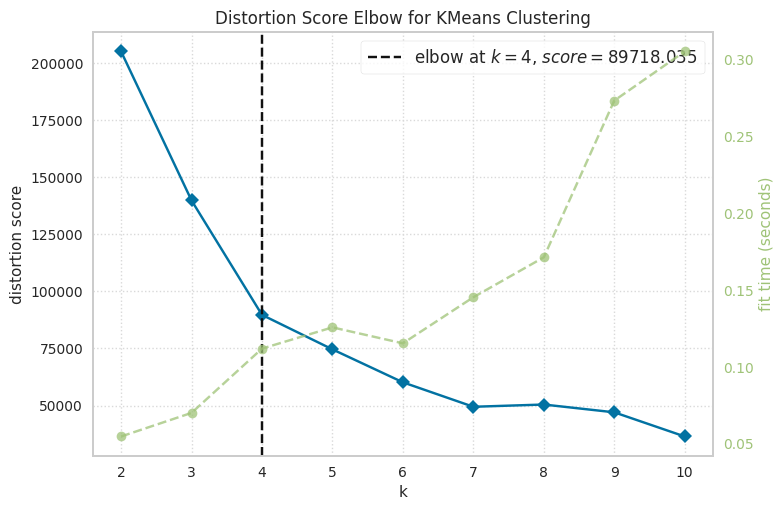

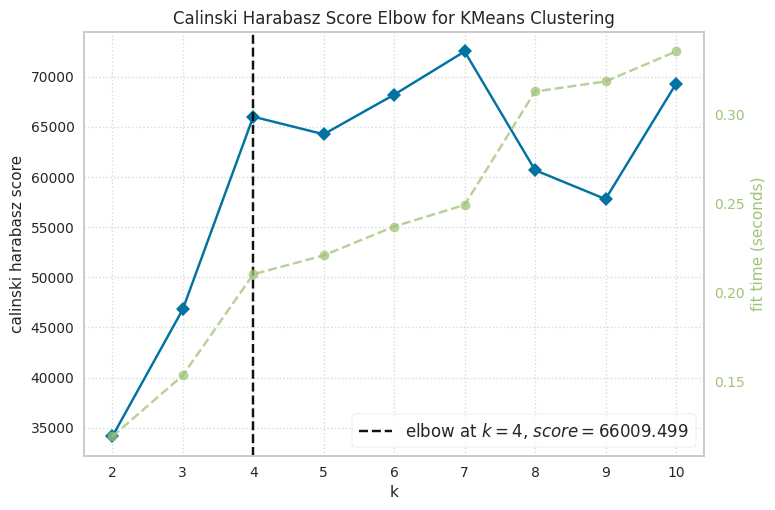

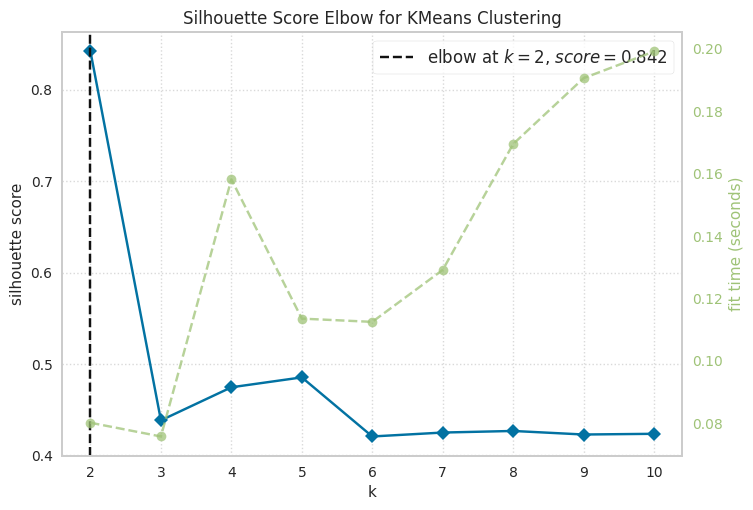

In [ ]:
for i in ['distortion', 'calinski_harabasz', 'silhouette']:  # 'silhouette' (very long)
    # Instantiating the clustering model and viewer
    model = cluster.KMeans(
        init='k-means++',
        n_init='auto',
        algorithm='lloyd',
        max_iter=300,
        tol=1e-4,
        random_state=42
    )
    visualizer = KElbowVisualizer(model, k=(2, 11), metric=i)

    visualizer.fit(X_model)
    visualizer.poof();

The optimal number of clusters seems to be : **5 clusters**<br>
Bear in mind that the choice of the number of clusters is also based on the business context: the number of clusters and the distribution of individuals within them must enable the implementation of the actions planned after clustering (interpretation of the different groups and resulting marketing actions).

- Choice of number of clusters :

In [24]:
kmean_cluster_nb = 5

- Model creation and training :

In [25]:
clust_kmeans = cluster.KMeans(
    n_clusters=kmean_cluster_nb,
    init='k-means++',
    n_init='auto',
    algorithm='lloyd',
    max_iter=300,
    tol=1e-4,
    random_state=42
)
t0 = time.time()  # To measure fit duration
clust_kmeans.fit(X_model)
kmeans_fit_time = time.time() - t0
print(f"Fit duration : {kmeans_fit_time:.2f} seconds.")

labels_kmeans = clust_kmeans.labels_

Fit duration : 0.16 seconds.


- Cluster representation on PCA components :

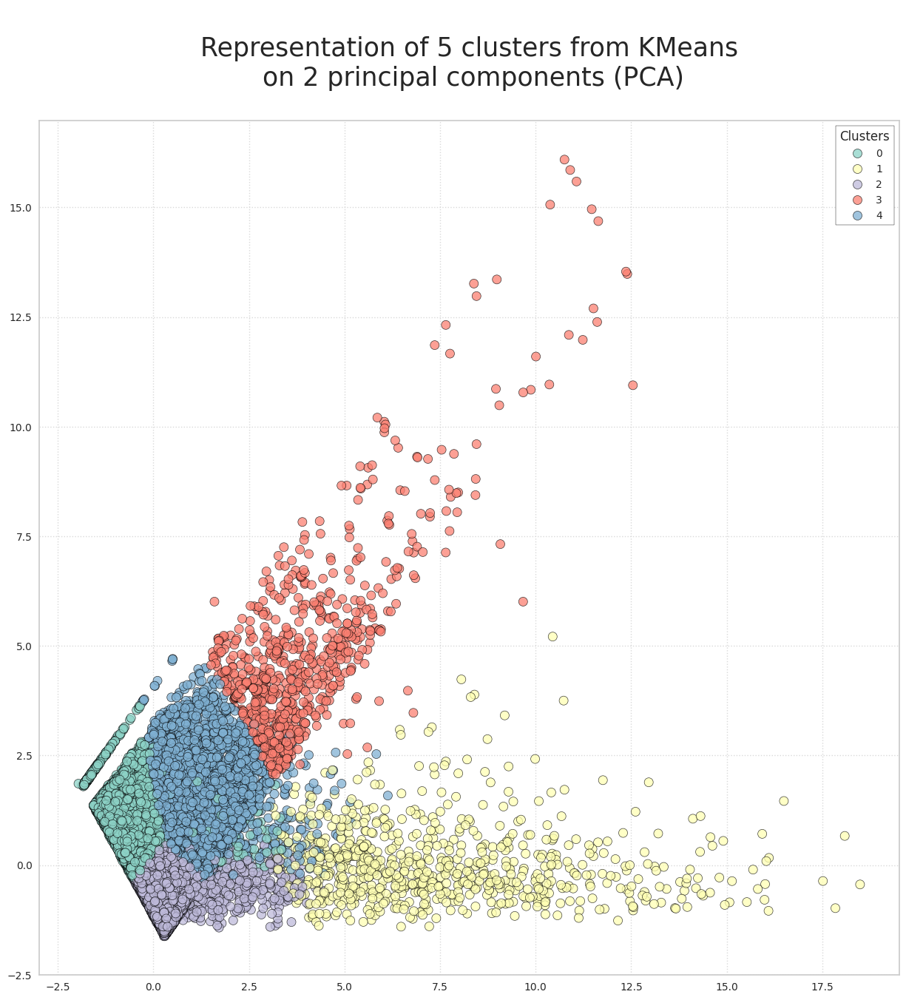

In [ ]:
draw_clusters(X_PCA, method="pca", model='KMeans', labels=labels_kmeans, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

In [ ]:
draw_clusters(X_tSNE, method="tsne", model='KMeans', labels=labels_kmeans, alpha=0.75, display_legend=True)

Output hidden; open in https://colab.research.google.com to view.

- Cluster distribution :

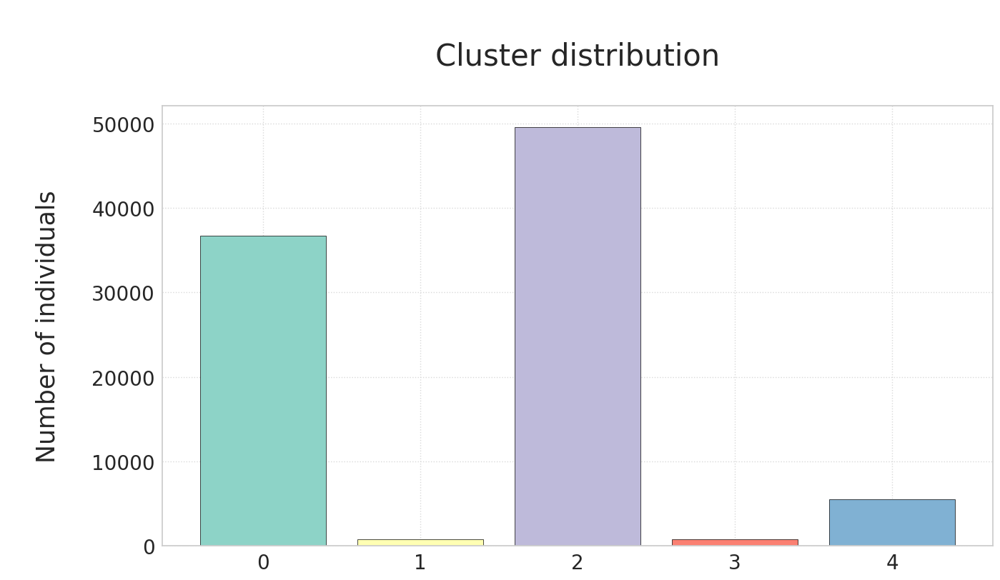

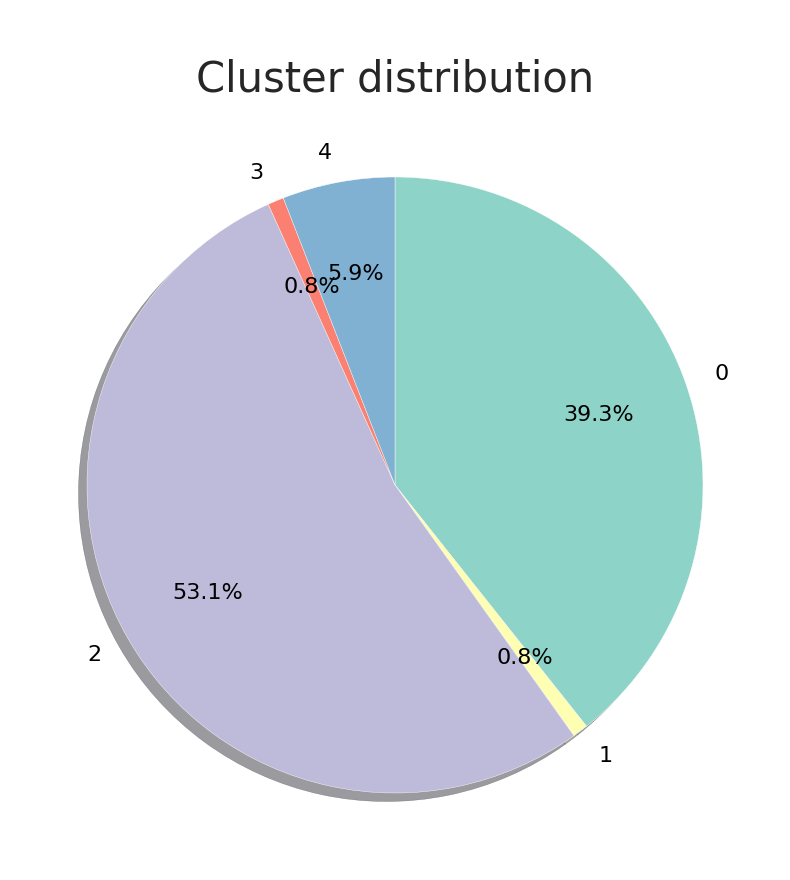

In [ ]:
cluster_proportion(labels=labels_kmeans)

- Calculating scores :

In [38]:
kmeans_silhouette = silhouette_score(X_model, labels_kmeans)
print(f"Silhouette score : {kmeans_silhouette:0.3f}")
kmeans_bouldin = davies_bouldin_score(X_model, labels_kmeans)
print(f"Davies Bouldin score : {kmeans_bouldin:0.3f}")
kmeans_calinski = calinski_harabasz_score(X_model, labels_kmeans)
print(f"Calinski Harabasz score : {kmeans_calinski:0.3f}")
# Only for KMEANS
print(f"Distortion score : {clust_kmeans.inertia_:0.3f}")

Silhouette score : 0.485
Davies Bouldin score : 0.702
Calinski Harabasz score : 64256.789
Distortion score : 74610.028


- Silhouette visualization :

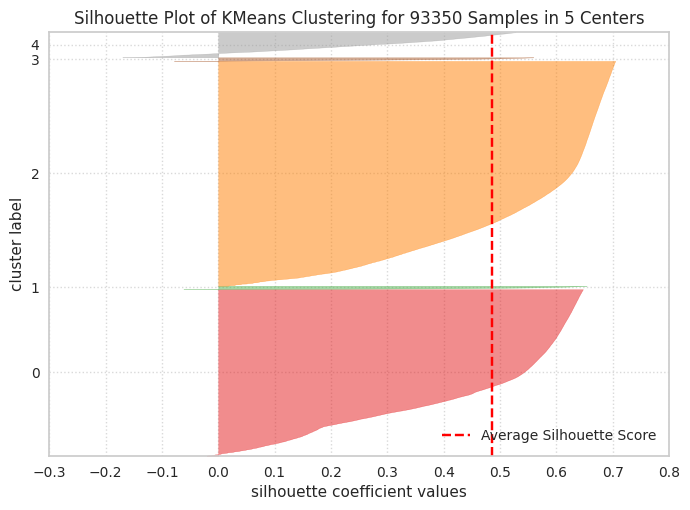

In [ ]:
# This is a long operation, factulative
SilhouetteVis = True

if SilhouetteVis == True:
    model = cluster.KMeans(
        n_clusters=kmean_cluster_nb,
        init='k-means++',
        n_init='auto',
        algorithm='lloyd',
        max_iter=300,
        tol=1e-4,
        random_state=42
    )
    visualizer = SilhouetteVisualizer(model)

    visualizer.fit(X_model)
    visualizer.poof();

- Intercluster distance measurement :\
This method can relies on cluster centroïds distances. So it can only be used on algorithms based on Kmeans



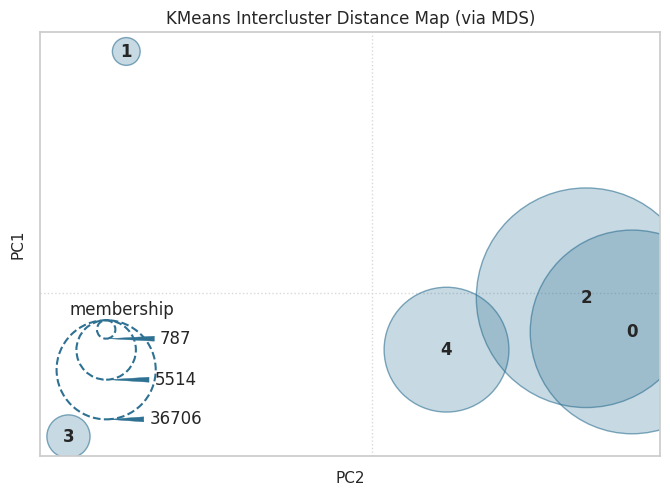

In [ ]:
model = cluster.KMeans(
    n_clusters=kmean_cluster_nb,
    init='k-means++',
    n_init='auto',
    algorithm='lloyd',
    max_iter=300,
    tol=1e-4,
    random_state=42
)
visualizer = InterclusterDistance(model)

visualizer.fit(X_model)
visualizer.show();

**There's a lot of overlap between clusters 0 and 2. Even overlap between cluster 4, 0 and 2 is undesirable.**

#### **2. DBSCAN**

- Choosing the data to be passed to the model :

In [26]:
X_model = X_scaled.values

- Model creation and training :

In [27]:
clust_DBSCAN = cluster.DBSCAN(eps=0.3, min_samples=7)
t0 = time.time()  # To measure fit duration
clust_DBSCAN.fit(X_model)
dbscan_fit_time = time.time() - t0
print(f"Fit duration : {dbscan_fit_time:.2f} seconds.")
print("Labels :", np.unique(clust_DBSCAN.labels_), "(-1 represents the noise).")

labels_dbscan = clust_DBSCAN.labels_

Fit duration : 42.44 seconds.
Labels : [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22
 23] (-1 represents the noise).


- Cluster representation on PCA components :

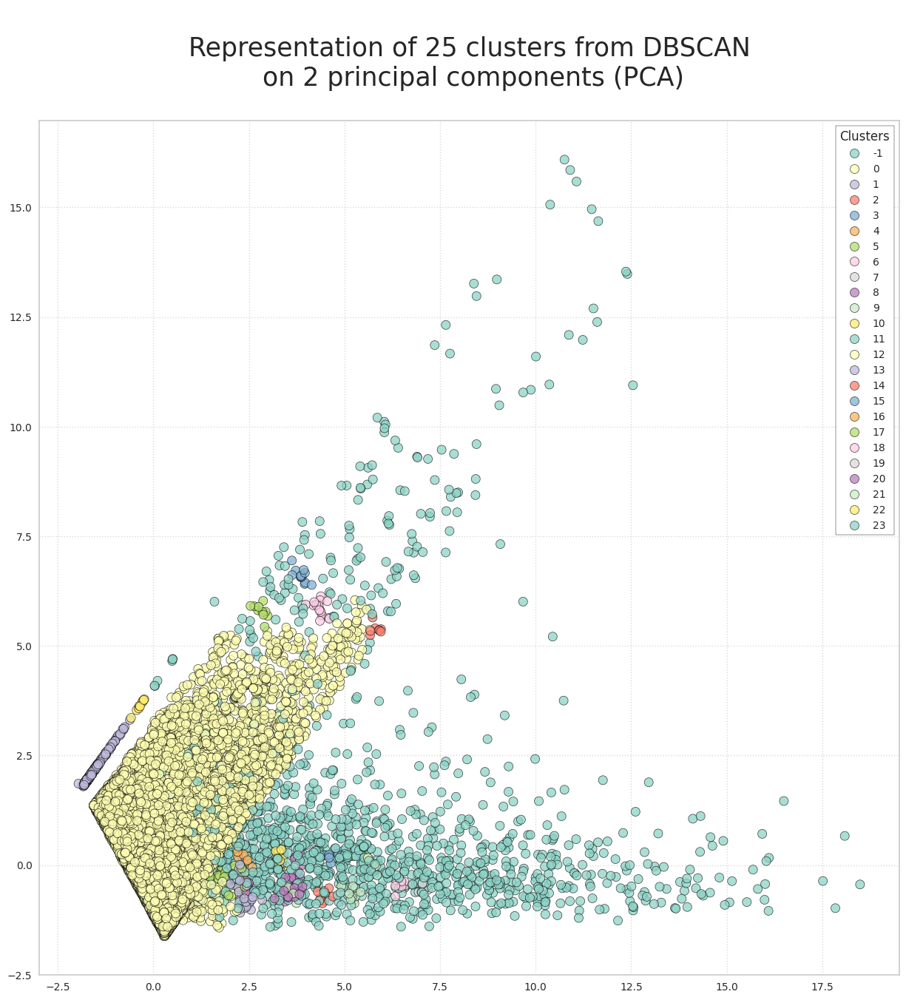

In [ ]:
draw_clusters(X_PCA, method="pca", model='DBSCAN', labels=labels_dbscan, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

In [ ]:
draw_clusters(X_tSNE, method="tsne", model='DBSCAN', labels=labels_dbscan, alpha=0.75, display_legend=True)

Output hidden; open in https://colab.research.google.com to view.

- Cluster distribution :

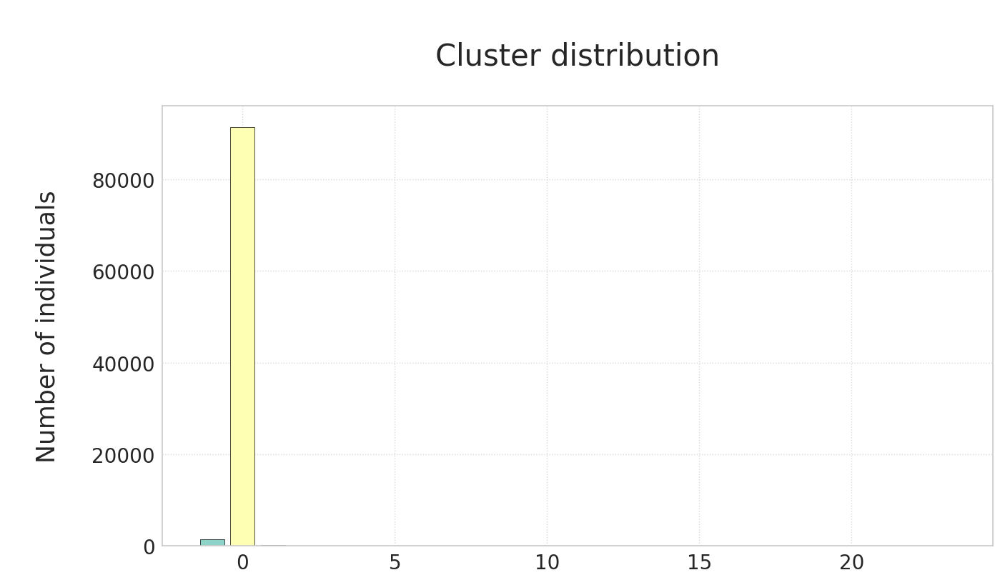

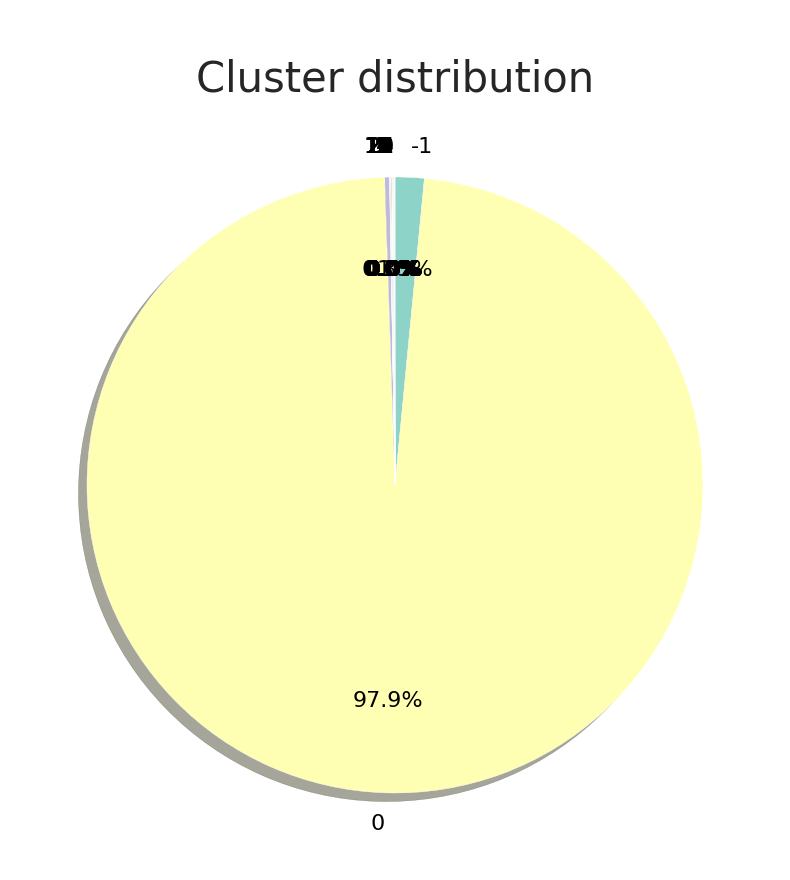

In [ ]:
cluster_proportion(labels=labels_dbscan)

**The clusters obtained are not at all satisfactory given the business context.**

- Calculating scores :

In [39]:
# If more than one cluster found
if len(np.unique(labels_dbscan)) > 1:
    dbscan_silhouette = silhouette_score(X_model, labels_dbscan)
    print(f"Silhouette score : {dbscan_silhouette:0.3f}")
    dbscan_bouldin = davies_bouldin_score(X_model, labels_dbscan)
    print(f"Davies Bouldin score : {dbscan_bouldin:0.3f}")
    dbscan_calinski = calinski_harabasz_score(X_model, labels_dbscan)
    print(f"Calinski Harabasz score : {dbscan_calinski:0.3f}")
# Otherwise scores cannot be calculated
else:
    print("Not enough clusters to calculate scores.")

Silhouette score : 0.308
Davies Bouldin score : 1.516
Calinski Harabasz score : 1250.382


#### **3. Birch**

**For this model, the initial choice of features produced very poor results. After various trials, it turned out that the best results were obtained with the following procedure:**

- Greater number of features used.
- Reduction of data dimensions by PCA.
- Passing data through the model.

- Data scaling and encoding :

In [28]:
X_birch = scale_and_encode(features=features_list, data=data)

Standard-scaled numeric features: ['recency', 'frequency', 'total_spent']
One hot encoded categorical features: []


In [29]:
X_model = X_scaled

- t-SNE to represent our data (with selected features) in two dimensions :

In [30]:
# File name used for saving/loading data
# nom_fichier = 'X_tSNE_birch'

# tSNE_birch = tSNE_maker(nom_fichier, data=X_model)

In [31]:
# Nom de fichier utilisé pour la sauvegarde / chargement des données
tSNE_birch = tSNE_maker(filename, data=X_birch)

The file X_tSNE_3_parameters.xlsx already exists, if you wish to export a new version, delete the old one..
Importing data from X_tSNE_3_parameters.xlsx...
Imported data.


- For this model, we will reduce the dimensions of the data by PCA, to improve performance:

In [32]:
# reduce_dimension = False
# if reduce_dimension:
#   X_PCA_birch = PCA_maker(ncomponents=2, data=X_model)
#   # Selection of data to be passed to the model
#   X_model = X_PCA_birch

- Choice of the number of clusters with which the best results are obtained, based on scores and business context:

In [33]:
birch_cluster_nb = 5

- Model creation and training :

In [34]:
clust_Birch = cluster.Birch(n_clusters=birch_cluster_nb)
t0 = time.time()  # To measure fit duration
clust_Birch.fit(X_model)
birch_fit_time = time.time() - t0
print(f"Fit duration : {birch_fit_time:.2f} seconds.")

labels_birch = clust_Birch.labels_

Fit duration : 2.34 seconds.


- Cluster representation on PCA components :

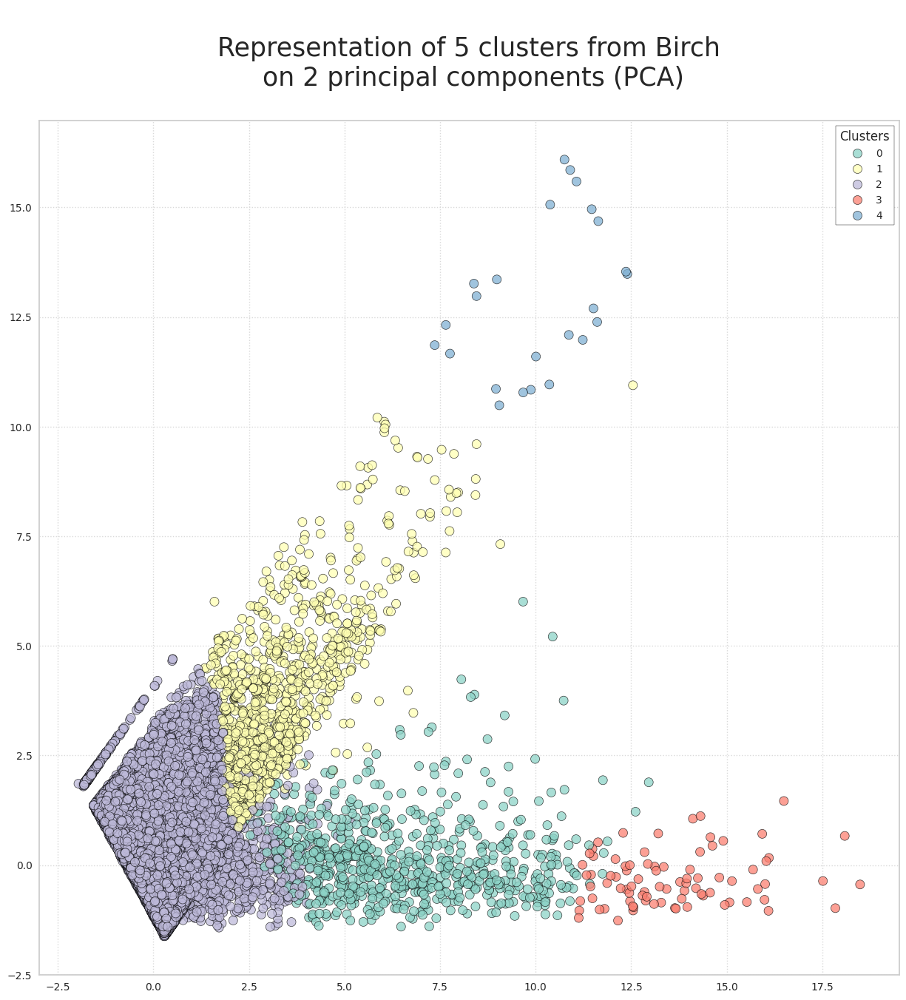

In [ ]:
draw_clusters(X_PCA, method="pca", model='Birch', labels=labels_birch, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

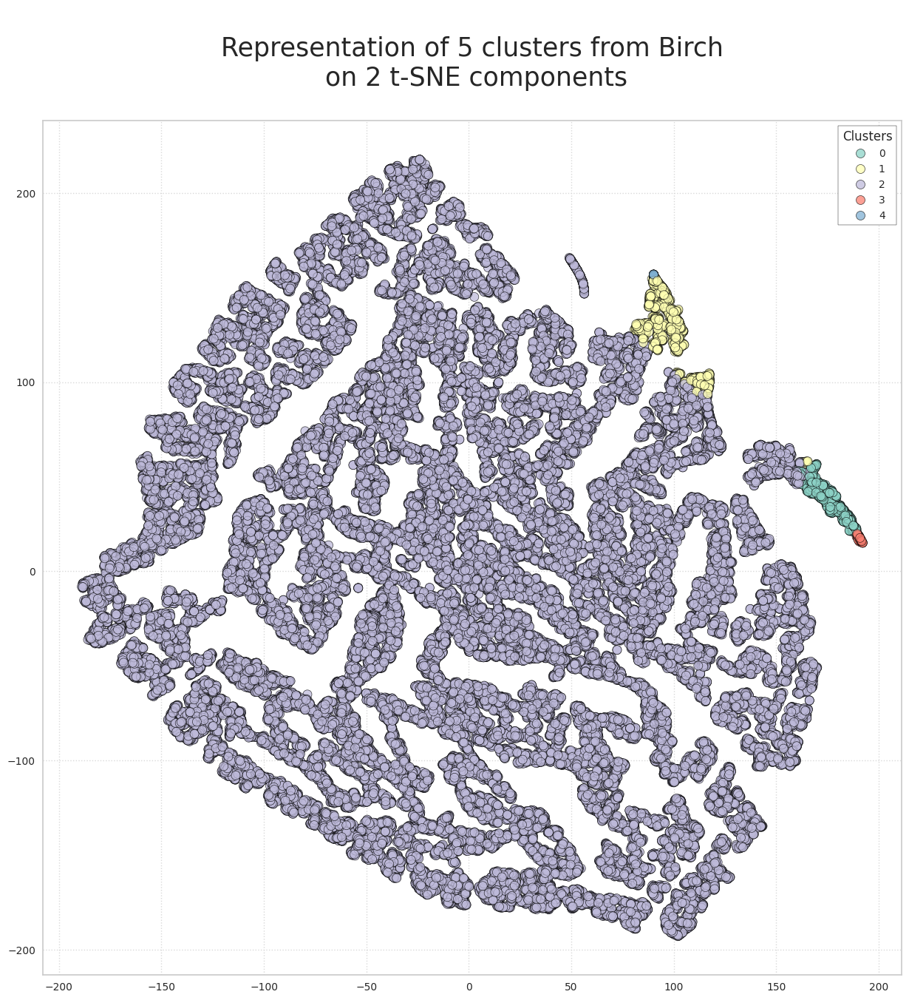

In [ ]:
draw_clusters(X_tSNE, method="tsne", model='Birch', labels=labels_birch, alpha=0.75, display_legend=True)

- Cluster distribution :

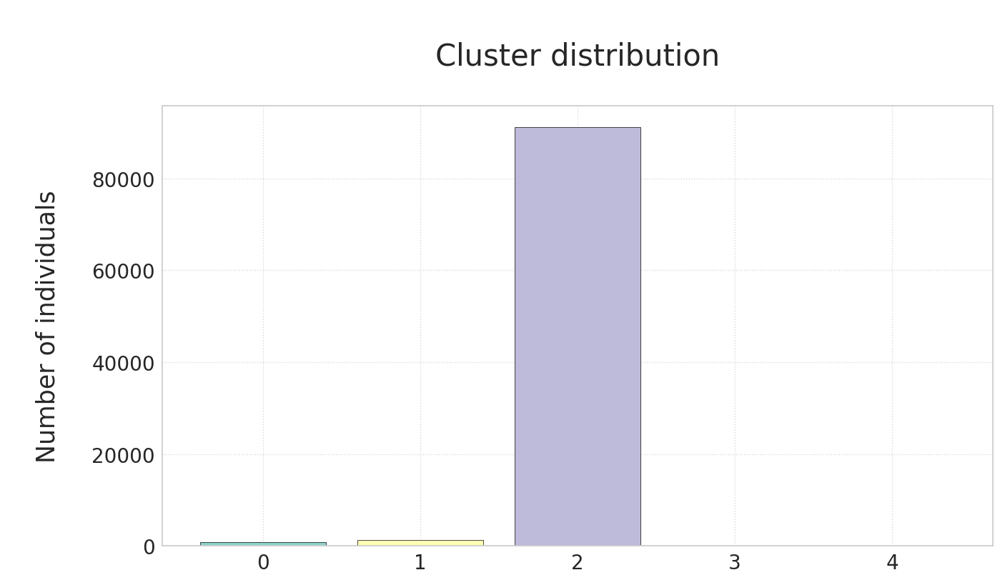

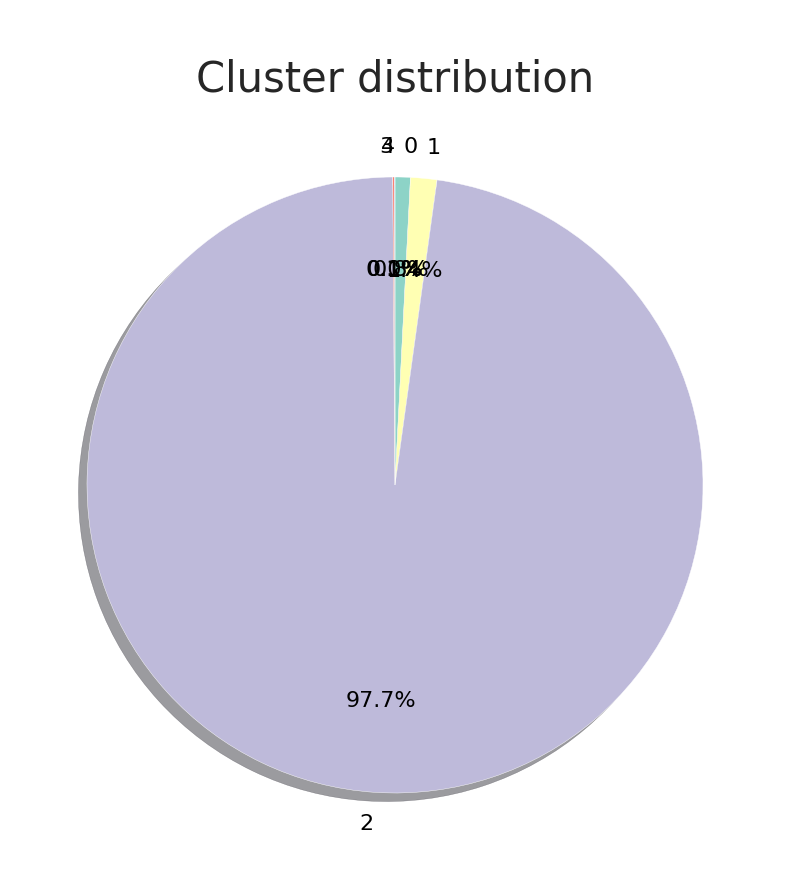

In [ ]:
cluster_proportion(labels=labels_birch)

- Calculating scores :

In [40]:
birch_silhouette = silhouette_score(X_birch, labels_birch)
print(f"Silhouette score : {birch_silhouette:0.3f}")
birch_bouldin = davies_bouldin_score(X_birch, labels_birch)
print(f"Davies Bouldin score : {birch_bouldin:0.3f}")
birch_calinski = calinski_harabasz_score(X_birch, labels_birch)
print(f"Calinski Harabasz score : {birch_calinski:0.3f}")

Silhouette score : 0.747
Davies Bouldin score : 0.487
Calinski Harabasz score : 21310.430


#### **4. BisectingKMeans**

- Choosing the data to be passed to the model :

In [35]:
X_model = X_scaled

- Finding the optimal number of clusters for BisectingKMeans :

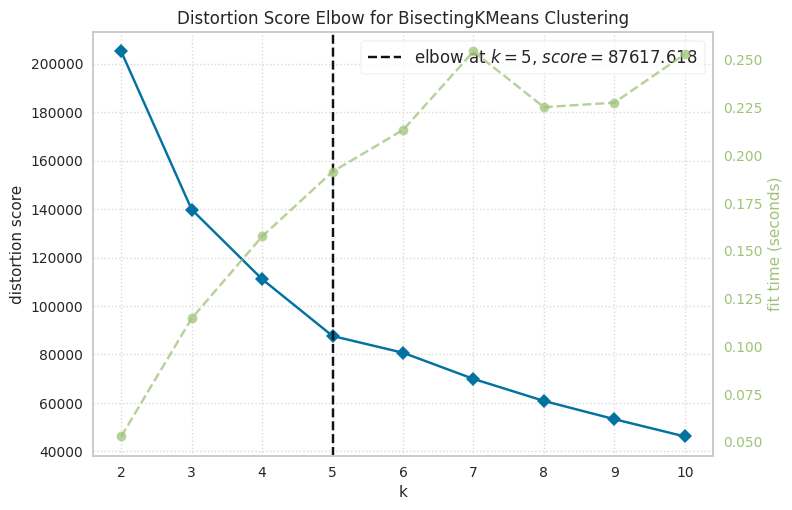

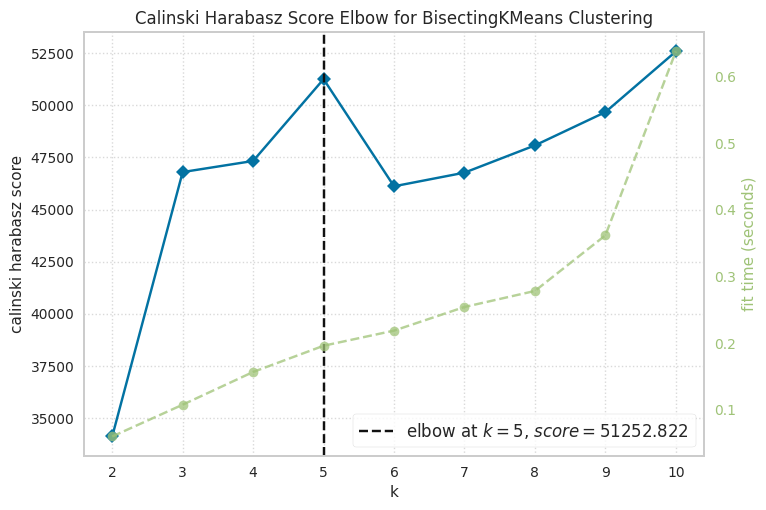

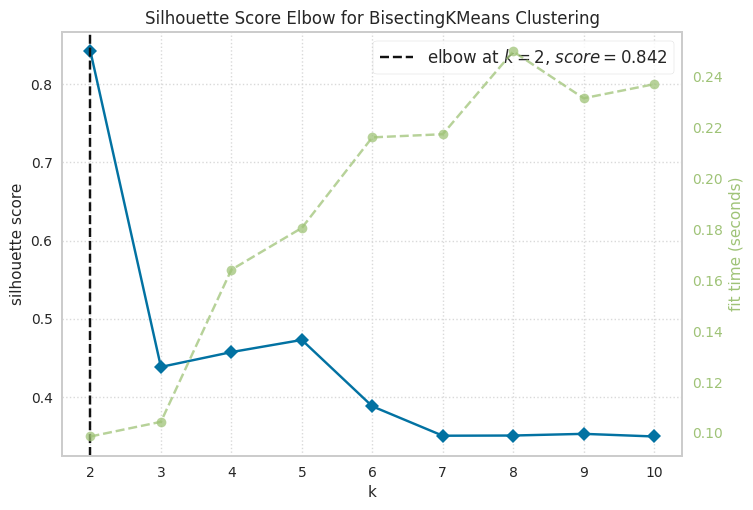

In [ ]:
for i in ['distortion', 'calinski_harabasz', 'silhouette']:  # 'silhouette' (very long)
# for i in ['distortion', 'calinski_harabasz']:  # 'silhouette' (very long)
    # Instantiating the clustering model and viewer
    model = cluster.BisectingKMeans(
        init='k-means++',
        random_state=42,
        n_init=1,
        bisecting_strategy='biggest_inertia'
    )
    visualizer = KElbowVisualizer(model, k=(2, 11), metric=i)

    visualizer.fit(X_model)
    visualizer.poof();

It was decided to base the ideal number of clusters on the silhouette score and the business context : **5 clusters**<br>
Bear in mind that the choice of the number of clusters is also based on the business context: the number of clusters and the distribution of individuals within them must enable the implementation of the actions planned after clustering (interpretation of the different groups and resulting marketing actions).

- Choice of number of clusters :

In [36]:
biskmean_cluster_nb = 5

- Model creation and training :

In [37]:
clust_bis = cluster.BisectingKMeans(
    n_clusters=biskmean_cluster_nb,
    init='k-means++',
    random_state=42,
    n_init=1,
    bisecting_strategy='biggest_inertia'
)
t0 = time.time()  # To measure fit duration
clust_bis.fit(X_model)
bis_fit_time = time.time() - t0
print(f"Fit duration : {bis_fit_time:.2f} secondes.")

labels_bis = clust_bis.labels_

Fit duration : 0.23 secondes.


- Cluster representation on PCA components :

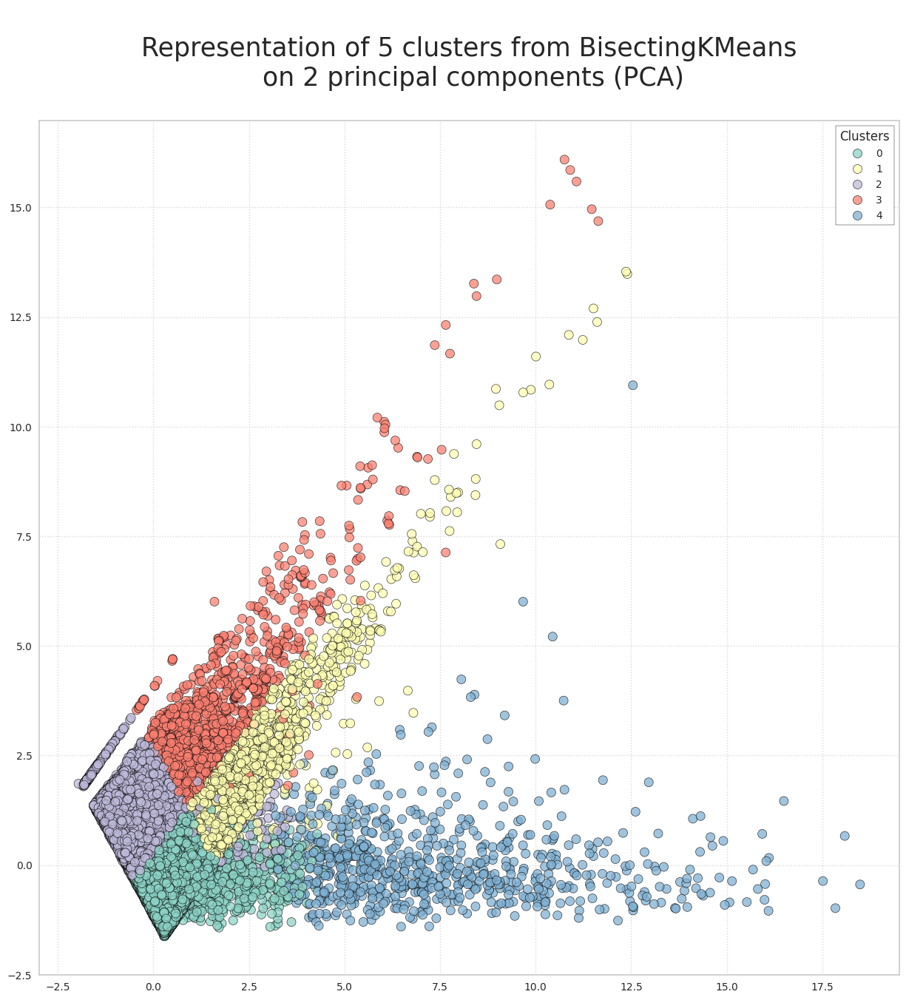

In [ ]:
draw_clusters(X_PCA, method="pca", model='BisectingKMeans', labels=labels_bis, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

In [ ]:
draw_clusters(X_tSNE, method="tsne", model='BisectingKMeans', labels=labels_bis, alpha=0.75, display_legend=True)

Output hidden; open in https://colab.research.google.com to view.

- Cluster distribution :

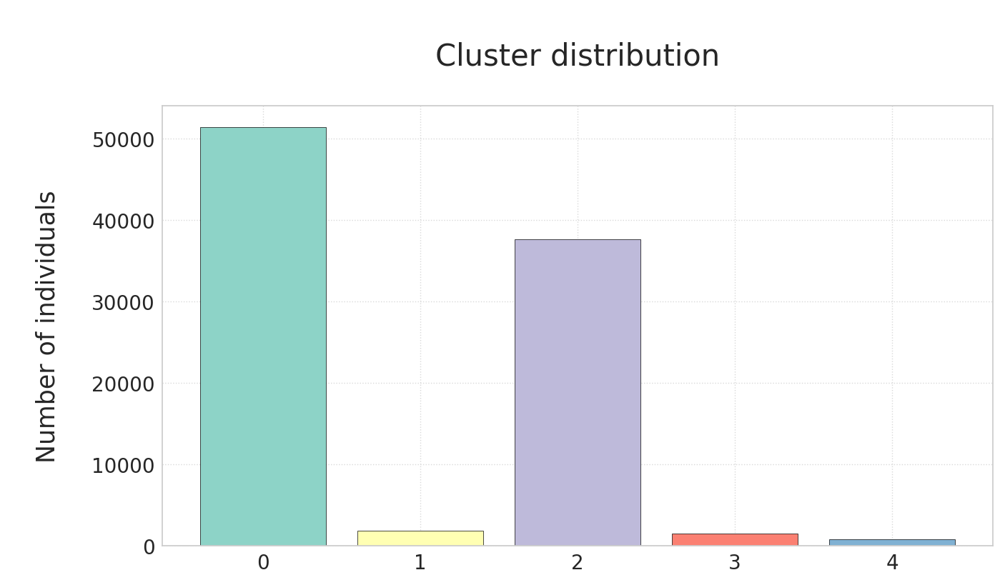

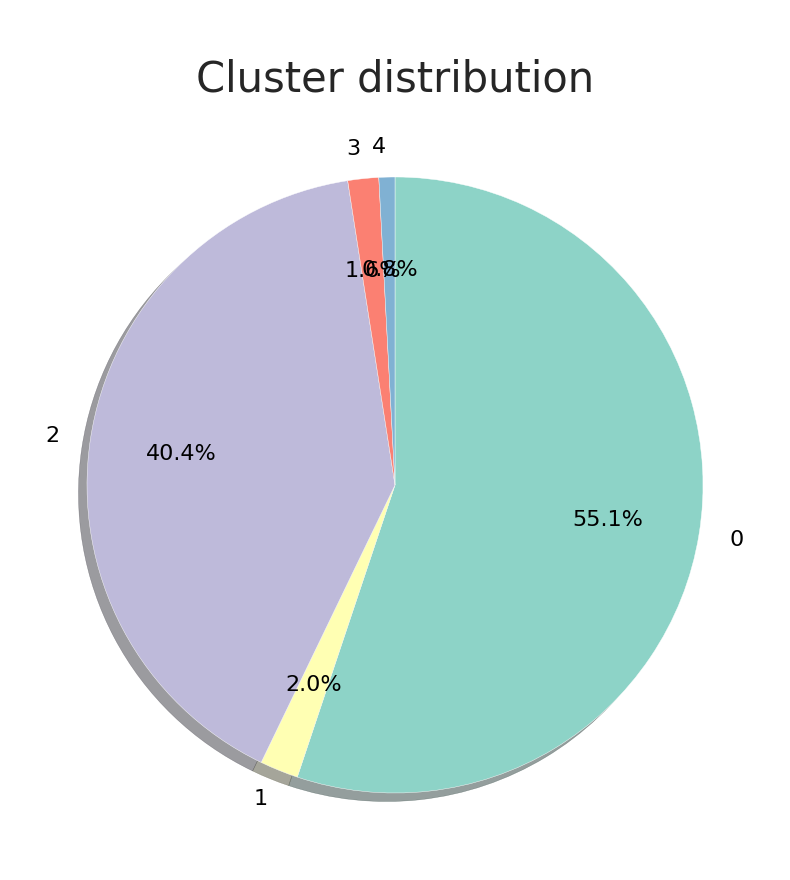

In [ ]:
cluster_proportion(labels=labels_bis)

- Calculating scores :

In [41]:
bis_silhouette = silhouette_score(X_model, labels_bis)
print(f"Silhouette score : {bis_silhouette:0.3f}")
bis_bouldin = davies_bouldin_score(X_model, labels_bis)
print(f"Davies Bouldin score : {bis_bouldin:0.3f}")
bis_calinski = calinski_harabasz_score(X_model, labels_bis)
print(f"Calinski Harabasz score : {bis_calinski:0.3f}")
print(f"Distortion score : {clust_bis.inertia_:0.3f}")

Silhouette score : 0.473
Davies Bouldin score : 1.276
Calinski Harabasz score : 51252.822
Distortion score : 87617.963


- Silhouette visualization :

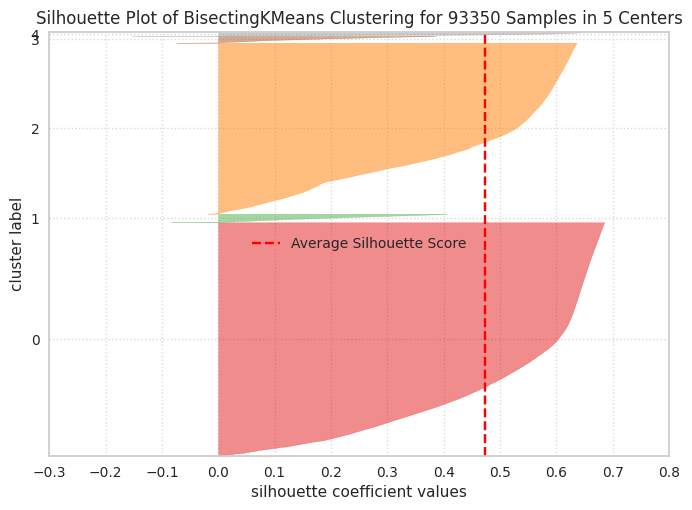

In [ ]:
# This is a long operation, I set the parameters if I want to do it or not
SilhouetteVis = True

if SilhouetteVis == True:
    model = cluster.BisectingKMeans(
        n_clusters=biskmean_cluster_nb,
        init='k-means++',
        random_state=42,
        n_init=1,
        bisecting_strategy='biggest_inertia'
    )
    visualizer = SilhouetteVisualizer(model)

    visualizer.fit(X_model)
    visualizer.poof();

- Intercluster distance measurement :\
This method can relies on cluster centroïds distances. So it can only be used on algorithms based on Kmeans



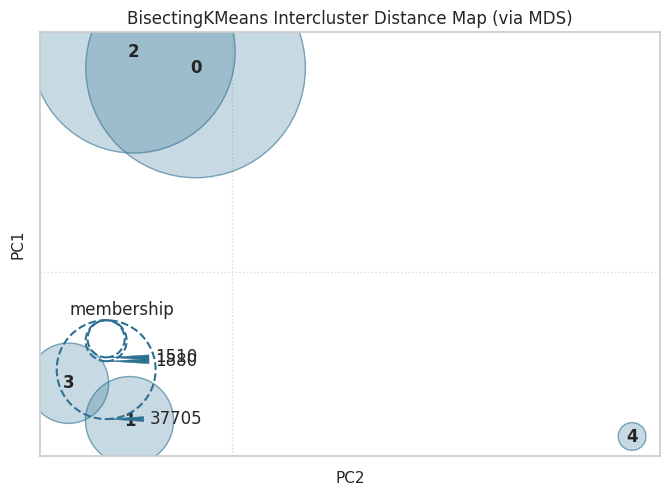

In [ ]:
model = cluster.BisectingKMeans(n_clusters=biskmean_cluster_nb, init='k-means++', random_state=42, n_init=1, bisecting_strategy='biggest_inertia')
visualizer = InterclusterDistance(model)

visualizer.fit(X_model)
visualizer.show();

Clusters don't overlap too much. At least, not as much as with KMEANS.

### **<span style="color: #8181FF">Results for models tested</span>**

,Model,Number of clusters,Fit duration,Silhouette score,Davies Bouldin score,Calinski Harabasz score
0,KMeans,5,0.159433,0.485300,0.701625,64256.788592
1,DBSCAN,25,42.443354,0.307820,1.516279,1250.382417
2,Birch,5,2.336881,0.747196,0.487401,21310.430338
3,BisectingKMeans,5,0.229735,0.472995,1.275943,51252.822142


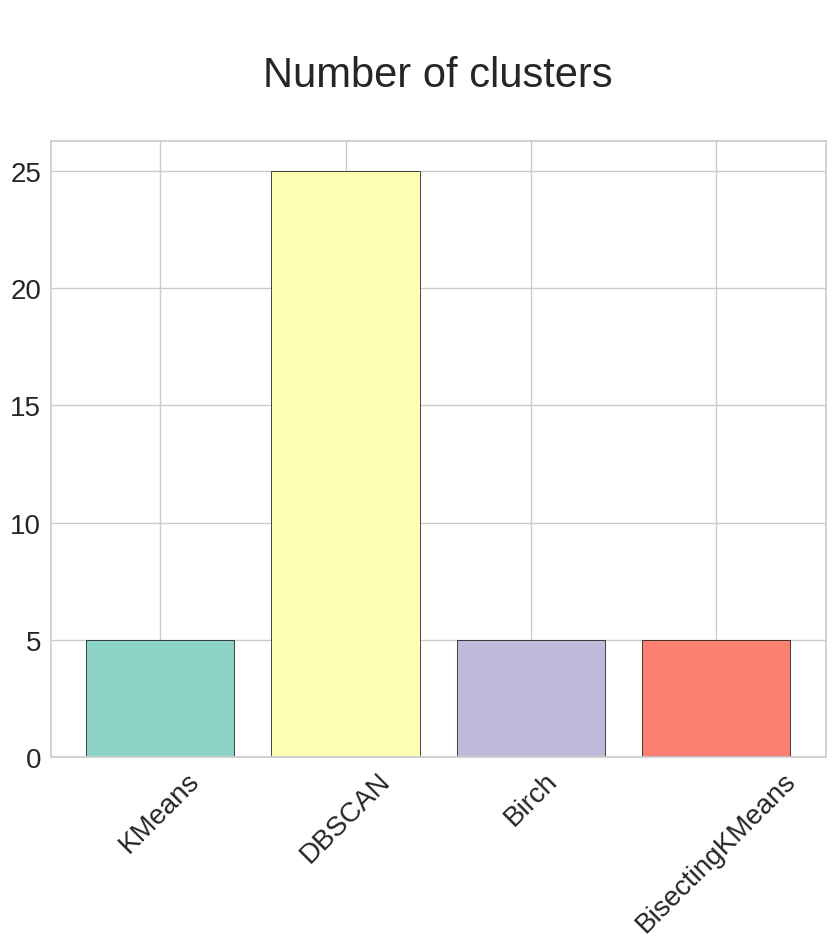

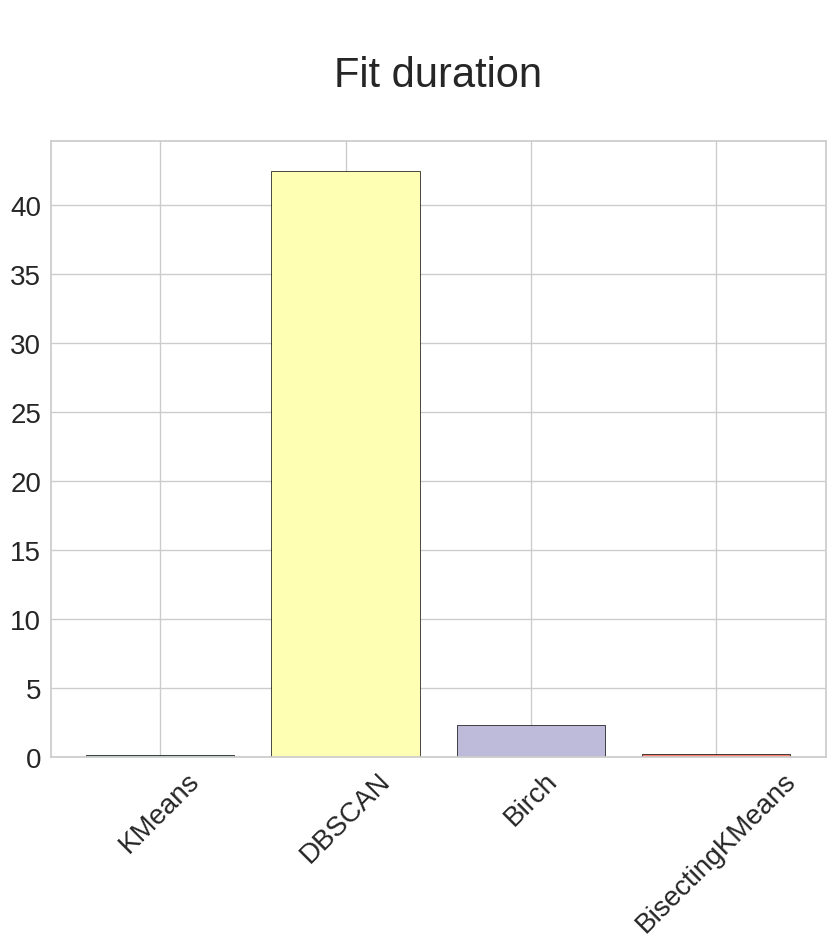

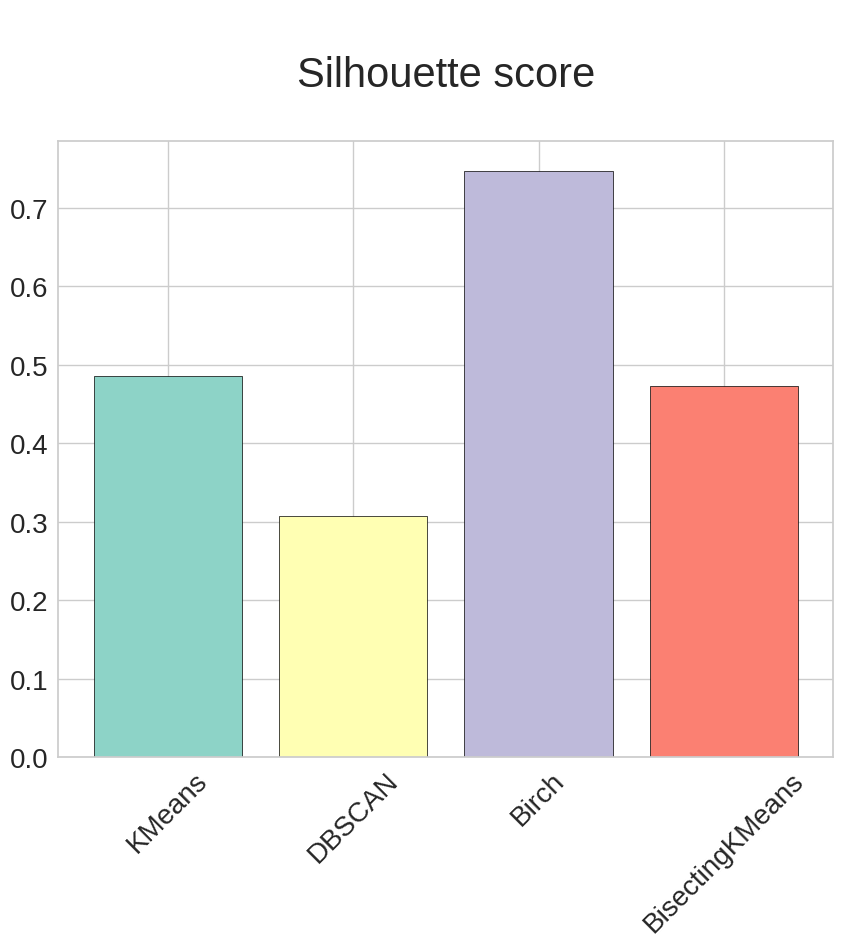

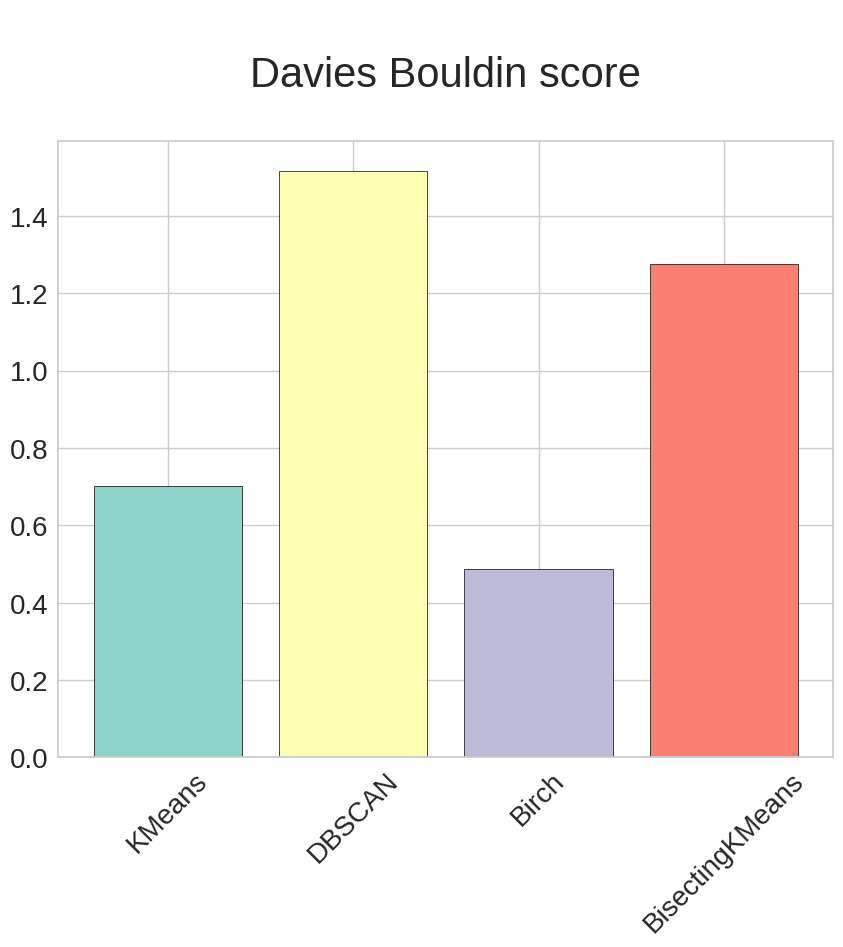

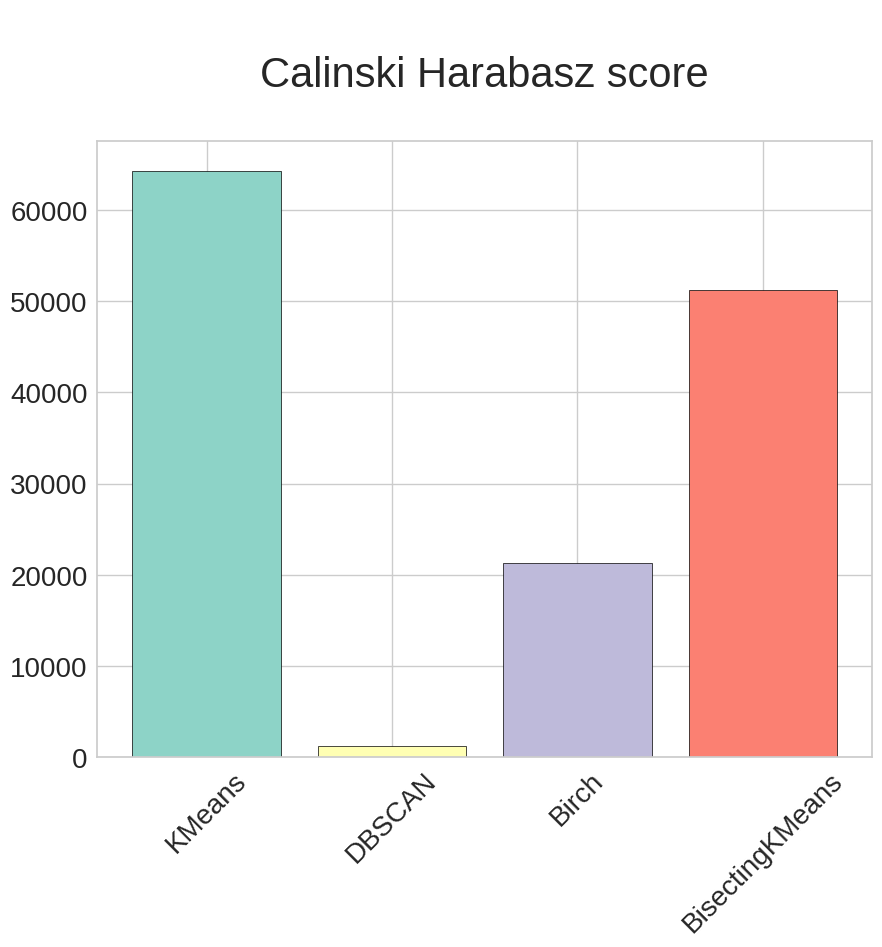

In [42]:
# Retrieve all metrics and create a dataframe
comparo = {
    "Model": [
        "KMeans",
        "DBSCAN",
        "Birch",
        "BisectingKMeans"
    ],
    "Number of clusters": [
        kmean_cluster_nb,
        len(np.unique(labels_dbscan)),
        birch_cluster_nb,
        biskmean_cluster_nb
    ],
    "Fit duration": [
        kmeans_fit_time,
        dbscan_fit_time,
        birch_fit_time,
        bis_fit_time
    ],
    "Silhouette score": [
        kmeans_silhouette,
        dbscan_silhouette,
        birch_silhouette,
        bis_silhouette
    ],
    "Davies Bouldin score": [
        kmeans_bouldin,
        dbscan_bouldin,
        birch_bouldin,
        bis_bouldin
    ],
    "Calinski Harabasz score": [
        kmeans_calinski,
        dbscan_calinski,
        birch_calinski,
        bis_calinski
    ]
}
comparo_df = pd.DataFrame(data=comparo)

# Dataframe display
display(comparo_df)

# Comparison of different metrics with barplots
for i in ['Number of clusters', 'Fit duration', 'Silhouette score', 'Davies Bouldin score', 'Calinski Harabasz score']:
    plt.figure(figsize=(10, 8))
    plt.bar(
        comparo_df['Model'],
        comparo_df[i],
        color=sns.color_palette("Set3", 10),
        edgecolor='black',
        linewidth=0.5,
        width=0.8,
    )
    plt.title(f"\n{i}\n", fontsize=30)
    plt.xticks(fontsize=20, rotation=45)
    plt.yticks(fontsize=20)
    plt.show()

- Since Calinsky Harabasz score is less sensible to clusters overlap, then the result is better for both Kmeans and Bisecting Kmeans than birch
- Davies Bouldin score is more sensible to clusters overlap which explains the better score for birch.
- Silhouette is particularly overlap sensible. It is also more sensible than CH to separation between clusters.

However, birch clustering is problematic since it aggreages almost 98% of the dataset.

### **Choice of final model**

- DBSCAN does not work with a too low amount of parameters
- Birch brings better results with 6 clusters. Its fit duration is faster.
- Kmeans has quite good results. Its fit duration is very fast. However, cluster overlap.
- BisectingKMeans has also good equivalent scores to Kmeans on performance metrics and fit duration. Clusters overlap less than with Kmeans.

Next, we have to check stability.

- Initialization stability :

We'll run several iterations of the model, without fixing the random state, and compare the clusters obtained with the results when the random state is fixed. To compare labels, I'll use the Adjusted Rand Score (ARI).

In [ ]:
print("ARI scores between clusters obtained with and without random state :\n-------------------")

for i in range(10):

    # I use an identical model, but without setting the random state
    clust_random = cluster.KMeans(
        init='k-means++',
        n_init='auto',
        algorithm='lloyd',
        max_iter=300,
        tol=1e-4,
    )
    clust_random.fit(X_model)

    labels_kmeans_random = clust_random.labels_

    # I compare and display the clusters obtained with the labels obtained previously (labels_kmeans)
    print(f"Iteration {i+1} : {adjusted_rand_score(labels_kmeans, labels_kmeans_random):0.3f}")

ARI scores between clusters obtained with and without random state :
-------------------
Iteration 1 : 0.413
Iteration 2 : 0.468
Iteration 3 : 0.409
Iteration 4 : 0.406
Iteration 5 : 0.494
Iteration 6 : 0.409
Iteration 7 : 0.494
Iteration 8 : 0.406
Iteration 9 : 0.467
Iteration 10 : 0.407


ARI scores are not very high so stability is compromised. Maybe try another clustering process like BisectingKMeans.

In [ ]:
print("ARI scores between random state and non-random state clusters :\n-------------------")

for i in range(10):

    # I use an identical model, but without setting the random state
    clust_bis_random = cluster.BisectingKMeans(
        n_clusters=biskmean_cluster_nb,
        init='k-means++',
        n_init=1,
        bisecting_strategy='biggest_inertia'
    )
    clust_bis_random.fit(X_model)

    labels_bis_random = clust_bis_random.labels_

    # I compare and display the clusters obtained with the labels obtained previously (labels_bis)
    print(f"Iteration {i+1} : {adjusted_rand_score(labels_bis, labels_bis_random):0.3f}")

ARI scores between random state and non-random state clusters :
-------------------
Iteration 1 : 0.959
Iteration 2 : 0.682
Iteration 3 : 0.998
Iteration 4 : 0.990
Iteration 5 : 0.798
Iteration 6 : 0.800
Iteration 7 : 0.800
Iteration 8 : 0.974
Iteration 9 : 0.999
Iteration 10 : 0.988


ARI scores are still high and stability is good. Despite BisectingKMeans has a slightly lower silhouette score, we will keep it as this model is more stable.

**After comparison, we decided to keep the Bisecting Kmeans model (silhouette score = 0.473 + better stability than KMeans)**

### **<span style="color: #8181FF">Business interpretation of clusters</span>**

- Add labels obtained with the selected model to the original dataset :

In [ ]:
# labels_bis : labels obtained with BisectingKMeans
data['Cluster_BisKMeans'] = labels_bis

- Graphical representations of value distributions according to clusters :

In [ ]:
data['Cluster_BisKMeans']

,Cluster_BisKMeans
0,0
1,0
2,2
3,2
4,2
...,...
93345,3
93346,2
93347,2
93348,0


['customer_unique_id', 'customer_lat', 'customer_lng', 'orders_number', 'first_purchase_date', 'last_purchase_date', 'avg_spent', 'preferred_payment_type', 'avg_payment_sequential', 'avg_customer_seller_distance_km', 'preferred_category']


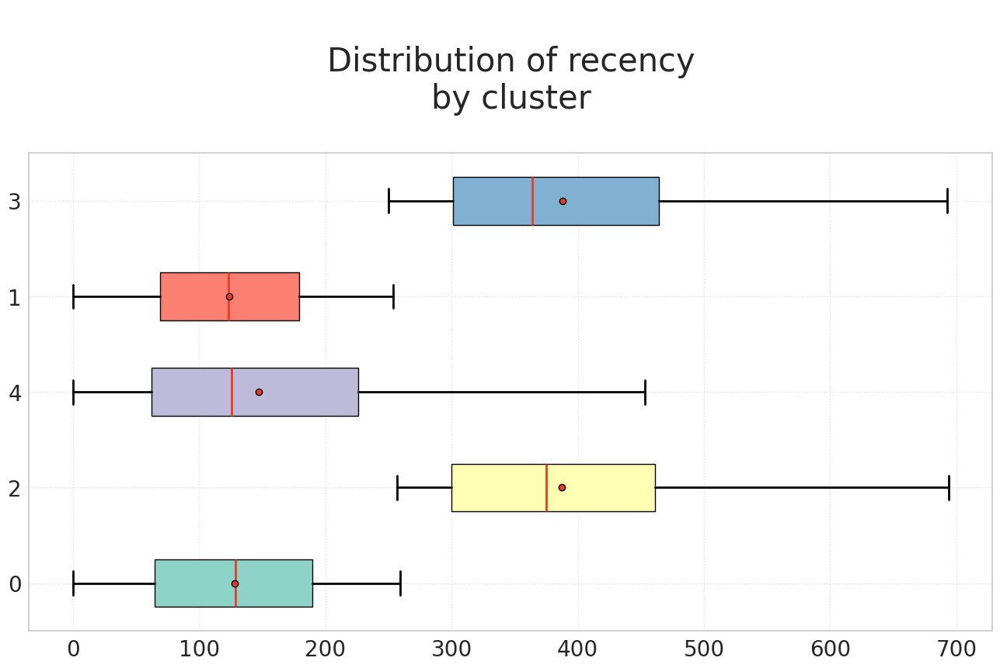

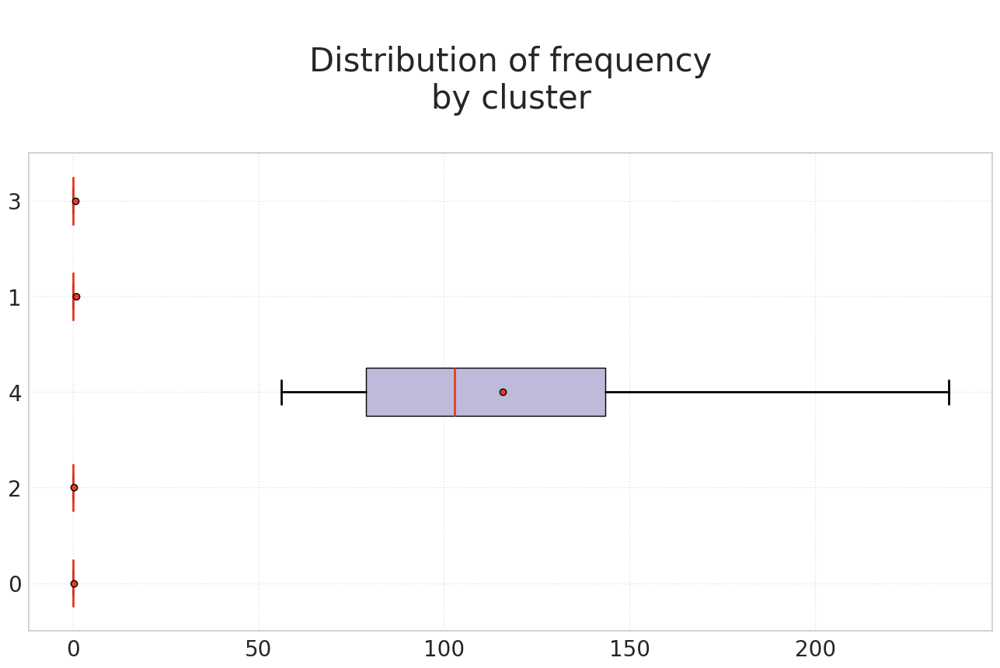

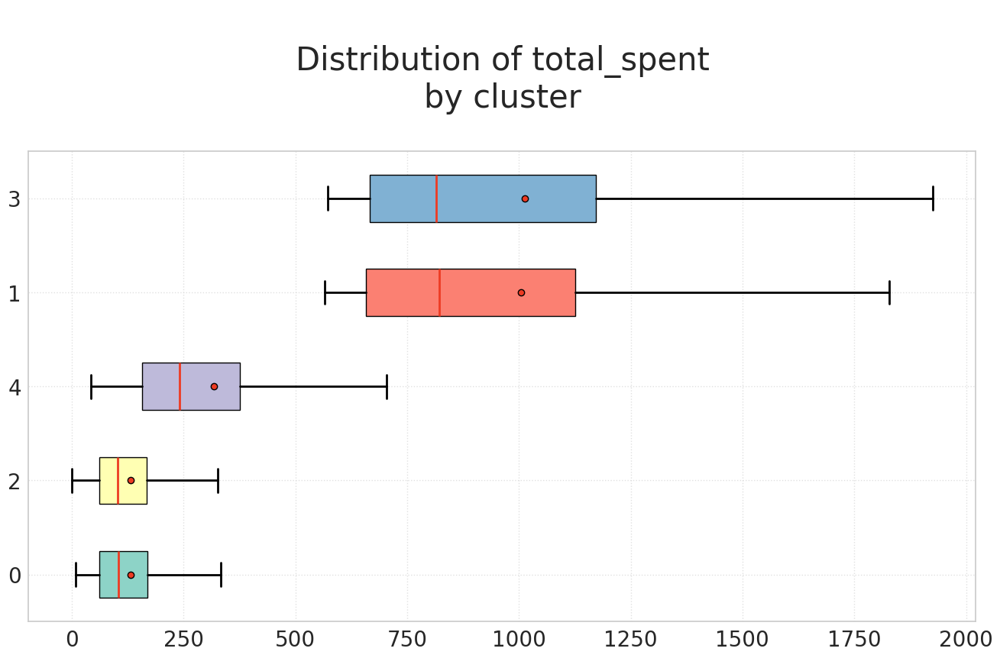

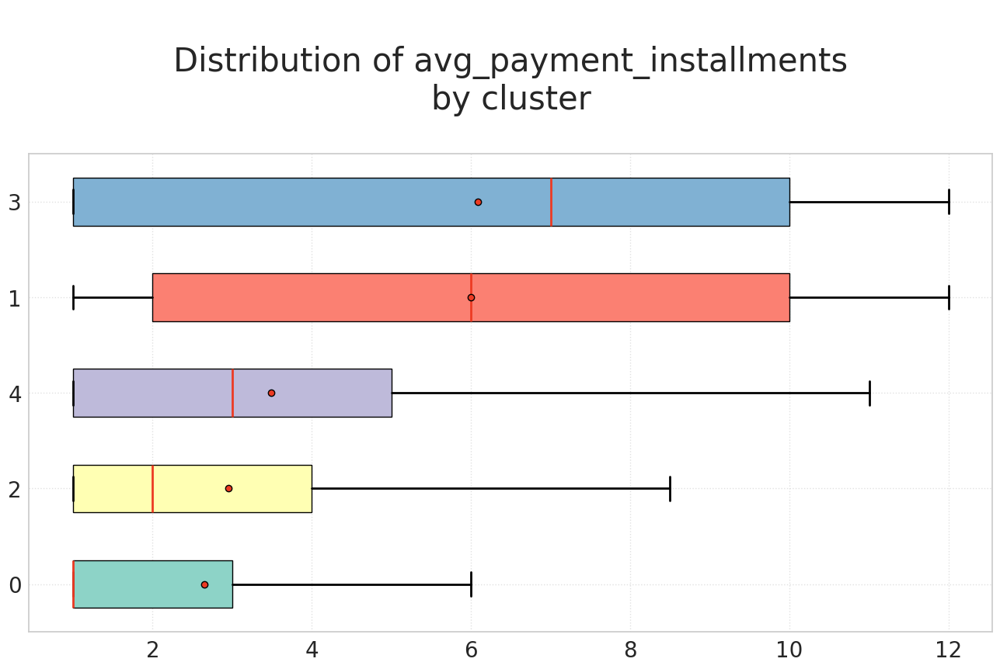

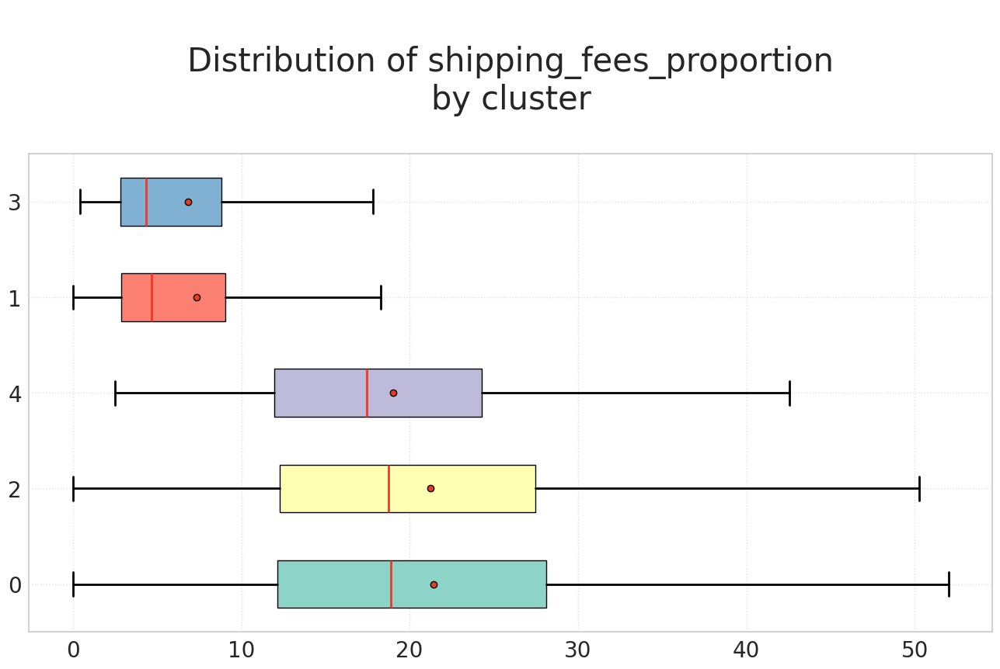

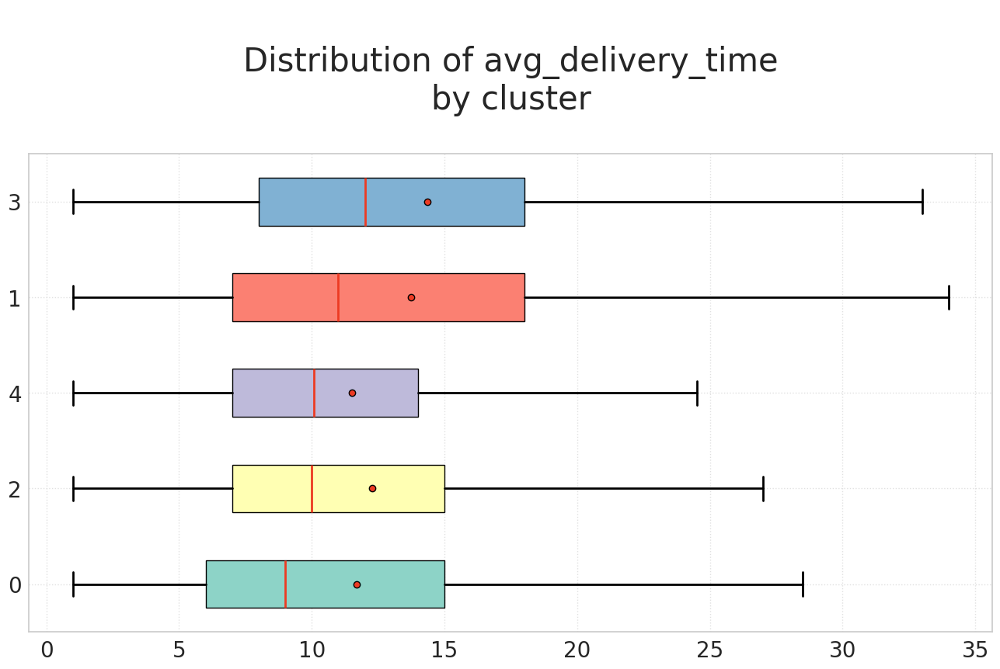

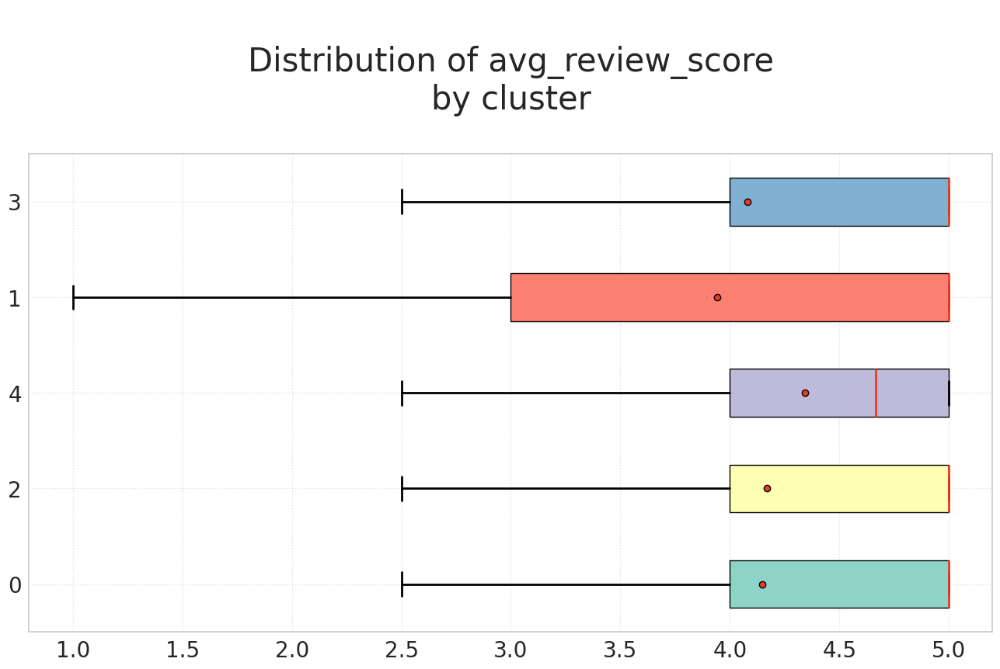

In [ ]:
# I remove variables that are identical for each cluster and those that are redundant or too similar to use as a means of comparison.
a_del = [variable for variable in data.columns if variable not in features_list]
a_del.remove('Cluster_BisKMeans')
a_del.remove('avg_payment_installments')
a_del.remove('shipping_fees_proportion')
a_del.remove('avg_delivery_time')
a_del.remove('avg_review_score')
print(a_del)

data_moustache = data.drop(a_del, axis=1, inplace=False)

# Graphical representation of the distribution of values according to clusters
clusters = list(data_moustache['Cluster_BisKMeans'].unique())

a_compare = list(data_moustache.columns)

a_compare.remove('Cluster_BisKMeans')

for i in a_compare:

    values_list = []
    for j in clusters:
        values_list.append(data_moustache.loc[data_moustache['Cluster_BisKMeans'] == j][i])

    plt.figure(figsize=(16, 8))
    plt.title(f"\nDistribution of {i}\nby cluster\n", fontsize=30)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)

    param_box_plot = {
        'patch_artist': True,
        'boxprops': dict(
            linestyle='-',
            linewidth=1,
            color='black',
            facecolor='#8181FF',
        ),
        'capprops': dict(
            color='black',
            linewidth=2,
        ),
        'flierprops': dict(
            color='#8181FF',
            markeredgecolor=None,
            markerfacecolor='#8181FF',
            markersize=5,
            marker='.',
            alpha=0.1,
        ),
        'medianprops': dict(
            linestyle='-',
            linewidth=2,
            color='#ED3B23',
        ),
        'meanprops': dict(
            marker='o',
            markeredgecolor='black',
            markeredgewidth=1,
            markerfacecolor='#ED3B23',
        ),
        'whiskerprops': dict(
            color='black',
            linewidth=2,
        )
    }

    box = plt.boxplot(
        values_list,
        vert=False,
        tick_labels=clusters,
        showmeans=True,
        showfliers=False,
        **param_box_plot,
    )

    # Specific color for each box :
    colors = sns.color_palette("Set3", 10)
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)

    plt.grid(alpha=0.8, ls=':')

    plt.show()

- Grouping individuals by cluster :

In [ ]:
features_list

['recency', 'frequency', 'total_spent']

In [ ]:
data.columns

Index(['customer_unique_id', 'customer_lat', 'customer_lng', 'orders_number',
       'first_purchase_date', 'last_purchase_date', 'recency', 'frequency',
       'avg_spent', 'total_spent', 'preferred_payment_type',
       'avg_payment_sequential', 'avg_payment_installments',
       'shipping_fees_proportion', 'avg_customer_seller_distance_km',
       'avg_delivery_time', 'preferred_category', 'avg_review_score',
       'Cluster_BisKMeans'],
      dtype='object')

In [ ]:
# I define the first_mode() function, which I'll use for some categorical variables
def first_mode(series):
    """
    This function retains only the most frequent value in a groupby.
    If several values are equal, only the first value is returned.
    """
    modes = series.mode()
    if not modes.empty:
        return modes.iloc[0]
    else:
        return None


# I define grouping strategies for each column
strategie = {
    "customer_unique_id": "count",
    "customer_lat": "mean",
    "customer_lng": "mean",
    "orders_number": "mean",
    "first_purchase_date": "mean",
    "last_purchase_date": "mean",
    "recency": "mean",
    "frequency": "mean",
    "avg_spent": "mean",
    "total_spent": "mean",
    "preferred_payment_type": first_mode,
    "avg_payment_sequential": "mean",
    "avg_payment_installments": "mean",
    "shipping_fees_proportion": "mean",
    "avg_customer_seller_distance_km": "mean",
    "avg_delivery_time": "mean",
    "preferred_category": first_mode,
    "avg_review_score": "mean",
}

# Grouping by cluster
clusters = data.groupby('Cluster_BisKMeans').agg(strategie)

# Reset index to restore the Cluster_BisectingKMeans column
clusters = clusters.reset_index()

# Reconverting dates into an intelligible format (unit='s' because they are timestamps)
clusters['first_purchase_date'] = pd.to_datetime(clusters['first_purchase_date'], unit='s').dt.strftime('%Y-%m-%d')
clusters['last_purchase_date'] = pd.to_datetime(clusters['last_purchase_date'], unit='s').dt.strftime('%Y-%m-%d')

# Removing variables that are identical for each cluster and those that are redundant or too similar to use as a means of comparison.
to_del = [
    "customer_lat",
    "customer_lng",
    # "first_purchase_date",
    "last_purchase_date",
    "preferred_payment_type", # all clusters have "bank cards" as most found prefered payment type
    "preferred_category", # all clusters have "home_kitchen_garden" as most found prefered category
]

clusters.drop(to_del, axis=1, inplace=True)

sorted_clusters = clusters.sort_values(by=['Cluster_BisKMeans'], ascending=True)

print('\nHighest recency:')
display(sorted_clusters.loc[sorted_clusters['recency'].idxmax(),['Cluster_BisKMeans','recency']])
print('\nHighest frequency:')
display(sorted_clusters.loc[sorted_clusters['frequency'].idxmax(),['Cluster_BisKMeans','frequency']])
print('\nHighest total_spent:')
display(sorted_clusters.loc[sorted_clusters['total_spent'].idxmax(),['Cluster_BisKMeans','total_spent']])

print('\nLowest recency:')
display(sorted_clusters.loc[sorted_clusters['recency'].idxmin(),['Cluster_BisKMeans','recency']])
print('\nLowest frequency:')
display(sorted_clusters.loc[sorted_clusters['frequency'].idxmin(),['Cluster_BisKMeans','frequency']])
print('\nLowest total_spent:')
display(sorted_clusters.loc[sorted_clusters['total_spent'].idxmin(),['Cluster_BisKMeans','total_spent']])

display(sorted_clusters)


Highest recency:


,3
Cluster_BisKMeans,3
recency,387.660927



Highest frequency:


,4
Cluster_BisKMeans,4
frequency,115.714194



Highest total_spent:


,3
Cluster_BisKMeans,3
total_spent,1012.545245



Lowest recency:


,1
Cluster_BisKMeans,1
recency,124.003191



Lowest frequency:


,2
Cluster_BisKMeans,2
frequency,0.217988



Lowest total_spent:


,2
Cluster_BisKMeans,2
total_spent,131.067994


,Cluster_BisKMeans,customer_unique_id,orders_number,first_purchase_date,recency,frequency,avg_spent,total_spent,avg_payment_sequential,avg_payment_installments,shipping_fees_proportion,avg_customer_seller_distance_km,avg_delivery_time,avg_review_score
0,0,51473,1.020613,2018-04-22,128.024401,0.283427,129.617409,131.966553,1.037685,2.654891,21.405445,574.998650,11.683192,4.148755
1,1,1880,1.097872,2018-04-24,124.003191,0.859824,971.518128,1004.941372,1.050120,5.998423,7.355790,792.975430,13.726893,3.942735
2,2,37705,1.023472,2017-08-06,387.109137,0.217988,128.600812,131.067994,1.050984,2.957468,21.243295,616.841639,12.261864,4.169828
3,3,1510,1.072185,2017-08-04,387.660927,0.591943,982.363870,1012.545245,1.046082,6.081512,6.846161,852.933074,14.362914,4.079187
4,4,782,2.126598,2017-08-03,147.116368,115.714194,148.214635,317.194783,1.060742,3.485699,19.021916,561.621479,11.527920,4.342187


In [ ]:
782/data.shape[0]

0.008377075522228173

#### **Interpreting clusters**

- <span style="color: #8181FF">**Group 0 (55.1%) :**</span> The biggest cluster. Very similiar to the cluster 2 (low frequency, low spent amount) BUT with lowest recency value and most recent first_purchase_date value<span style="color: #8181FF">**"At-Risk Customers: majority of new customers. Reward their last buy with vouchers on new low-range articles in order to build loyalty so they can get into the Group 4 category**</span>

- <span style="color: #8181FF">**Group 1 (2.0%) :**</span> They are one of the most spending category with a medium frequency and a relatively recent last order. They almost have highest delivery time and strictly lowest avg_review_score. <span style="color: #8181FF">**"To be reactivated" with suggestions for high-range products and some mid-range ones. Propose vouchers. In their newsletter, mention that we listened them and we are doing our best to reduce the delivery times and overall the shipping process.**</span>

- <span style="color: #8181FF">**Group 2 (40.4 %) :**</span> are those whose last orders are almost the least recent and their orders frequency is the lowest. They are the least spending category. They are the least loyal customers. Their category presents one of the highest shipping_fees_proportion value. <span style="color: #8181FF">**Considered as "lost": try to win them back with offers such as vouchers or free shipping.**</span>

- <span style="color: #8181FF">**Group 3 (0.8%) :**</span> They are the most spending persons with a low-medium frequency and highest recency. They have highest delivery time and lower avg_review_score than other groups (except Group 1). <span style="color: #8181FF">**"To be reactivated" with suggestions for high-range products and some mid-range ones. Propose vouchers. In their newsletter, mention that we listened them and we are doing our best to reduce the delivery times and overall the shipping process.**</span>

- <span style="color: #8181FF">**Group 4 (0.8%) :**</span> are ones with relatively low recency and most of all highest frequency. The total spent amount is quite low. They have the fastest delivery times relatively recent orders. They left the best reviews. <span style="color: #8181FF">**"Loyals": we should try newsletters about mid and/or high-range products, with vouchers (amounts based on frequency) and/or communication about pros compared to lower-range products.**</span>

## **Improving RFM clustering**


### **Choosing features to use with models**

On this section, we will try adding some other parameters in order to improve clustering performances (particularly silhouette score).

Clustering on too many parameters runs the risk of producing groups that are difficult to interpret in a business context, and therefore difficult to exploit for targeted marketing campaigns.\
\
Since KMEans has previously given the best results and is fast to perform, we will keep it for the next runs.

- Features selection :

In [ ]:
features_list = [ # 0.403 (silhouette kmeans) GOOD FOR KMEANS (0.345 for bisectingkmeans)
    # 'customer_lat',
    # 'customer_lng',
    # 'orders_number',
    # 'first_purchase_date',
    # 'last_purchase_date',
    'recency', # keep this one (RFM)
    'frequency', # keep this one (RFM)
    # 'avg_spent',
    'total_spent', # keep this one (RFM)
    # 'preferred_payment_type',
    'avg_payment_sequential',
    # 'avg_payment_installments',
    # 'shipping_fees_proportion',
    # 'avg_customer_seller_distance_km',
    # 'avg_delivery_time',
    # 'preferred_category', # tested : generates noise.
    'avg_review_score',
]

In [ ]:
features_list

['recency',
 'frequency',
 'total_spent',
 'avg_payment_sequential',
 'avg_review_score']

- Scaling et data encoding :

In [ ]:
X_scaled = scale_and_encode(features=features_list, data=data)

Standard-scaled numeric features: ['recency', 'frequency', 'total_spent', 'avg_payment_sequential', 'avg_review_score']
One hot encoded categorical features: []


In [ ]:
X_scaled.columns

Index(['recency', 'frequency', 'total_spent', 'avg_payment_sequential',
       'avg_review_score'],
      dtype='object')

In [ ]:
X_scaled.values

array([[-0.82541976, -0.10519932, -0.10526172, -0.13400163,  0.66331164],
       [-0.80575911, -0.10519932, -0.62841622, -0.13400163, -0.12038589],
       [ 1.9598379 , -0.10519932, -0.35919985, -0.13400163, -0.90408342],
       ...,
       [ 2.16299787, -0.10519932, -0.23952785, -0.13400163,  0.66331164],
       [-0.77954492, -0.10519932, -0.14270482, -0.13400163,  0.66331164],
       [ 1.61249989, -0.10519932, -0.42605927, -0.13400163,  0.66331164]])

### **<span style="color: #8181FF">Dimensions reductions</span>**

#### **Linear method: Principal Component Analysis (PCA)**

- Performing PCA :

In [ ]:
components = 3

In [ ]:
X_PCA = PCA_maker(components, data=X_scaled)

--------------------------------------------------
Number of components selected : 3

Variances captured by the components :

Component n°1 : 21.91 % (21.91 % cumulative).
Component n°2 : 20.77 % (42.68 % cumulative).
Component n°3 : 20.05 % (62.73 % cumulative).

Together, these 3 components capture 62.73 % of variance.
--------------------------------------------------


- Only less than 50% of the variance captured along the 3 main components of the PCA : we will prefer using t-SNE to plot the clusters along a 2D / 3D

#### **Non-linear method : t-Distributed Stochastic Neighbor Embedding (t-SNE)**

In [ ]:
compute_tsne = True

- t-SNE to represent our data (with the chosen features) in two dimensions. As this operation is resource-intensive, an option to save the results in an excel file was added:

In [ ]:
temp_features_list = [feature for feature in features_list if feature not in ['recency','frequency','total_spent']]

In [ ]:
# File name used for saving/loading data
filename = f'X_tSNE_{len(features_list)}_parameters__{"_".join(temp_features_list)}'

In [ ]:
filename

'X_tSNE_5_parameters__avg_payment_sequential_avg_review_score'

Can be long (... minutes for 4 parameters)

In [ ]:
%%time
if compute_tsne:
  X_tSNE = tSNE_maker(filename, data=X_scaled)

The file X_tSNE_5_parameters__avg_payment_sequential_avg_review_score.xlsx already exists, if you wish to export a new version, delete the old one..
Importing data from X_tSNE_5_parameters__avg_payment_sequential_avg_review_score.xlsx...
Imported data.
CPU times: user 2.93 s, sys: 14.1 ms, total: 2.94 s
Wall time: 3.67 s


### **Choice of metrics used to compare models**

- **Silhouette score :**<br>
It assesses how similar each object in a cluster is to the objects in its own cluster in relation to other clusters. The silhouette score ranges from -1 to 1. A high score indicates that objects are well grouped within their clusters and clearly separated from other clusters. A negative score may indicate that objects have been incorrectly assigned to their clusters.

- **Score the Davies Bouldin :**<br>
It measures the "average dispersion" between each cluster and its most similar cluster, using both intra-cluster distance and inter-cluster distance. A lower score indicates better clustering, where clusters are compact and well separated.

- **Calinski Harabasz score :**<br>
This score, also known as the Variance Ratio Criterion, is a measure that compares intra-cluster dispersion with inter-cluster dispersion. A higher score indicates better clustering, with compact, separated clusters. This score is calculated as the ratio of inter-cluster variance to intra-cluster variance.

- **Distortion score :**<br>
Included here only for your information, as it's only available for the KMeans and BisectingKMeans models. It measures the sum of the squares of the distances between each point and the centroid of its assigned cluster. In other words, it measures how close the points of a cluster are to the center of that cluster.

### **<span style="color: #8181FF">Testing the different models (RFM)</span>**

#### **1. KMeans**

- Choosing the data to be passed to the model :

In [ ]:
X_model = X_scaled.values

- Finding the optimal number of clusters for KMeans :

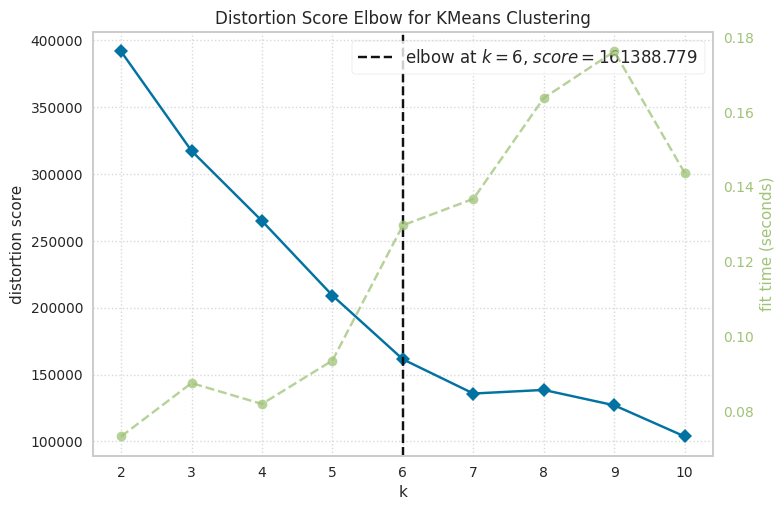

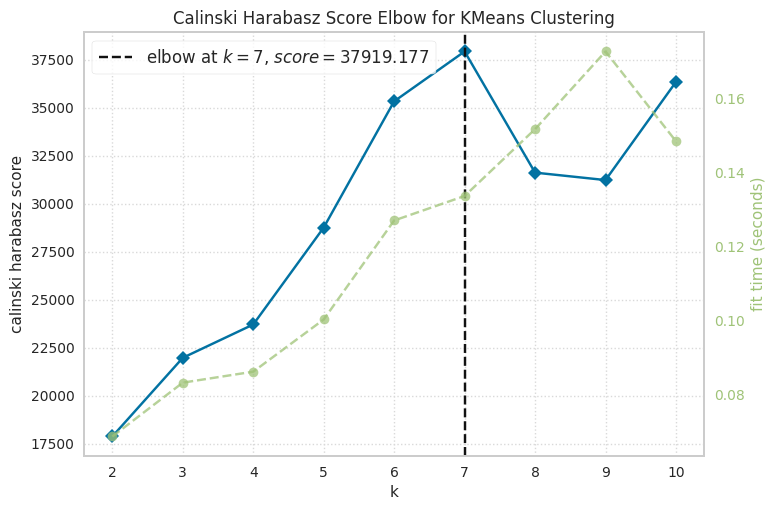

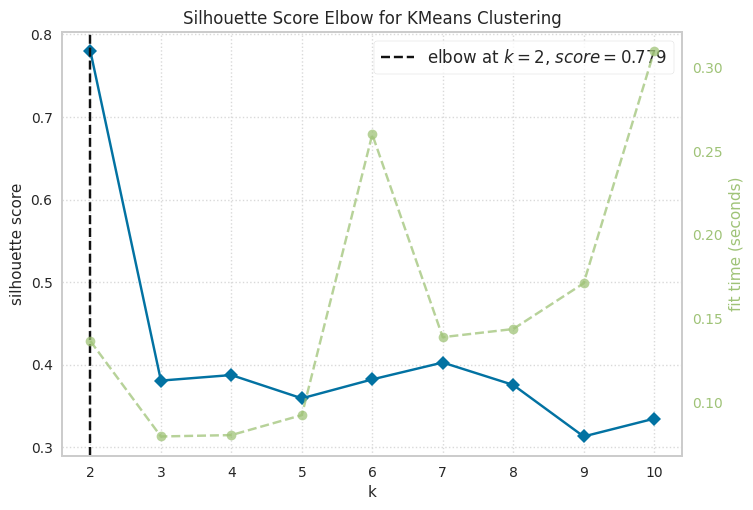

In [ ]:
for i in ['distortion', 'calinski_harabasz', 'silhouette']:  # 'silhouette' (very long)
# for i in ['distortion', 'calinski_harabasz']:  # 'silhouette' (very long)
    # Instantiating the clustering model and viewer
    model = cluster.KMeans(
        init='k-means++',
        n_init='auto',
        algorithm='lloyd',
        max_iter=300,
        tol=1e-4,
        random_state=42
    )
    visualizer = KElbowVisualizer(model, k=(2, 11), metric=i)

    visualizer.fit(X_model)
    visualizer.poof();

The optimal number of clusters seems to be : **5 clusters**<br>
Bear in mind that the choice of the number of clusters is also based on the business context: the number of clusters and the distribution of individuals within them must enable the implementation of the actions planned after clustering (interpretation of the different groups and resulting marketing actions).

- Choice of number of clusters :

In [ ]:
kmean_cluster_nb = 7

- Model creation and training :

In [ ]:
clust_kmeans = cluster.KMeans(
    n_clusters=kmean_cluster_nb,
    init='k-means++',
    n_init='auto',
    algorithm='lloyd',
    max_iter=300,
    tol=1e-4,
    random_state=42
)
t0 = time.time()  # To measure fit duration
clust_kmeans.fit(X_model)
kmeans_fit_time = time.time() - t0
print(f"Fit duration : {kmeans_fit_time:.2f} seconds.")

labels_kmeans = clust_kmeans.labels_

Fit duration : 0.18 seconds.


- Cluster representation on PCA components :

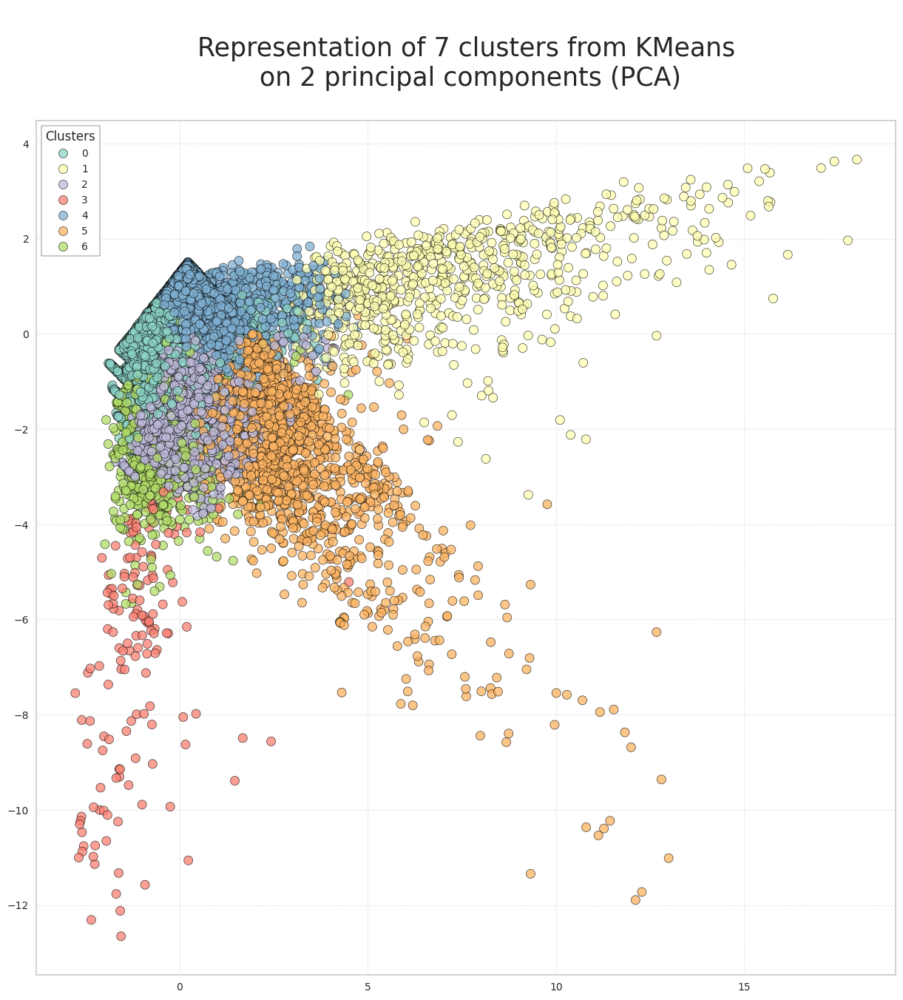

In [ ]:
draw_clusters(X_PCA, method="pca", model='KMeans', labels=labels_kmeans, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

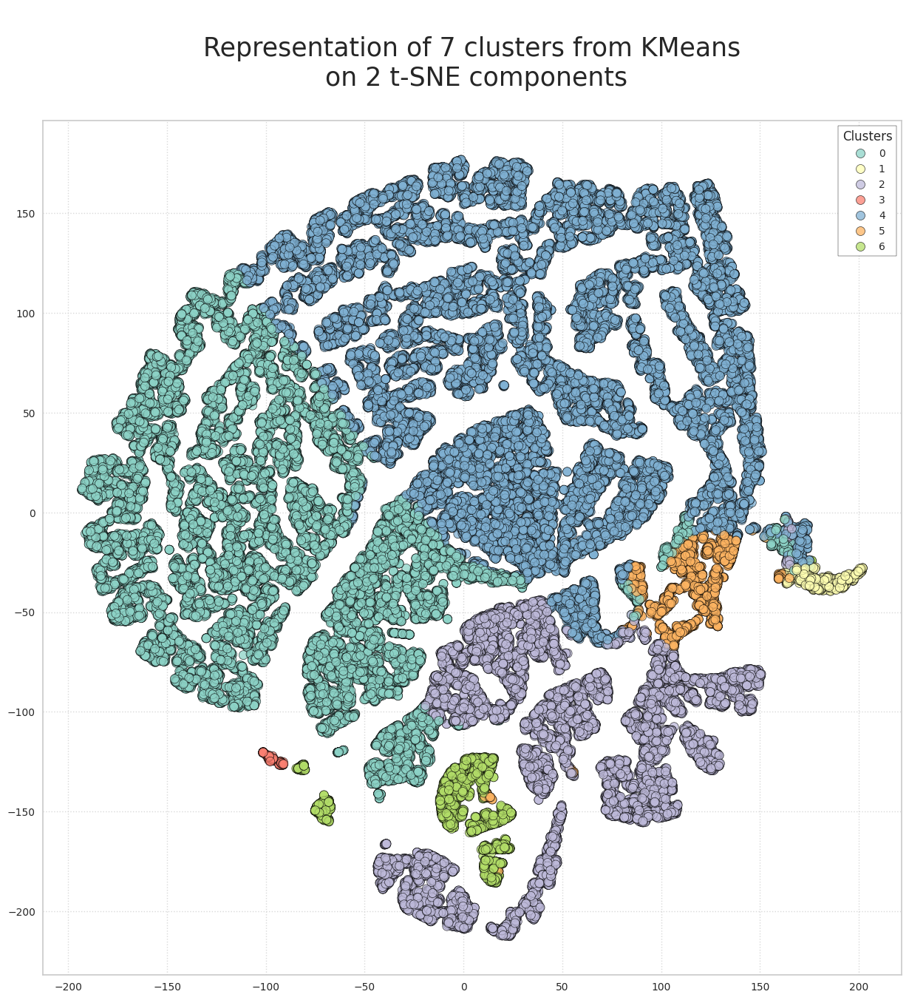

In [ ]:
if compute_tsne:
  draw_clusters(X_tSNE, method="tsne", model='KMeans', labels=labels_kmeans, alpha=0.75, display_legend=True)

- Cluster distribution :

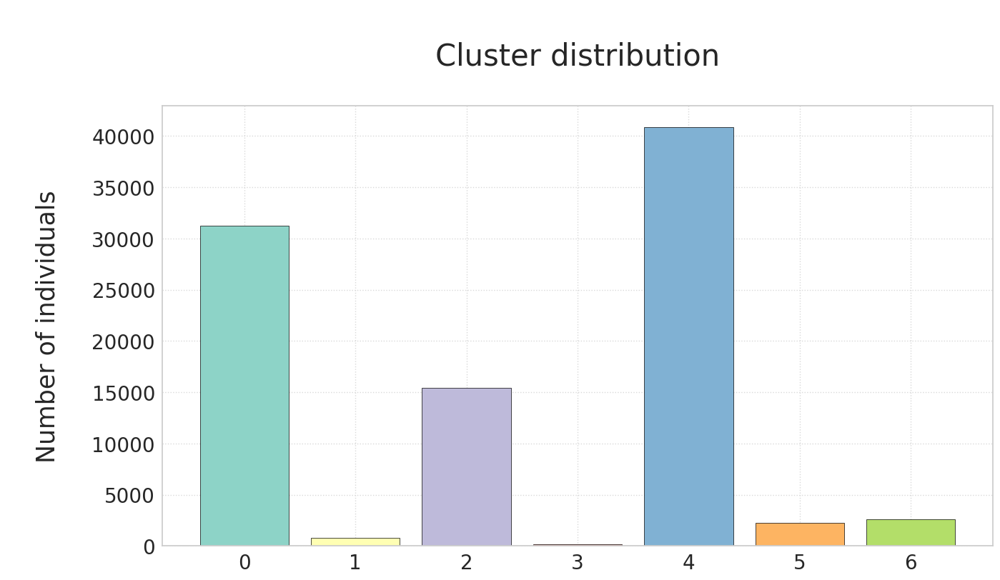

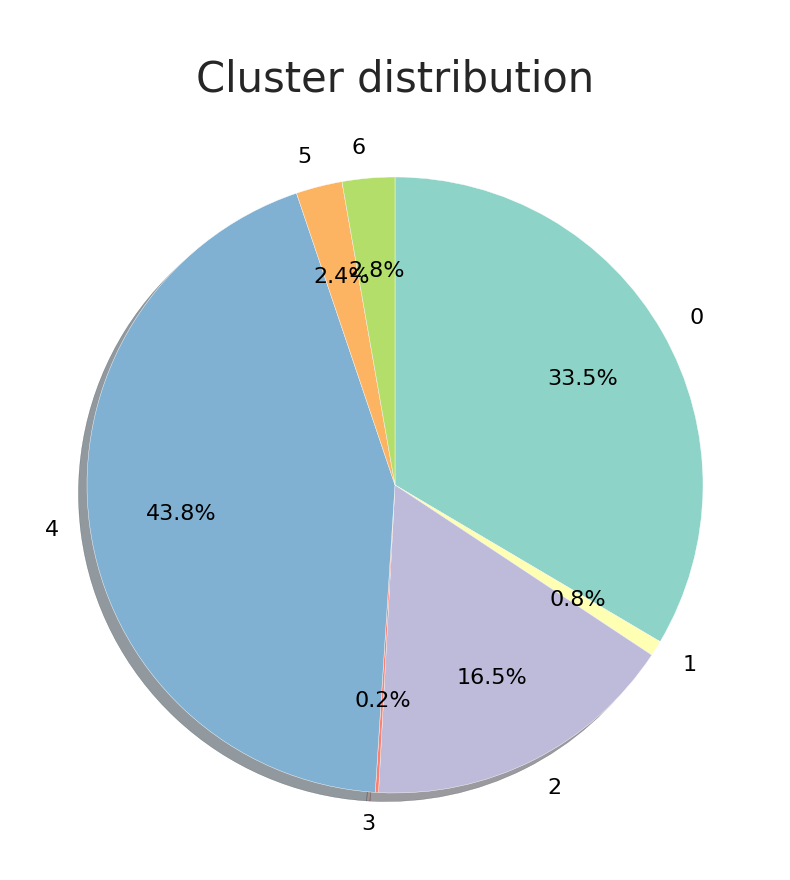

In [ ]:
cluster_proportion(labels=labels_kmeans)

- Calculating scores :

In [ ]:
kmeans_silhouette = silhouette_score(X_model, labels_kmeans)
print(f"Silhouette score : {kmeans_silhouette:0.3f}")
kmeans_bouldin = davies_bouldin_score(X_model, labels_kmeans)
print(f"Davies Bouldin score : {kmeans_bouldin:0.3f}")
kmeans_calinski = calinski_harabasz_score(X_model, labels_kmeans)
print(f"Calinski Harabasz score : {kmeans_calinski:0.3f}")
# Only for KMEANS
print(f"Distortion score : {clust_kmeans.inertia_:0.3f}")

Silhouette score : 0.403
Davies Bouldin score : 0.736
Calinski Harabasz score : 37919.177
Distortion score : 135785.573


- Silhouette visualization :

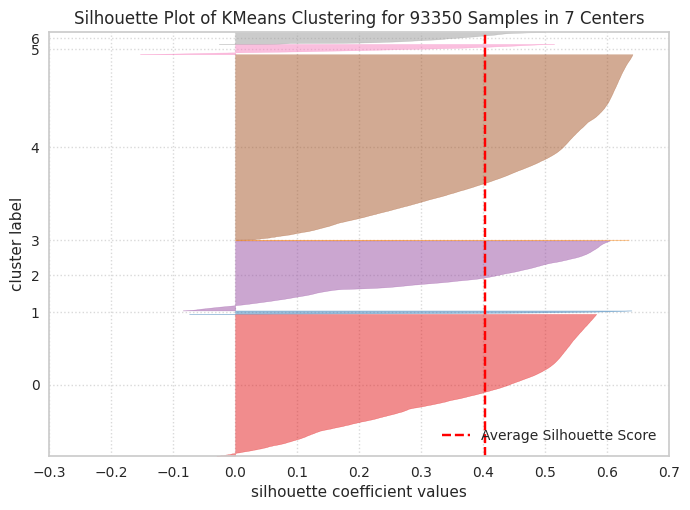

In [ ]:
# This is a long operation, factulative
SilhouetteVis = True

if SilhouetteVis:
    model = cluster.KMeans(
        n_clusters=kmean_cluster_nb,
        init='k-means++',
        n_init='auto',
        algorithm='lloyd',
        max_iter=300,
        tol=1e-4,
        random_state=42
    )
    visualizer = SilhouetteVisualizer(model)

    visualizer.fit(X_model)
    visualizer.poof();

- Intercluster distance measurement :\
This method can relies on cluster centroïds distances. So it can only be used on algorithms based on Kmeans



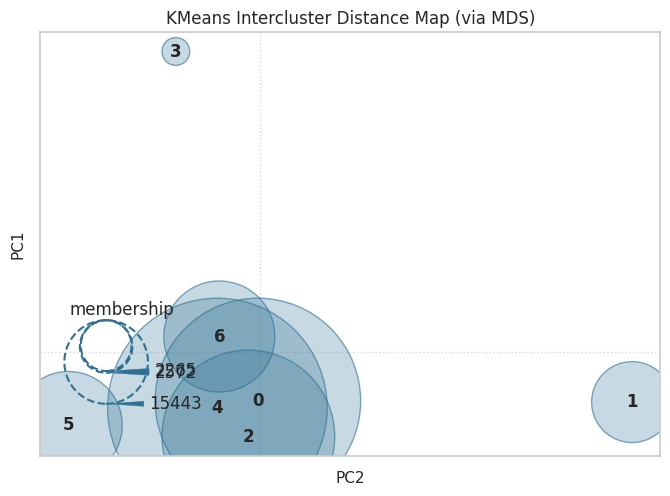

In [ ]:
model = cluster.KMeans(
    n_clusters=kmean_cluster_nb,
    init='k-means++',
    n_init='auto',
    algorithm='lloyd',
    max_iter=300,
    tol=1e-4,
    random_state=42
)
visualizer = InterclusterDistance(model)

visualizer.fit(X_model)
visualizer.show();

**There's a lot of overlap between different clusters.**

#### **2. BisectingKMeans**

- Choosing the data to be passed to the model :

In [ ]:
X_model = X_scaled

- Finding the optimal number of clusters for BisectingKMeans :

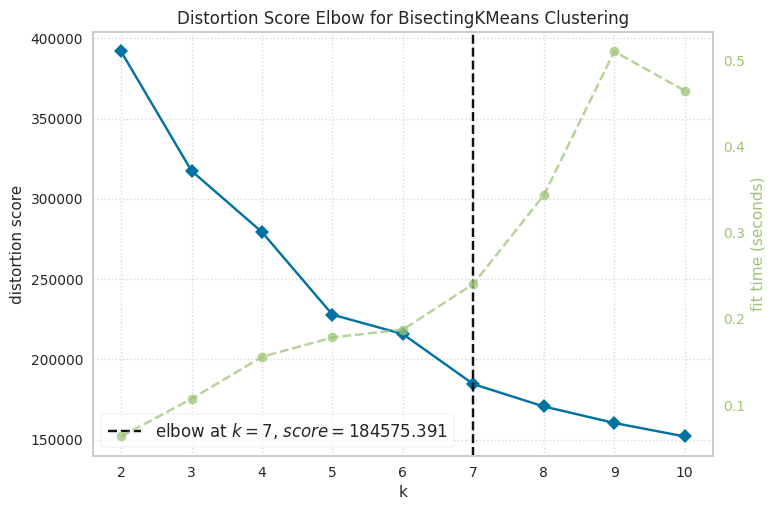

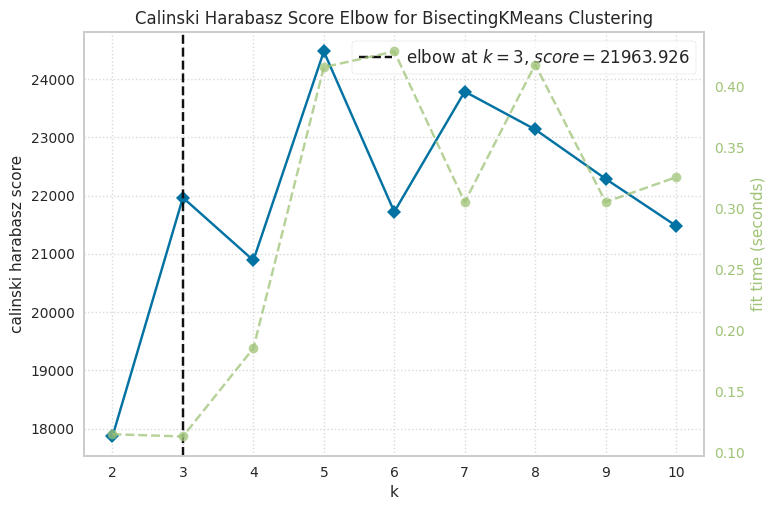

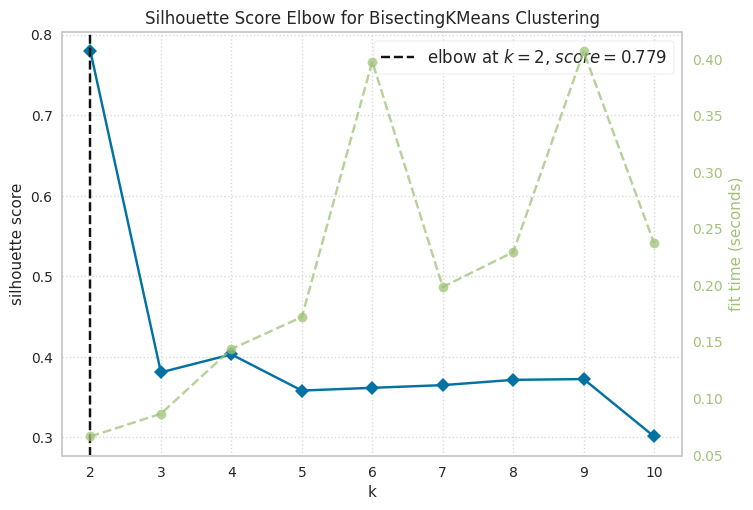

In [ ]:
for i in ['distortion', 'calinski_harabasz', 'silhouette']:  # 'silhouette' (very long)
# for i in ['distortion', 'calinski_harabasz']:  # 'silhouette' (very long)
    # Instantiating the clustering model and viewer
    model = cluster.BisectingKMeans(
        init='k-means++',
        random_state=42,
        n_init=1,
        bisecting_strategy='biggest_inertia'
    )
    visualizer = KElbowVisualizer(model, k=(2, 11), metric=i)

    visualizer.fit(X_model)
    visualizer.poof();

It was decided to base the ideal number of clusters on the silhouette score and the business context : **7 clusters**<br>
Bear in mind that the choice of the number of clusters is also based on the business context: the number of clusters and the distribution of individuals within them must enable the implementation of the actions planned after clustering (interpretation of the different groups and resulting marketing actions).

- Choice of number of clusters :

In [ ]:
biskmean_cluster_nb = 7

- Model creation and training :

In [ ]:
clust_bis = cluster.BisectingKMeans(
    n_clusters=biskmean_cluster_nb,
    init='k-means++',
    random_state=42,
    n_init=1,
    bisecting_strategy='biggest_inertia'
)
t0 = time.time()  # To measure fit duration
clust_bis.fit(X_model)
bis_fit_time = time.time() - t0
print(f"Fit duration : {bis_fit_time:.2f} secondes.")

labels_bis = clust_bis.labels_

Fit duration : 0.20 secondes.


- Cluster representation on PCA components :

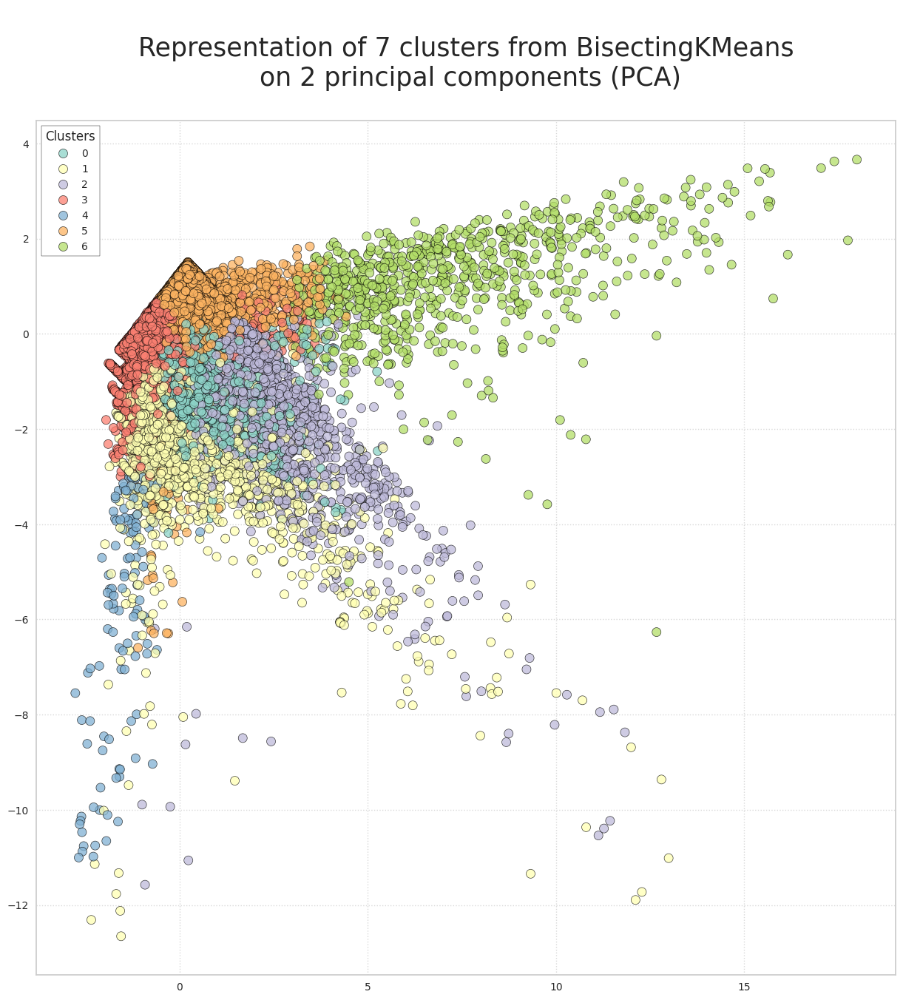

In [ ]:
draw_clusters(X_PCA, method="pca", model='BisectingKMeans', labels=labels_bis, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

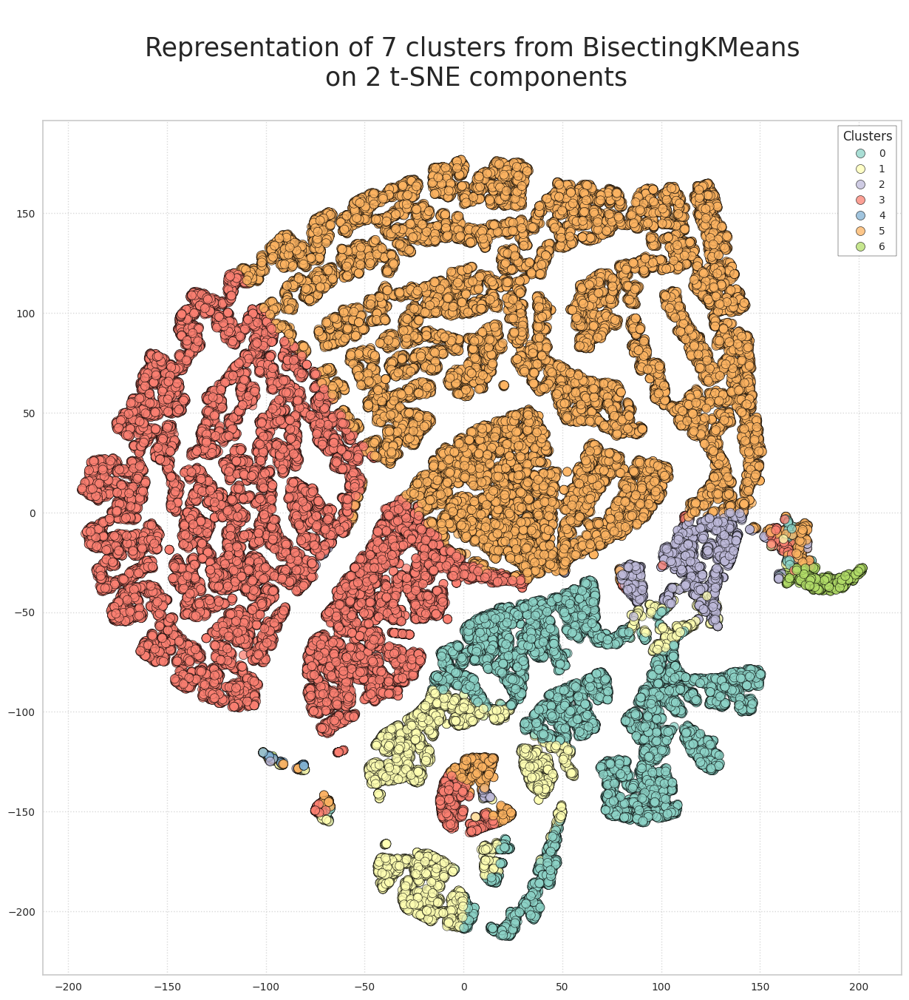

In [ ]:
if compute_tsne:
  draw_clusters(X_tSNE, method="tsne", model='BisectingKMeans', labels=labels_bis, alpha=0.75, display_legend=True)

- Cluster distribution :

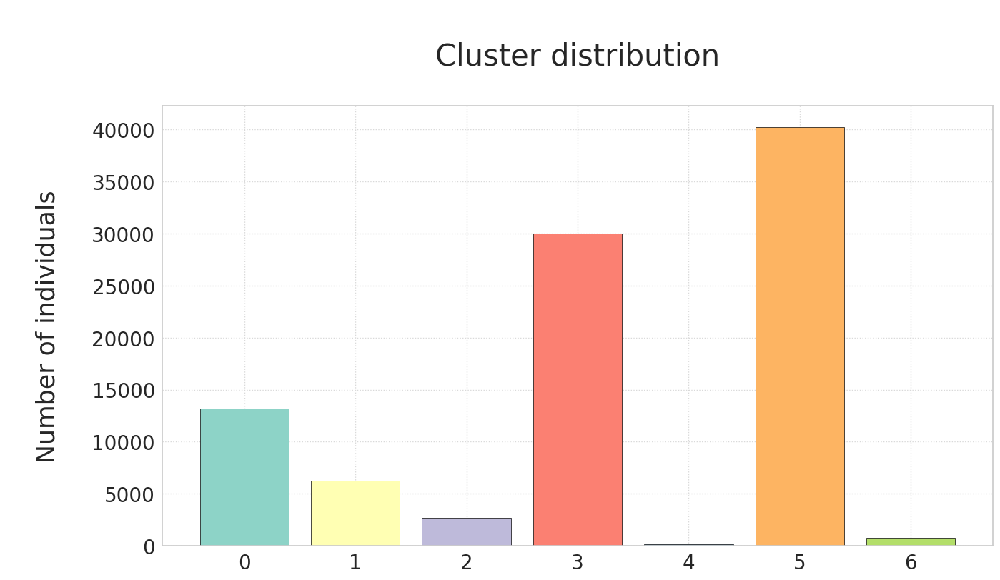

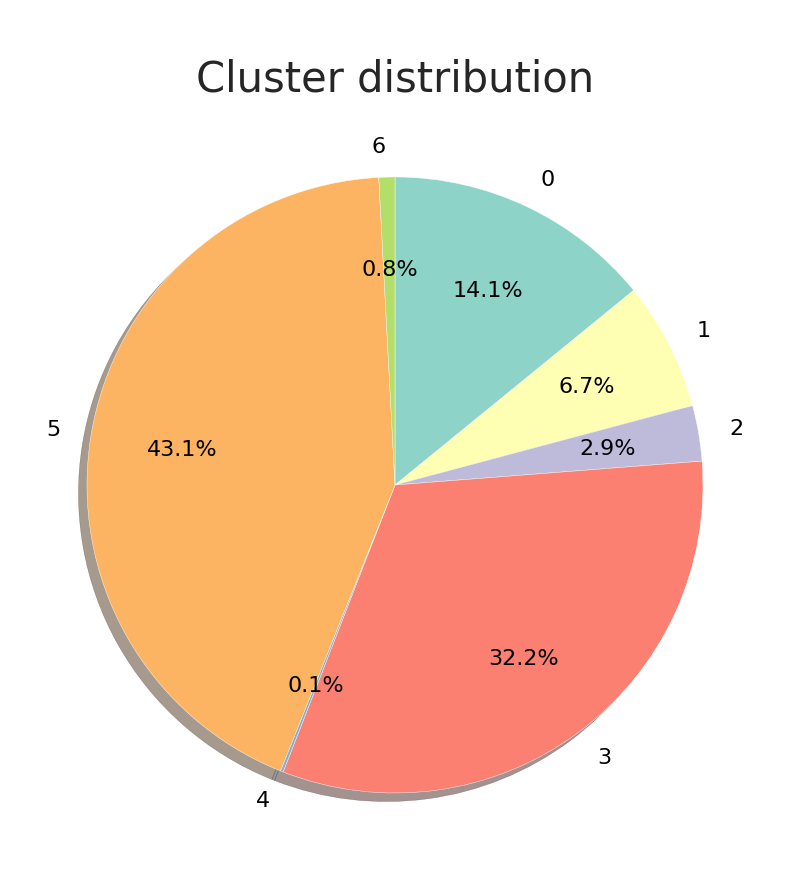

In [ ]:
cluster_proportion(labels=labels_bis)

- Calculating scores :

In [ ]:
bis_silhouette = silhouette_score(X_model, labels_bis)
print(f"Silhouette score : {bis_silhouette:0.3f}")
bis_bouldin = davies_bouldin_score(X_model, labels_bis)
print(f"Davies Bouldin score : {bis_bouldin:0.3f}")
bis_calinski = calinski_harabasz_score(X_model, labels_bis)
print(f"Calinski Harabasz score : {bis_calinski:0.3f}")
print(f"Distortion score : {clust_bis.inertia_:0.3f}")

Silhouette score : 0.365
Davies Bouldin score : 1.073
Calinski Harabasz score : 23783.438
Distortion score : 184576.098


- Silhouette visualization :

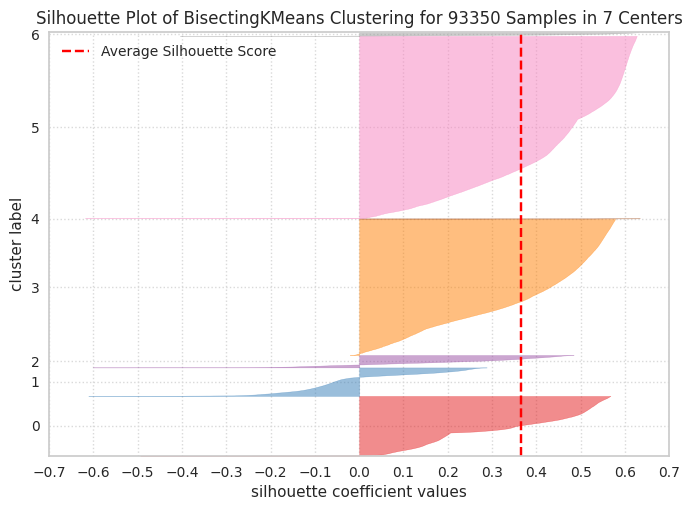

In [ ]:
# This is a long operation, I set the parameters if I want to do it or not
SilhouetteVis = True

if SilhouetteVis == True:
    model = cluster.BisectingKMeans(
        n_clusters=biskmean_cluster_nb,
        init='k-means++',
        random_state=42,
        n_init=1,
        bisecting_strategy='biggest_inertia'
    )
    visualizer = SilhouetteVisualizer(model)

    visualizer.fit(X_model)
    visualizer.poof();

- Intercluster distance measurement :\
This method can relies on cluster centroïds distances. So it can only be used on algorithms based on Kmeans



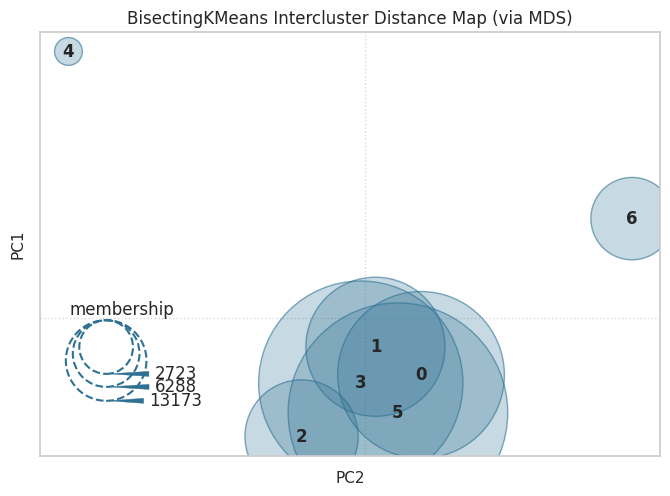

In [ ]:
model = cluster.BisectingKMeans(n_clusters=biskmean_cluster_nb, init='k-means++', random_state=42, n_init=1, bisecting_strategy='biggest_inertia')
visualizer = InterclusterDistance(model)

visualizer.fit(X_model)
visualizer.show();

Clusters are overlapping.

#### **3. Birch**

**For this model, the initial choice of features produced very poor results. After various trials, it turned out that the best results were obtained with the following procedure:**

- Greater number of features used.
- Reduction of data dimensions by PCA.
- Passing data through the model.

- Data scaling and encoding :

In [ ]:
X_birch = scale_and_encode(features=features_list, data=data)

Standard-scaled numeric features: ['recency', 'frequency', 'total_spent', 'avg_payment_sequential', 'avg_review_score']
One hot encoded categorical features: []


In [ ]:
X_model = X_scaled

- t-SNE to represent our data (with selected features) in two dimensions :

In [ ]:
# File name used for saving/loading data
# nom_fichier = 'X_tSNE_birch'

# tSNE_birch = tSNE_maker(nom_fichier, data=X_model)

In [ ]:
if compute_tsne:
  # File name used for saving/loading data
  tSNE_birch = tSNE_maker(filename, data=X_birch)

The file X_tSNE_5_parameters__avg_payment_sequential_avg_review_score.xlsx already exists, if you wish to export a new version, delete the old one..
Importing data from X_tSNE_5_parameters__avg_payment_sequential_avg_review_score.xlsx...
Imported data.


- For this model, we will reduce the dimensions of the data by PCA, to improve performance:

In [ ]:
len(features_list)

5

In [ ]:
reduce_dimension = True
if reduce_dimension:
  X_PCA_birch = PCA_maker(ncomponents=len(features_list), data=X_model)
  # Selection of data to be passed to the model
  X_model = X_PCA_birch

--------------------------------------------------
Number of components selected : 5

Variances captured by the components :

Component n°1 : 21.91 % (21.91 % cumulative).
Component n°2 : 20.77 % (42.68 % cumulative).
Component n°3 : 20.05 % (62.73 % cumulative).
Component n°4 : 19.27 % (82.00 % cumulative).
Component n°5 : 18.00 % (100.00 % cumulative).

Together, these 5 components capture 100.00 % of variance.
--------------------------------------------------


- Choice of the number of clusters with which the best results are obtained, based on scores and business context:

In [ ]:
birch_cluster_nb = 7

- Model creation and training :

In [ ]:
# if n_clusters not specified, Birhc only finds 3 clusters... Not satisfying.
clust_Birch = cluster.Birch(n_clusters=birch_cluster_nb)
t0 = time.time()  # To measure fit duration
clust_Birch.fit(X_model)
birch_fit_time = time.time() - t0
print(f"Fit duration : {birch_fit_time:.2f} seconds.")

labels_birch = clust_Birch.labels_

Fit duration : 7.19 seconds.


- Cluster representation on PCA components :

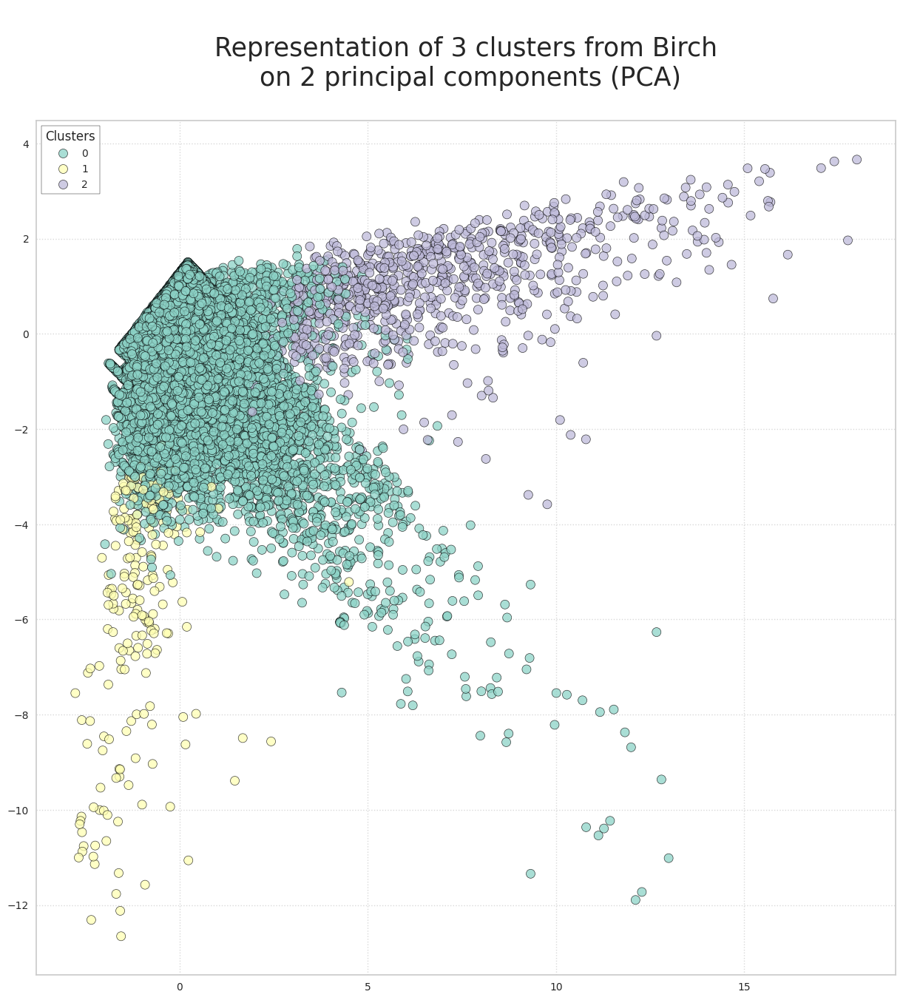

In [ ]:
draw_clusters(X_PCA, method="pca", model='Birch', labels=labels_birch, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

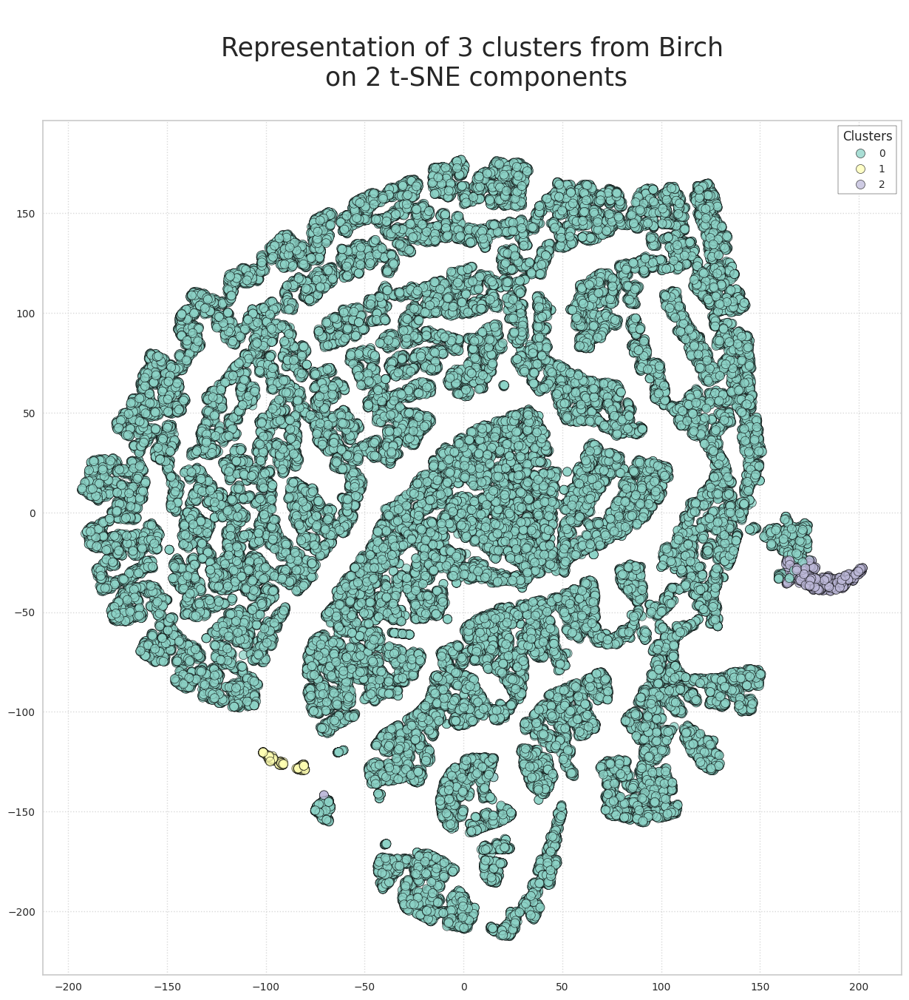

In [ ]:
if compute_tsne:
  draw_clusters(X_tSNE, method="tsne", model='Birch', labels=labels_birch, alpha=0.75, display_legend=True)

- Cluster distribution :

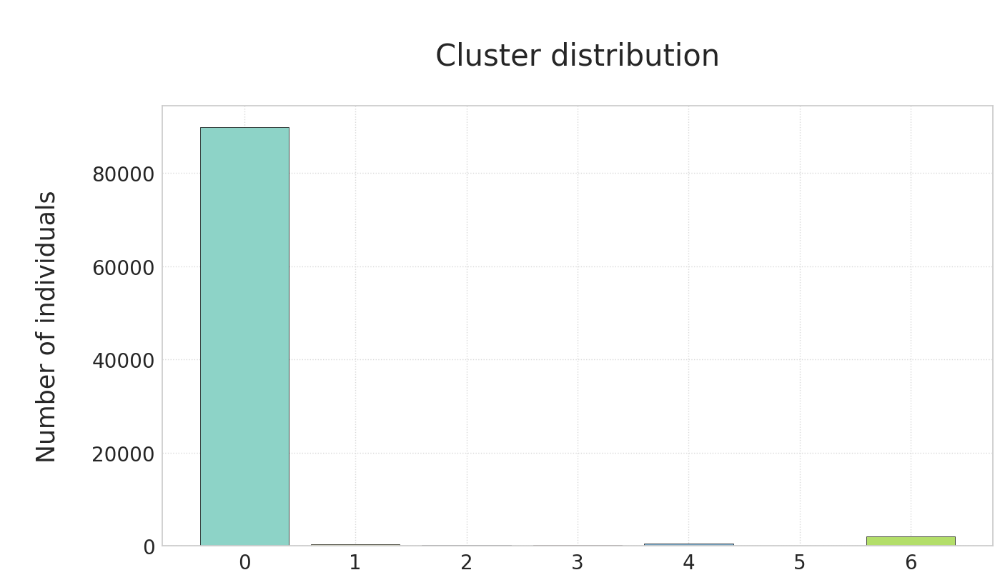

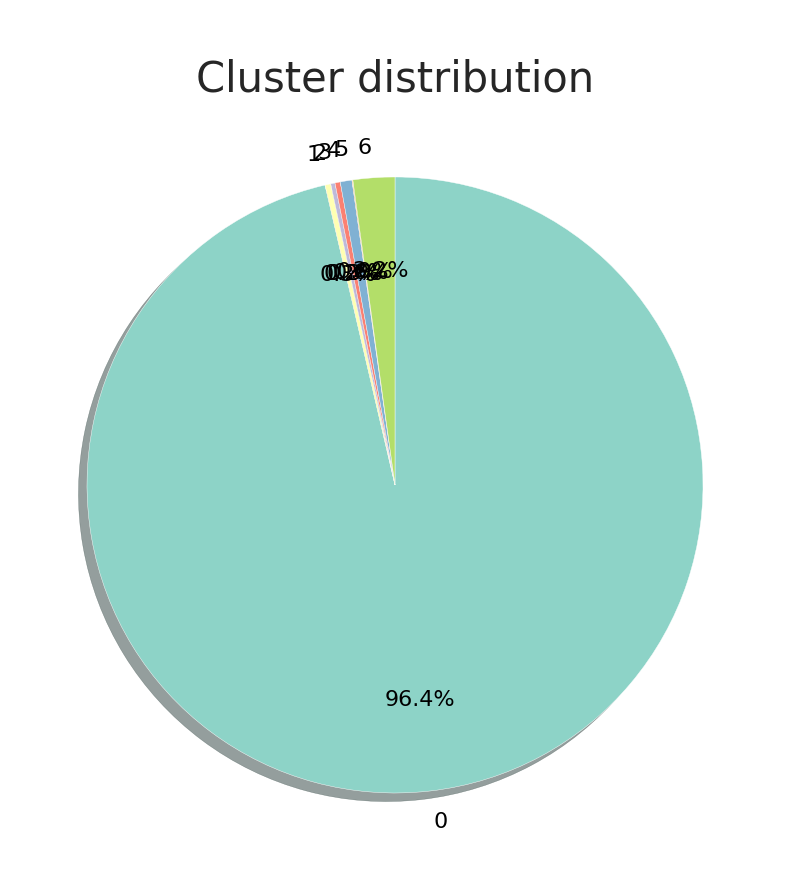

In [ ]:
cluster_proportion(labels=labels_birch)

- Calculating scores :

In [ ]:
birch_silhouette = silhouette_score(X_birch, labels_birch)
print(f"Silhouette score : {birch_silhouette:0.3f}")
birch_bouldin = davies_bouldin_score(X_birch, labels_birch)
print(f"Davies Bouldin score : {birch_bouldin:0.3f}")
birch_calinski = calinski_harabasz_score(X_birch, labels_birch)
print(f"Calinski Harabasz score : {birch_calinski:0.3f}")

Silhouette score : 0.518
Davies Bouldin score : 0.669
Calinski Harabasz score : 11867.705


#### **4. DBSCAN**

This model crashes when processing low

- Choosing the data to be passed to the model :

In [ ]:
X_model = X_scaled.values

- Model creation and training :

In [ ]:
clust_DBSCAN = cluster.DBSCAN(eps=0.7, min_samples=7)
t0 = time.time()  # To measure fit duration
clust_DBSCAN.fit(X_model)
dbscan_fit_time = time.time() - t0
print(f"Fit duration : {dbscan_fit_time:.2f} seconds.")
print("Labels :", np.unique(clust_DBSCAN.labels_), "(-1 represents the noise).")

labels_dbscan = clust_DBSCAN.labels_

Fit duration : 93.92 seconds.
Labels : [-1  0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18] (-1 represents the noise).


- Cluster representation on PCA components :

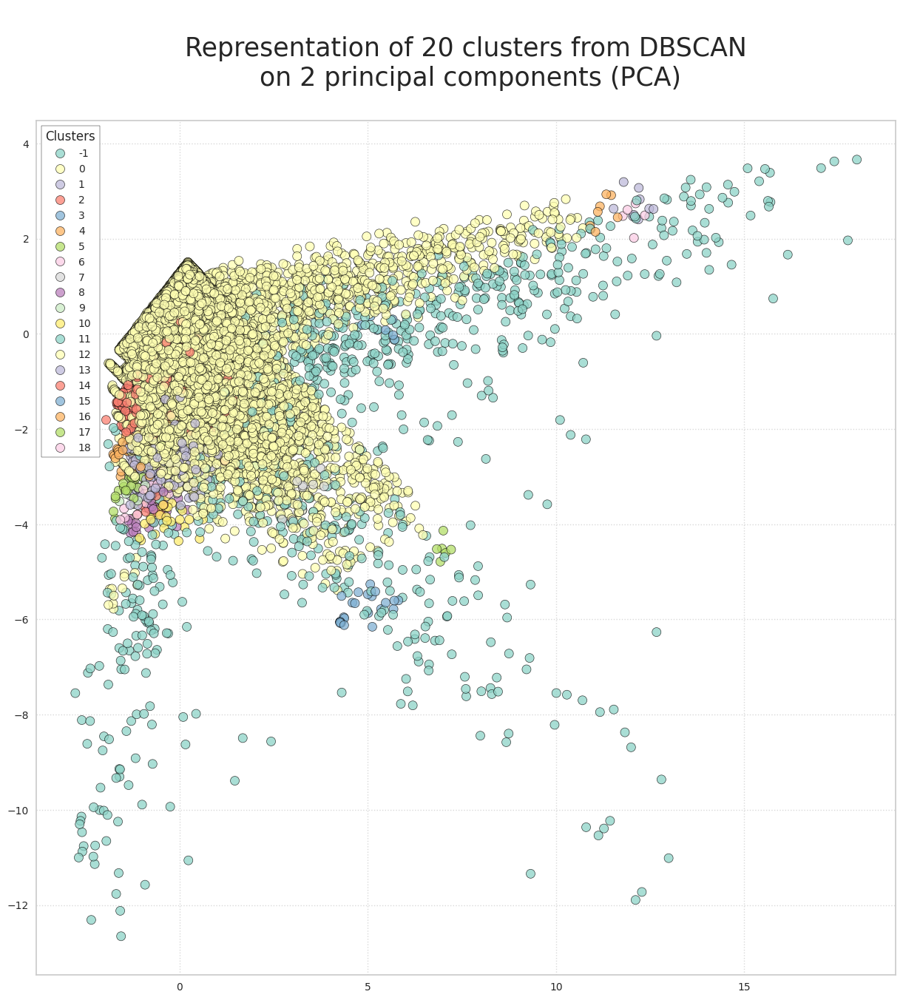

In [ ]:
draw_clusters(X_PCA, method="pca", model='DBSCAN', labels=labels_dbscan, alpha=0.75, display_legend=True)

- Cluster representation on t-SNE components :

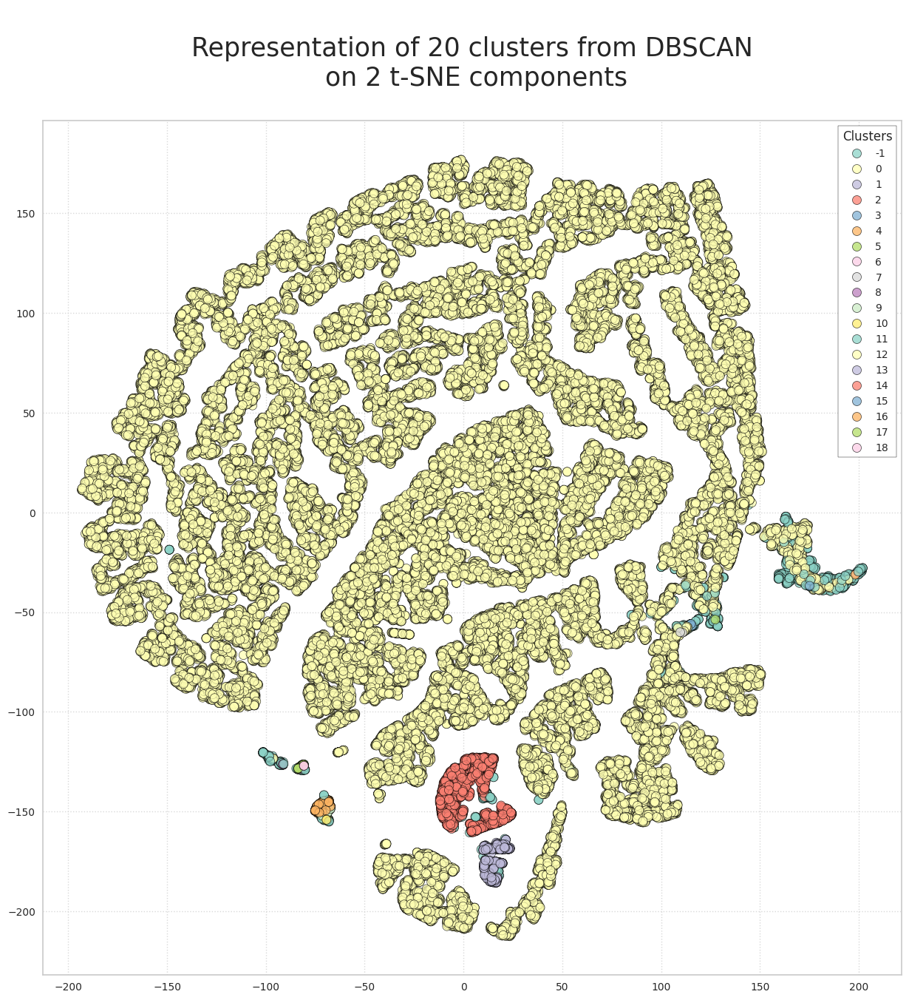

In [ ]:
if compute_tsne:
  # draw_clusters(tsne_data=X_tSNE, model='DBSCAN', labels=labels_dbscan, afficher_legende=True)
  draw_clusters(X_tSNE, method="tsne", model='DBSCAN', labels=labels_dbscan, alpha=0.75, display_legend=True)

- Cluster distribution :

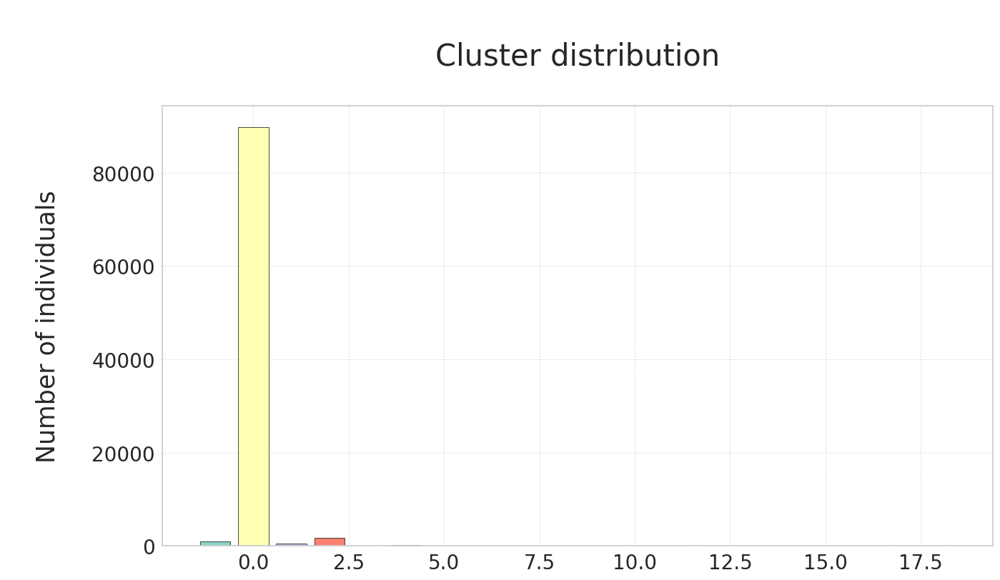

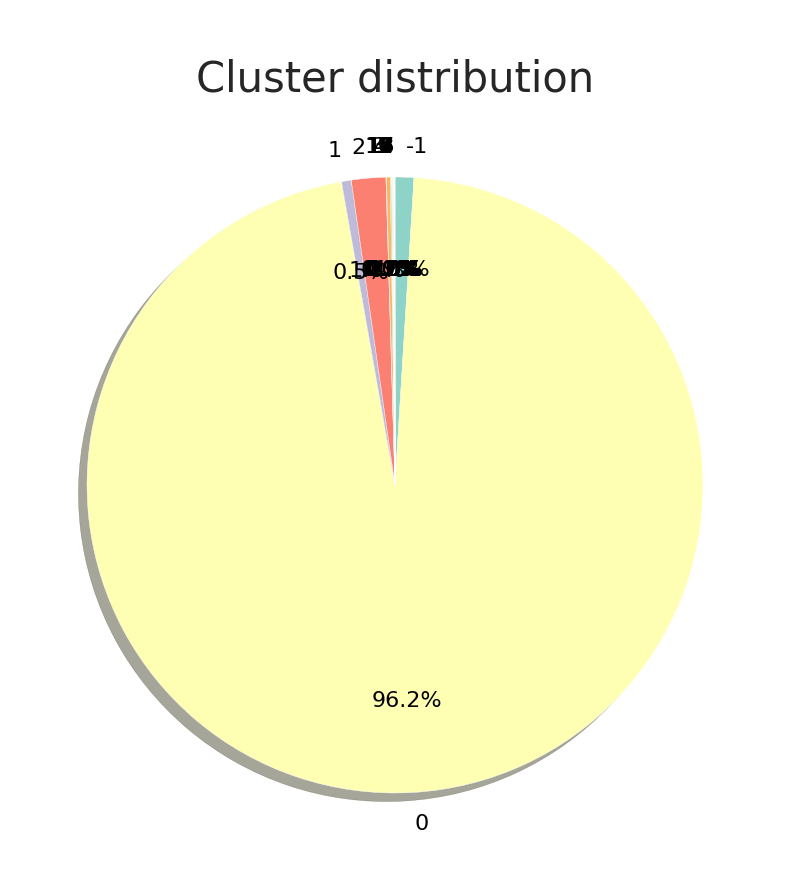

In [ ]:
cluster_proportion(labels=labels_dbscan)

**The clusters obtained are not at all satisfactory given the business context.**

- Calculating scores :

In [ ]:
# If more than one cluster found
if len(np.unique(labels_dbscan)) > 1:
    dbscan_silhouette = silhouette_score(X_model, labels_dbscan)
    print(f"Silhouette score : {dbscan_silhouette:0.3f}")
    dbscan_bouldin = davies_bouldin_score(X_model, labels_dbscan)
    print(f"Davies Bouldin score : {dbscan_bouldin:0.3f}")
    dbscan_calinski = calinski_harabasz_score(X_model, labels_dbscan)
    print(f"Calinski Harabasz score : {dbscan_calinski:0.3f}")
# Otherwise scores cannot be calculated
else:
    print("Not enough clusters to calculate scores.")

Silhouette score : 0.401
Davies Bouldin score : 1.365
Calinski Harabasz score : 1204.006


### **<span style="color: #8181FF">Results for models tested</span>**

,Model,Number of clusters,Fit duration,Silhouette score,Davies Bouldin score,Calinski Harabasz score
0,KMeans,7,0.137554,0.402815,0.735652,37919.176628
1,DBSCAN,20,93.924027,0.400508,1.364770,1204.006166
2,Birch,7,2.853436,0.518219,0.669491,11867.704533
3,BisectingKMeans,7,0.209294,0.364994,1.073450,23783.438196


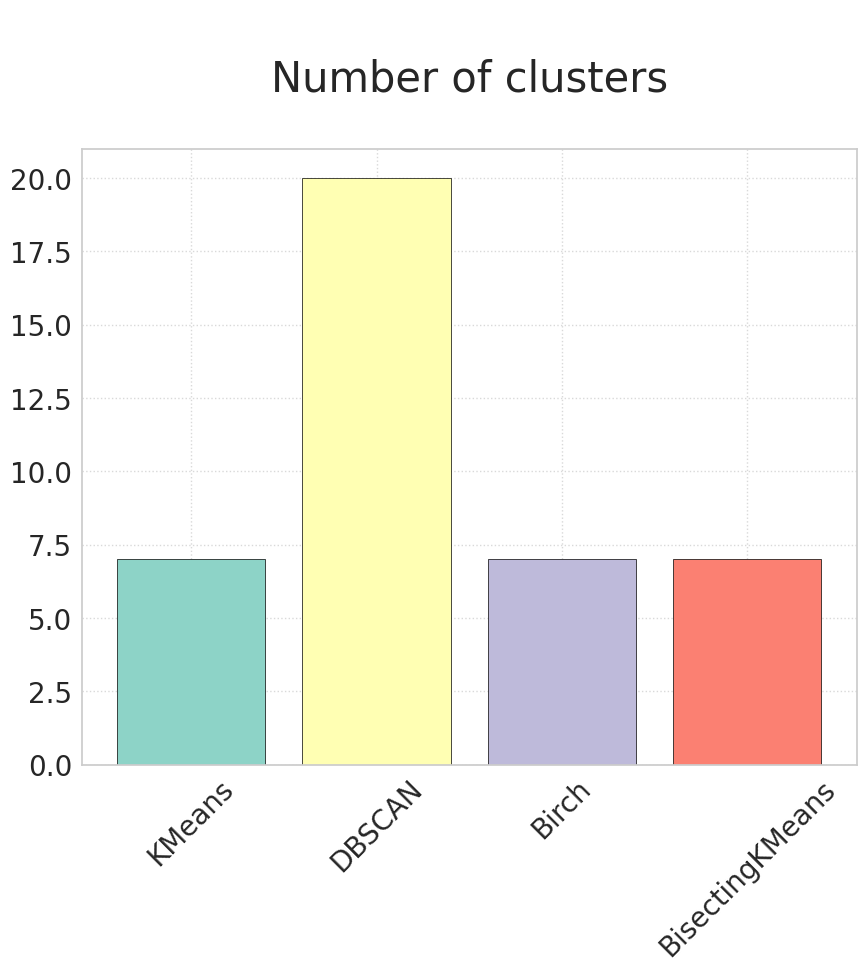

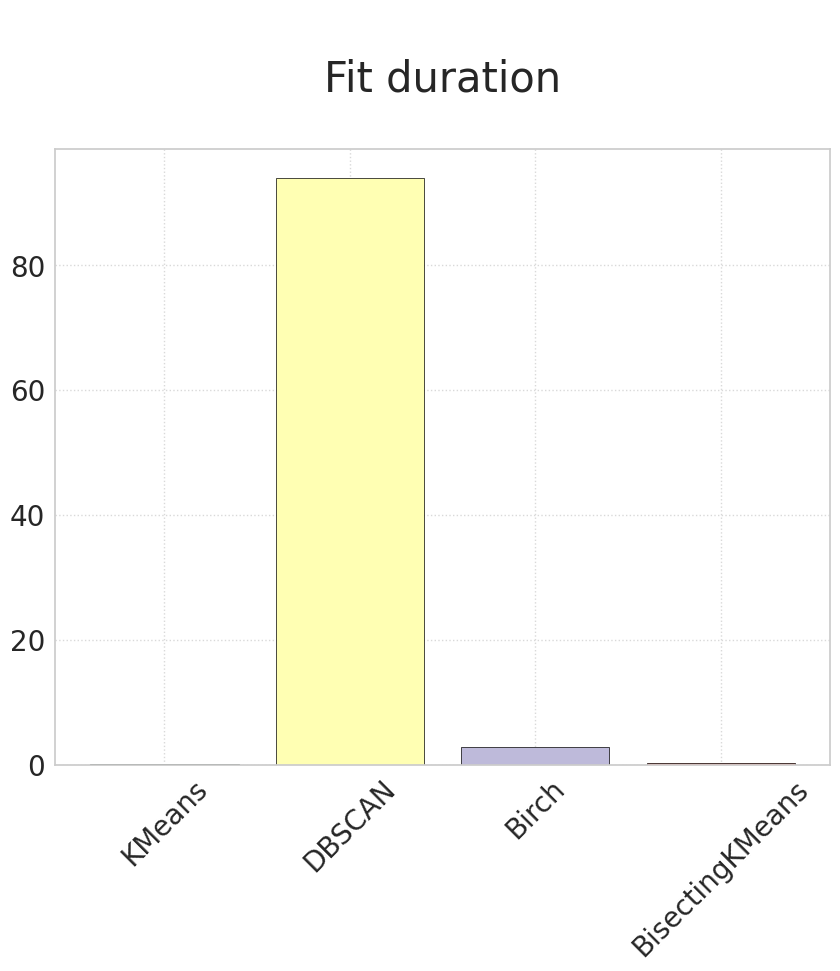

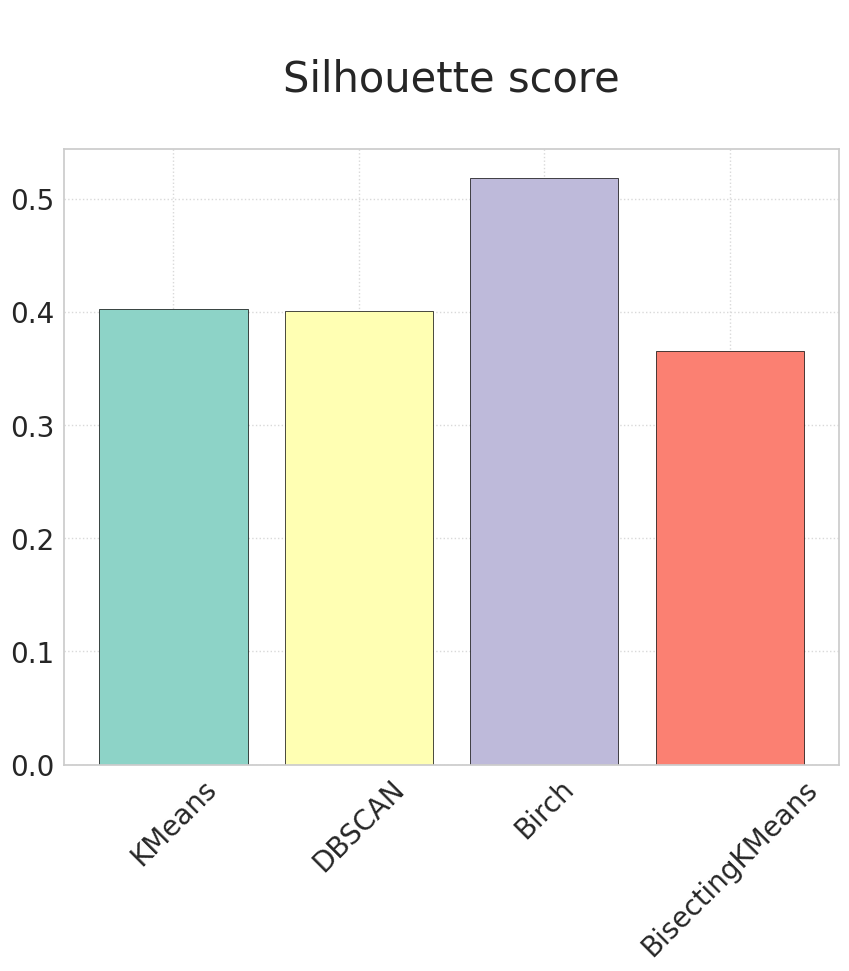

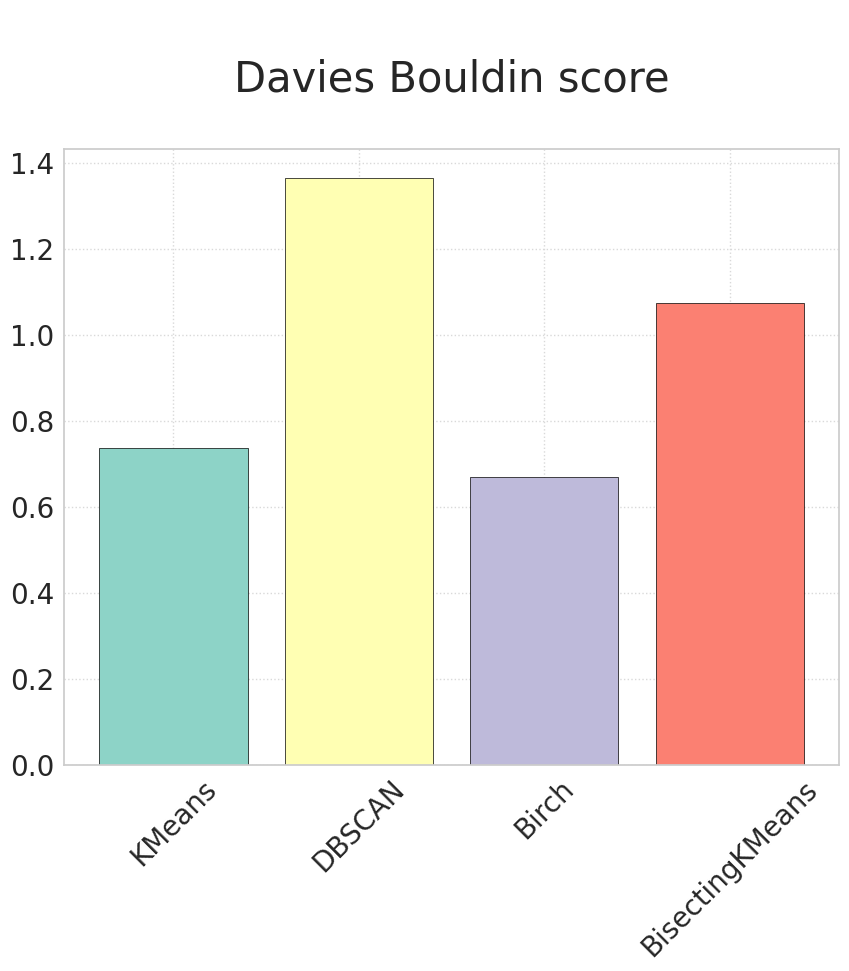

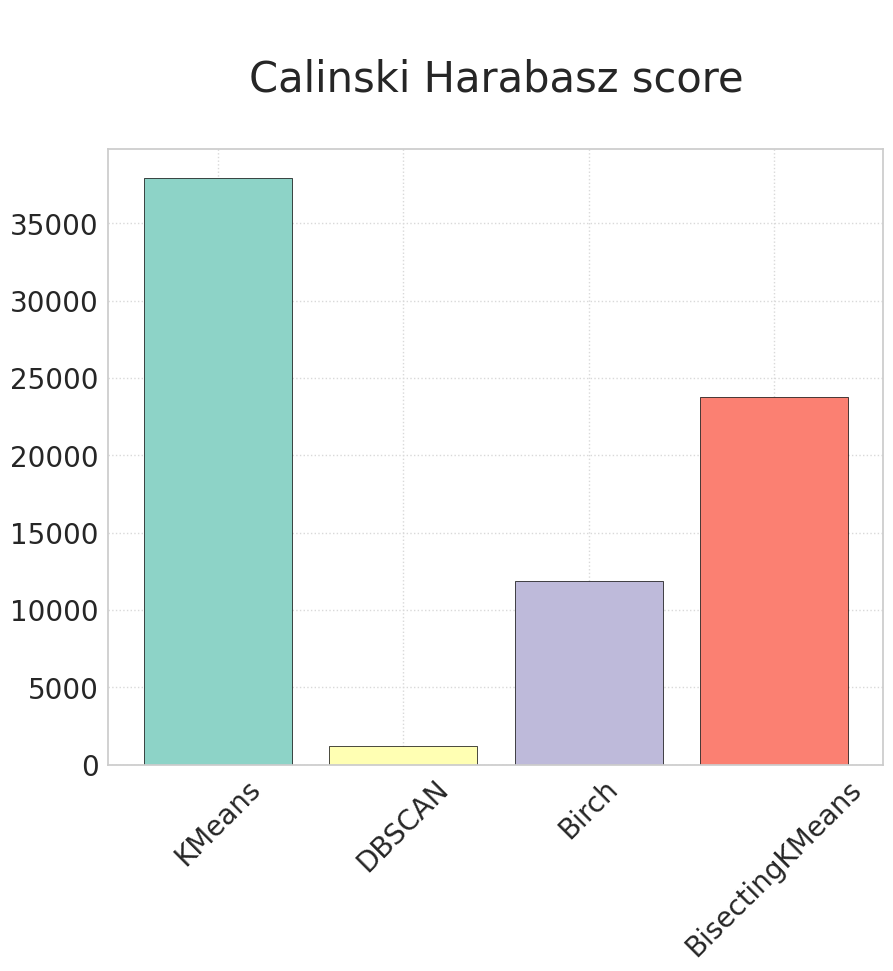

In [ ]:
# Retrieve all metrics and create a dataframe
comparo = {
    "Model": [
        "KMeans",
        "DBSCAN",
        "Birch",
        "BisectingKMeans"
    ],
    "Number of clusters": [
        kmean_cluster_nb,
        len(np.unique(labels_dbscan)),
        birch_cluster_nb,
        biskmean_cluster_nb
    ],
    "Fit duration": [
        kmeans_fit_time,
        dbscan_fit_time,
        birch_fit_time,
        bis_fit_time
    ],
    "Silhouette score": [
        kmeans_silhouette,
        dbscan_silhouette,
        birch_silhouette,
        bis_silhouette
    ],
    "Davies Bouldin score": [
        kmeans_bouldin,
        dbscan_bouldin,
        birch_bouldin,
        bis_bouldin
    ],
    "Calinski Harabasz score": [
        kmeans_calinski,
        dbscan_calinski,
        birch_calinski,
        bis_calinski
    ]
}
comparo_df = pd.DataFrame(data=comparo)

# Dataframe display
display(comparo_df)

# Comparison of different metrics with barplots
for i in ['Number of clusters', 'Fit duration', 'Silhouette score', 'Davies Bouldin score', 'Calinski Harabasz score']:
    plt.figure(figsize=(10, 8))
    plt.bar(
        comparo_df['Model'],
        comparo_df[i],
        color=sns.color_palette("Set3", 10),
        edgecolor='black',
        linewidth=0.5,
        width=0.8,
    )
    plt.title(f"\n{i}\n", fontsize=30)
    plt.xticks(fontsize=20, rotation=45)
    plt.yticks(fontsize=20)
    plt.show()

- Since Calinsky Harabasz score is less sensible to clusters overlap, then the result is better for both Kmeans and Bisecting Kmeans than birch
- Davies Bouldin score is more sensible to clusters overlap which explains the better score for DBSCan.
- Silhouette is particularly overlap sensible. It is also more sensible than CH to separation between clusters.

However, birch clustering is problematic since it aggreages almost 98% of the dataset.

### **Choice of final model**

- DBSCAN and Birch brings bad results since most of the data are aggregated inside of the first cluster. The others are very small.
- Kmeans has better results with 7 clusters. Its fit duration is very fast. On the other hand, clusters overlap.
- BisectingKMeans has lower results (still with 7 clusters).

Next, we have to check stability.

- Initialization stability :

We'll run several iterations of the model, without fixing the random state, and compare the clusters obtained with the results when the random state is fixed. To compare labels, I'll use the Adjusted Rand Score (ARI).

In [ ]:
print("ARI scores between clusters obtained with and without random state :\n-------------------")

for i in range(10):

    # I use an identical model, but without setting the random state
    clust_random = cluster.KMeans(
        init='k-means++',
        n_init='auto',
        algorithm='lloyd',
        max_iter=300,
        tol=1e-4,
    )
    clust_random.fit(X_model)

    labels_kmeans_random = clust_random.labels_

    # I compare and display the clusters obtained with the labels obtained previously (labels_kmeans)
    print(f"Iteration {i+1} : {adjusted_rand_score(labels_kmeans, labels_kmeans_random):0.3f}")

ARI scores between clusters obtained with and without random state :
-------------------
Iteration 1 : 0.949
Iteration 2 : 0.573
Iteration 3 : 0.949
Iteration 4 : 0.948
Iteration 5 : 0.573
Iteration 6 : 0.949
Iteration 7 : 0.497
Iteration 8 : 0.949
Iteration 9 : 0.949
Iteration 10 : 0.949


ARI scores are still high and stability is good. Despite BisectingKMeans has a slightly lower silhouette score, we will keep it as this model is more stable.

In [ ]:
print("ARI scores between random state and non-random state clusters :\n-------------------")

for i in range(10):

    # I use an identical model, but without setting the random state
    clust_bis_random = cluster.BisectingKMeans(
        n_clusters=biskmean_cluster_nb,
        init='k-means++',
        n_init=1,
        bisecting_strategy='biggest_inertia'
    )
    clust_bis_random.fit(X_model)

    labels_bis_random = clust_bis_random.labels_

    # I compare and display the clusters obtained with the labels obtained previously (labels_bis)
    print(f"Iteration {i+1} : {adjusted_rand_score(labels_bis, labels_bis_random):0.3f}")

ARI scores between random state and non-random state clusters :
-------------------
Iteration 1 : 0.906
Iteration 2 : 0.857
Iteration 3 : 0.624
Iteration 4 : 0.558
Iteration 5 : 0.601
Iteration 6 : 0.937
Iteration 7 : 0.902
Iteration 8 : 0.902
Iteration 9 : 0.903
Iteration 10 : 0.946


ARI scores are still high and stability is good. Since silhouette score is lower than KMeans Cluster + stability is similiar, we will keep KMeans.

**After comparison, we decided to keep the classic Kmeans model (silhouette score = 0.403 + good stability according to ARI)**

### **<span style="color: #8181FF">Business interpretation of clusters</span>**

- Add labels obtained with the selected model to the original dataset :

In [ ]:
# labels_bis : labels obtained with BisectingKMeans
data['Cluster_KMeans'] = labels_kmeans

- Graphical representations of value distributions according to clusters :

In [ ]:
data['Cluster_KMeans']

,Cluster_KMeans
0,4
1,4
2,0
3,0
4,0
...,...
93345,5
93346,0
93347,0
93348,4


['customer_unique_id', 'customer_lat', 'customer_lng', 'orders_number', 'first_purchase_date', 'last_purchase_date', 'avg_spent', 'preferred_payment_type', 'avg_customer_seller_distance_km', 'preferred_category', 'Cluster_BisKMeans']


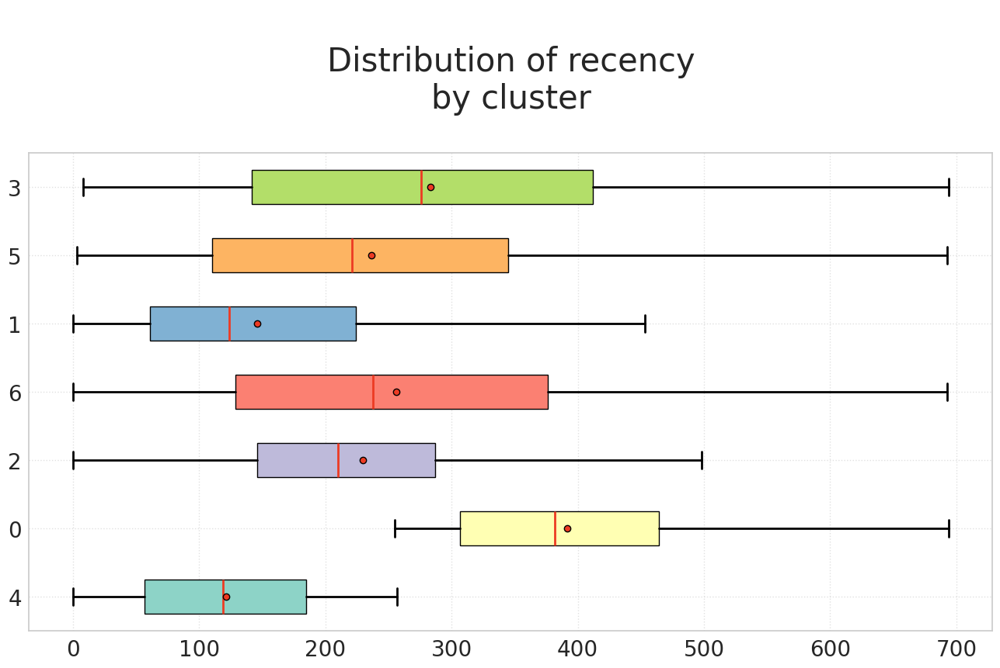

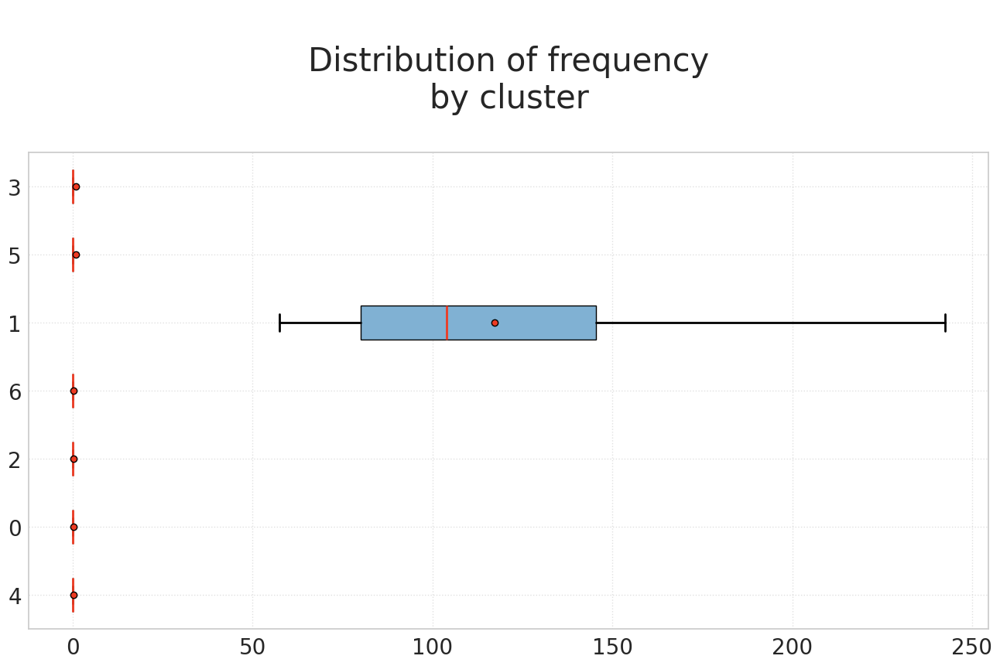

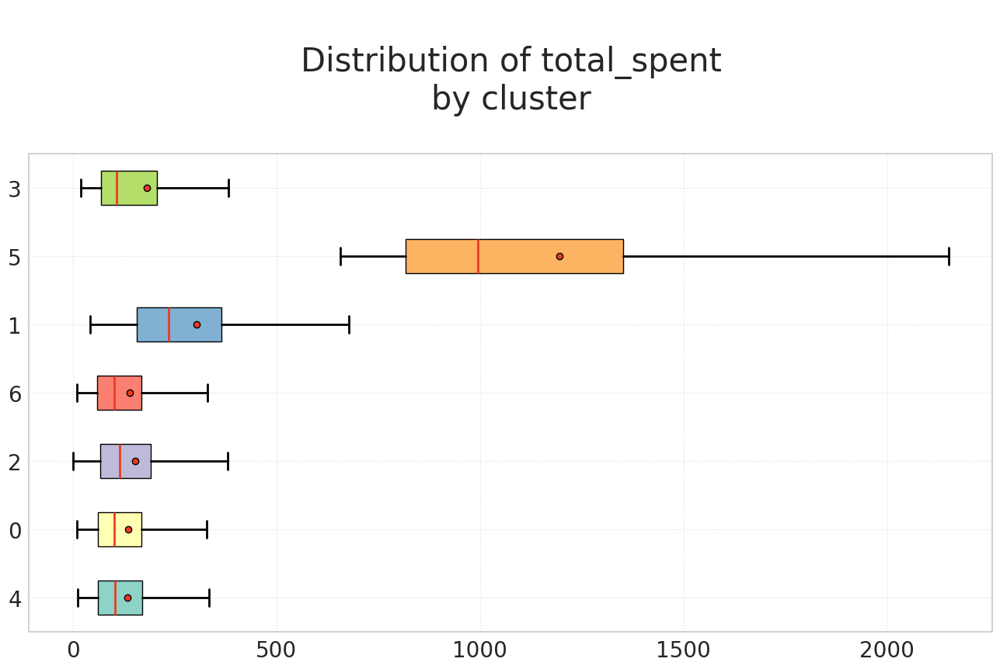

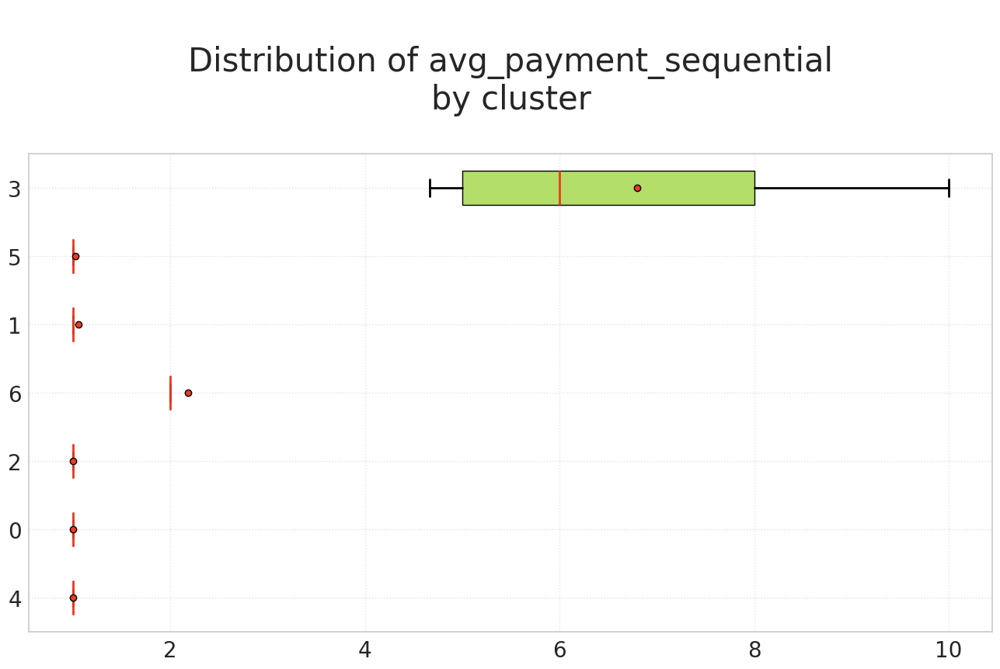

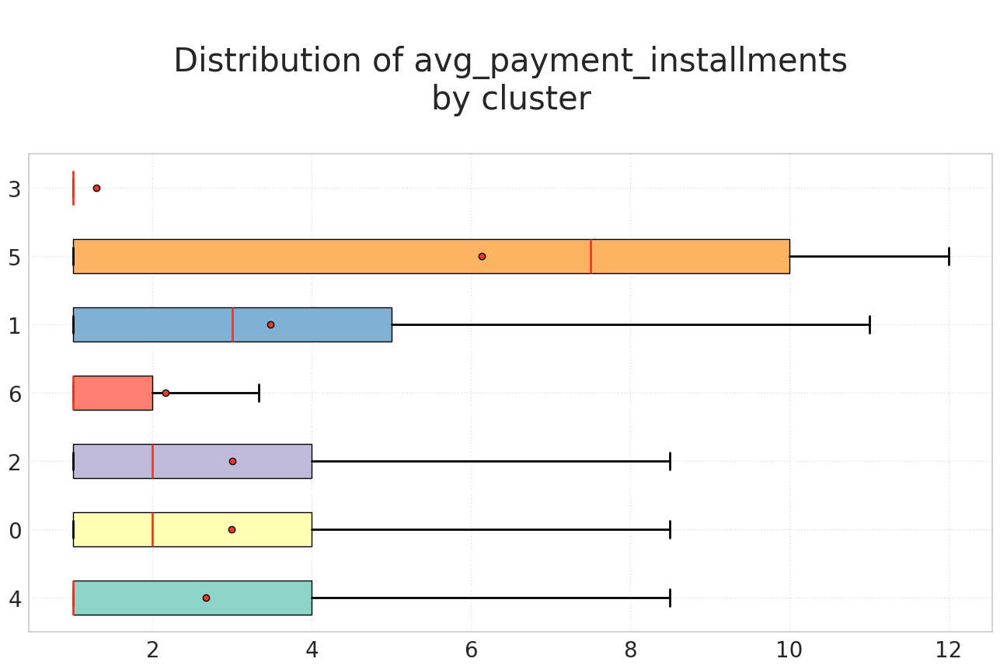

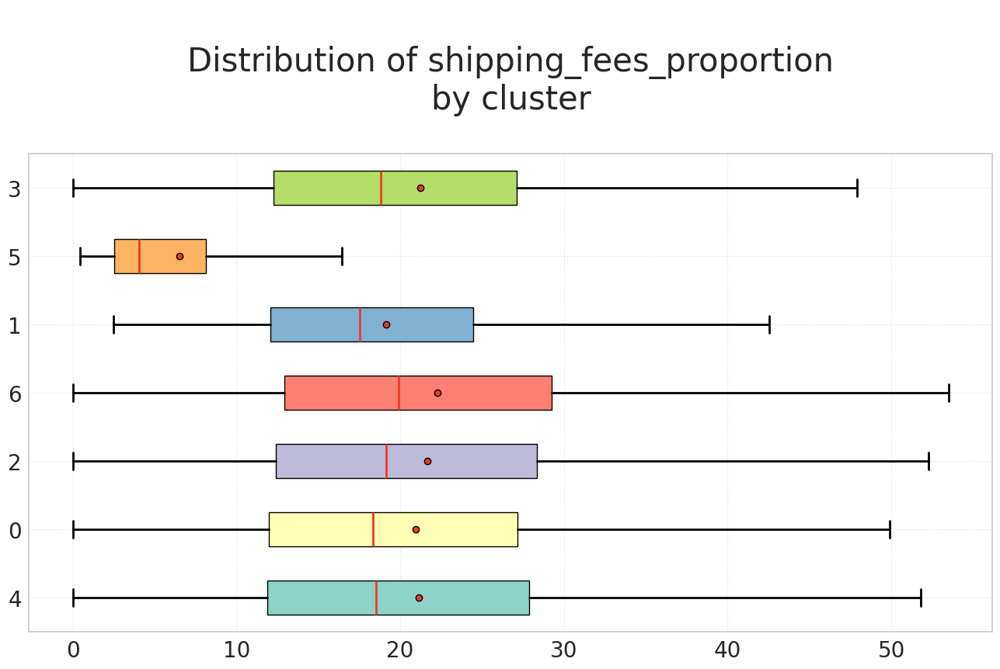

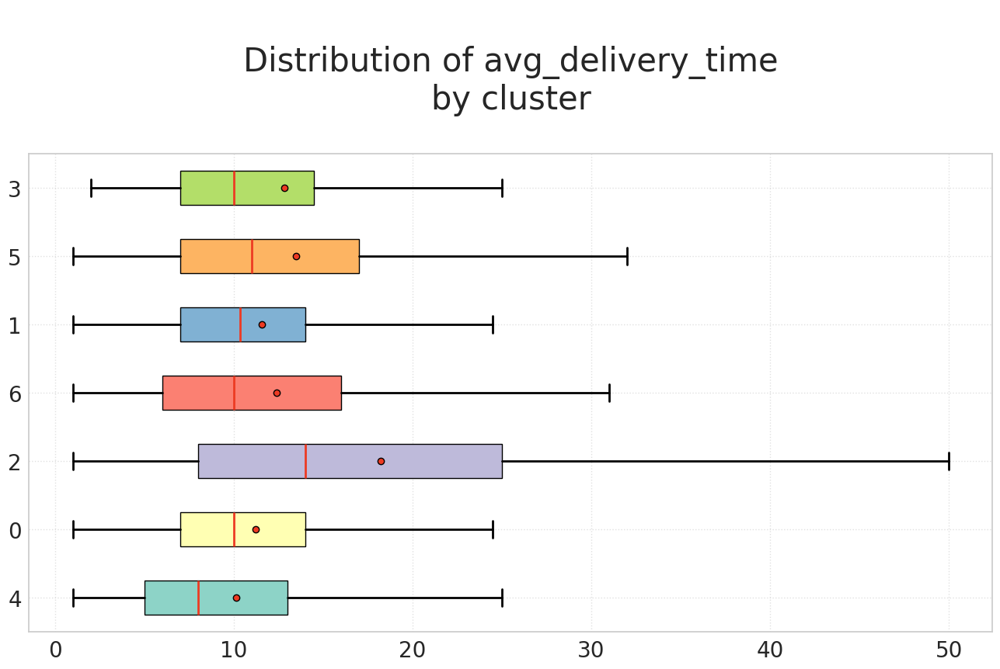

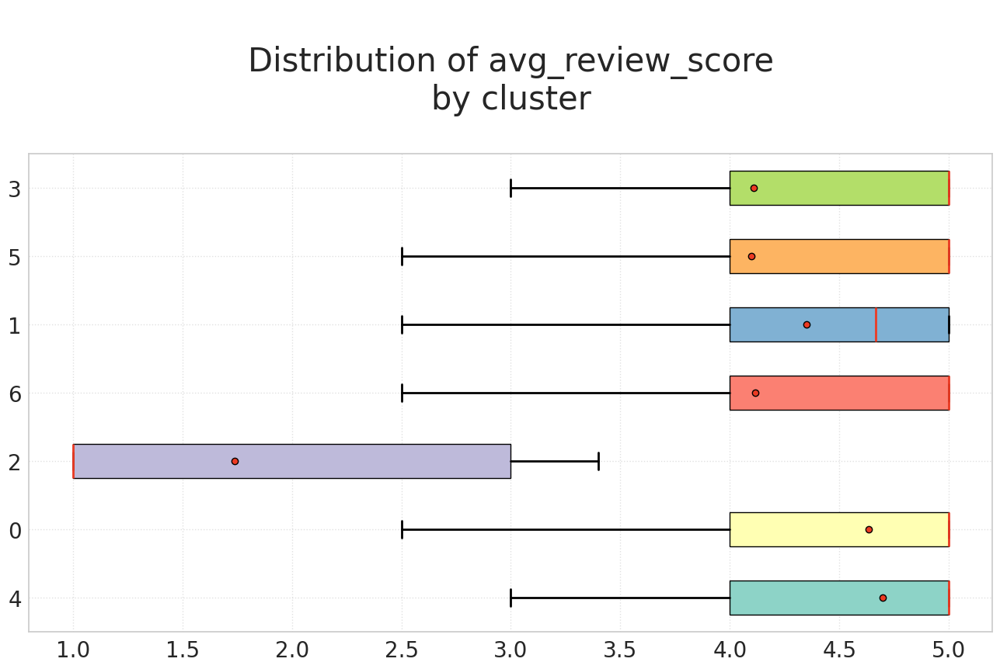

In [ ]:
# I remove variables that are identical for each cluster and those that are redundant or too similar to use as a means of comparison.
a_del = [variable for variable in data.columns if variable not in features_list]
a_del.remove('Cluster_KMeans')
a_del.remove('avg_payment_installments')
a_del.remove('shipping_fees_proportion')
a_del.remove('avg_delivery_time')
print(a_del)

data_moustache = data.drop(a_del, axis=1, inplace=False)

# Graphical representation of the distribution of values according to clusters
clusters = list(data_moustache['Cluster_KMeans'].unique())

a_compare = list(data_moustache.columns)

a_compare.remove('Cluster_KMeans')

for i in a_compare:

    values_list = []
    for j in clusters:
        values_list.append(data_moustache.loc[data_moustache['Cluster_KMeans'] == j][i])

    plt.figure(figsize=(16, 8))
    plt.title(f"\nDistribution of {i}\nby cluster\n", fontsize=30)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)

    param_box_plot = {
        'patch_artist': True,
        'boxprops': dict(
            linestyle='-',
            linewidth=1,
            color='black',
            facecolor='#8181FF',
        ),
        'capprops': dict(
            color='black',
            linewidth=2,
        ),
        'flierprops': dict(
            color='#8181FF',
            markeredgecolor=None,
            markerfacecolor='#8181FF',
            markersize=5,
            marker='.',
            alpha=0.1,
        ),
        'medianprops': dict(
            linestyle='-',
            linewidth=2,
            color='#ED3B23',
        ),
        'meanprops': dict(
            marker='o',
            markeredgecolor='black',
            markeredgewidth=1,
            markerfacecolor='#ED3B23',
        ),
        'whiskerprops': dict(
            color='black',
            linewidth=2,
        )
    }

    box = plt.boxplot(
        values_list,
        vert=False,
        tick_labels=clusters,
        showmeans=True,
        showfliers=False,
        **param_box_plot,
    )

    # Specific color for each box :
    colors = sns.color_palette("Set3", 10)
    for patch, color in zip(box['boxes'], colors):
        patch.set_facecolor(color)

    plt.grid(alpha=0.8, ls=':')

    plt.show()

- Grouping individuals by cluster :

In [ ]:
# I define the first_mode() function, which I'll use for some categorical variables
def first_mode(series):
    """
    This function retains only the most frequent value in a groupby.
    If several values are equal, only the first value is returned.
    """
    modes = series.mode()
    if not modes.empty:
        return modes.iloc[0]
    else:
        return None


# I define grouping strategies for each column
strategie = {
    "customer_unique_id": "count",
    "customer_lat": "mean",
    "customer_lng": "mean",
    "orders_number": "mean",
    "first_purchase_date": "mean",
    "last_purchase_date": "mean",
    "recency": "mean",
    "frequency": "mean",
    "avg_spent": "mean",
    "total_spent": "mean",
    "preferred_payment_type": first_mode,
    "avg_payment_sequential": "mean",
    "avg_payment_installments": "mean",
    "shipping_fees_proportion": "mean",
    "avg_customer_seller_distance_km": "mean",
    "avg_delivery_time": "mean",
    "preferred_category": first_mode,
    "avg_review_score": "mean",
}

# Grouping by cluster
clusters = data.groupby('Cluster_KMeans').agg(strategie)

# Reset index to restore the Cluster_BisectingKMeans column
clusters = clusters.reset_index()

# Reconverting dates into an intelligible format (unit='s' because they are timestamps)
clusters['first_purchase_date'] = pd.to_datetime(clusters['first_purchase_date'], unit='s').dt.strftime('%Y-%m-%d')
clusters['last_purchase_date'] = pd.to_datetime(clusters['last_purchase_date'], unit='s').dt.strftime('%Y-%m-%d')

# Removing variables that are identical for each cluster and those that are redundant or too similar to use as a means of comparison.
to_del = [
    "customer_lat",
    "customer_lng",
    # "first_purchase_date",
    # "last_purchase_date",
    # "preferred_payment_type",
    "preferred_category", # all clusters have "home_kitchen_garden" as most found prefered category
]

clusters.drop(to_del, axis=1, inplace=True)

sorted_clusters = clusters.sort_values(by=['Cluster_KMeans'], ascending=True)

print('\nHighest recency:')
display(sorted_clusters.loc[sorted_clusters['recency'].idxmax(),['Cluster_KMeans','recency']])
print('\nHighest frequency:')
display(sorted_clusters.loc[sorted_clusters['frequency'].idxmax(),['Cluster_KMeans','frequency']])
print('\nHighest total_spent:')
display(sorted_clusters.loc[sorted_clusters['total_spent'].idxmax(),['Cluster_KMeans','total_spent']])

print('\nLowest recency:')
display(sorted_clusters.loc[sorted_clusters['recency'].idxmin(),['Cluster_KMeans','recency']])
print('\nLowest frequency:')
display(sorted_clusters.loc[sorted_clusters['frequency'].idxmin(),['Cluster_KMeans','frequency']])
print('\nLowest total_spent:')
display(sorted_clusters.loc[sorted_clusters['total_spent'].idxmin(),['Cluster_KMeans','total_spent']])

display(sorted_clusters)


Highest recency:


,0
Cluster_KMeans,0
recency,391.744523



Highest frequency:


,1
Cluster_KMeans,1
frequency,117.183706



Highest total_spent:


,5
Cluster_KMeans,5
total_spent,1194.062755



Lowest recency:


,4
Cluster_KMeans,4
recency,121.666675



Lowest frequency:


,2
Cluster_KMeans,2
frequency,0.22528



Lowest total_spent:


,4
Cluster_KMeans,4
total_spent,134.501212


,Cluster_KMeans,customer_unique_id,orders_number,first_purchase_date,last_purchase_date,recency,frequency,avg_spent,total_spent,preferred_payment_type,avg_payment_sequential,avg_payment_installments,shipping_fees_proportion,avg_customer_seller_distance_km,avg_delivery_time,avg_review_score
0,0,31267,1.024691,2017-08-01,2017-08-02,391.744523,0.243977,132.367820,135.131363,bank cards,1.000235,2.993182,20.926665,609.561200,11.237612,4.634991
1,1,761,2.120894,2017-08-01,2018-04-05,145.749014,117.183706,142.660640,304.341406,bank cards,1.053876,3.483990,19.139577,565.896038,11.559965,4.349615
2,2,15443,1.021434,2018-01-10,2018-01-11,229.646442,0.225280,149.635805,152.507624,bank cards,1.000410,3.006808,21.667003,654.775441,18.238482,1.738235
3,3,157,1.044586,2017-11-16,2017-11-19,283.038217,0.921444,176.405955,181.722102,voucher,6.797240,1.292994,21.234617,539.840108,12.833333,4.109789
4,4,40885,1.021915,2018-04-28,2018-04-29,121.666675,0.310157,131.920858,134.501212,bank cards,1.000308,2.666630,21.108192,560.116893,10.124012,4.699748
5,5,2265,1.095364,2018-01-01,2018-01-04,236.227373,0.924461,1154.247964,1194.062755,bank cards,1.025670,6.134946,6.511457,806.569010,13.496943,4.099037
6,6,2572,1.017496,2017-12-15,2017-12-15,256.389580,0.234578,137.103848,138.731186,bank cards,2.181117,2.159927,22.258600,645.149020,12.397291,4.115518


In [ ]:
2572/int(sorted_clusters['customer_unique_id'].sum())

0.027552222817354043

#### **Interpreting clusters**

- <span style="color: #8181FF">**Group 0 (33,5 %) :**</span> are those whose last orders are the less recent and their orders frequency is very low. They are the least loyal customers. Also, they do not spend lots of money but they are numerous. Their category presents one of the highest shipping_fees_proportion value. <span style="color: #8181FF">**Considered as "lost": try to win them back with offers such as vouchers or free shipping.**</span>

- <span style="color: #8181FF">**Group 1 (0.8%) :**</span> are ones with relatively low recency and most of all highest frequency. The total spent amount is quite low. They left overall good reviews but not the best average value. <span style="color: #8181FF">**"Loyals": we should try newsletters about mid and/or high-range products, with vouchers (amounts based on frequency) and/or communication about pros compared to lower-range products. The slightly lower reviews could be explained from the lack of quality for some ordered products which reinforces our hypothesis**</span>


- <span style="color: #8181FF">**Group 2 (16.5%) :**</span> Very low frequency, low average spent amount, average recency. The reviews are awful inside of this cluster, probably due to the significatively higher delivery time for this category. <span style="color: #8181FF">**"At-Risk Customers + angry about delivery: majority of new customers. In their newsletter, mention that we listened them and we are doing our best to reduce the delivery times and overall the shipping process. Reward their last buy with vouchers on new low-range articles in order to build loyalty so they can get into the "Loyals" category**</span>

- <span style="color: #8181FF">**Group 3 (0.2%) :**</span> Relatively low frequency, low amount, second best spenders. They almost systematically process one-time payment and are used to collect coupons/vouchers<span style="color: #8181FF">**"To be reactivated" with suggestions for high-range products and some mid-range ones. Propose vouchers. These customers probably belong to upper class and could raise up to "Champions"**</span>

- <span style="color: #8181FF">**Group 4 (43.8%) :**</span> The biggest cluster. Very similiar to the cluster 0 (low frequency, low spent amount) BUT with lowest recency value and most recent first_purchase_date value. They have the most elogious reviews so they can become good loyals. They don't use the vouchers. <span style="color: #8181FF">**"At-Risk Customers: majority of new customers. Reward their last buy with vouchers on new low-range articles in order to build loyalty so they can get into the "Loyals" category. Also propose vouchers to motivate them buying.**</span>

- <span style="color: #8181FF">**Group 5 (2.4%) :**</span> They are the most spending persons with a low frequency and an average recency. They almost have highest delivery time and overall good but lower reviews. <span style="color: #8181FF">**"To be reactivated" with suggestions for high-range products and some mid-range ones. Propose vouchers. In their newsletter, mention that we listened them and we are doing our best to reduce the delivery times and overall the shipping process. These customers probably belong to upper class and could raise up to "Champions"**</span>

- <span style="color: #8181FF">**Group 6 (2.8%) :**</span>Quite similiar to group 2 (recency, frequency, spent amount), but their reviews are overall better. They almost systematically process one-time payment. <span style="color: #8181FF">**At-risk customers : with suggestions for high-range products and some mid-range ones. Propose vouchers.**</span>




Since almost all customers are paying a lot of shipping costs (except cluster 5 which probably benefits from reduced shipping costs over a certain order amount), proposing vouchers for reduced shipping costs for groupped orders would be an idea.

## Notebook runtime (excluding imports)

- Notebook runtime display :

In [ ]:
temps_secondes = time.time() - t_notebook

# Conversion to minutes and seconds
minutes = int(temps_secondes // 60)
seconds = int(temps_secondes % 60)

# Output formatting
formatted_time = f"{minutes:02}:{seconds:02}"

print(f"Notebook runtime (excluding imports) : {formatted_time}")

Notebook runtime (excluding imports) : 94:18
